# GUC NETW 1003 Kmeans Assginmnet

Objective: exercise is to learn how to use build and use  kmeans clustering algortrithm    

At the end of this lab you will be able to
> 1. Build and run a K-means algorithm.
> 2. Know how to evalute K-means Algorithm
> 2. Understand the effect of the parmeters ont he perfromance of the algorithm .
> 3. Understand the effect of distance.

## 1. Wirte K means function

import required libraries

In [89]:
import numpy as np, pandas as pd, seaborn as sns, matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from sklearn.datasets import make_moons

> ### 1.1. Code for the distance function

write a function to calculate the distance between a set of cluster centroids and all the data points

Cluster_Distances = GUC_Distance ( Cluster_Centroids, Data_points, Distance_Type)
* The function shoud be able to handel data points with any number of features and any number of points
* The function should be able to handle any K number of cluster centroids
* To inrease speed do that in matrix format using numpy
* This should produce a matrix with rows equal to data points columns equal K
* You should be able to calculate different types of Distance. In this assginmnet you are required to implement the following two
    - Ecluidian distance
    - Pearson correlation distance
  

In [90]:
#Cluster_Distance: numpy array of shape (num_points, K), containing distances between each data point and each cluster centroid.

def euclidean_distance(point1, point2):
    return np.sqrt(np.sum((point1 - point2)**2))

def pearson_correlation_distance(data_array, centroid,mean_points,mean_centroid,new_points):    
    new_centroid = centroid - mean_centroid
    num = np.sum(new_points * new_centroid, axis=1)
    den = (np.sqrt(np.sum(new_points ** 2, axis=1))) * (np.sqrt(np.sum(new_centroid ** 2)))
    return 1 - (num / den)

def GUC_Distance ( Cluster_Centroids, Data_points, Distance_Type ):
    data_array = Data_points.to_numpy()  # Convert DataFrame to numpy array
    num_clusters = Cluster_Centroids.shape[0]
    num_data_points = Data_points.shape[0]
    mean_points = np.mean(Data_points, axis=0)
    mean_centroid = np.mean(Cluster_Centroids, axis=0)
    new_points = Data_points - mean_points
    distances = np.zeros((num_data_points, num_clusters))
    for i in range(num_clusters):
        centroid = Cluster_Centroids.iloc[i, :].values
        if Distance_Type == 'euclidean':
            distances[:, i] = np.apply_along_axis(lambda x: euclidean_distance(x, centroid), axis=1, arr=data_array)
        elif Distance_Type == 'pearson':
            distances[:, i] = pearson_correlation_distance(data_array, centroid,mean_points,mean_centroid,new_points)

    return distances




In [85]:

#Testingggggggg
Cluster_Centroids = pd.DataFrame({'Sex': [0, 1], 'Marital status': [0, 1], 'Age': [25, 50], 'Education': [0.5, 1.5],
                                  'Income': [15000, 30000], 'Occupation': [0, 1], 'Settlement size': [0.5, 1.5] })

print("Euclidean Distance")

print(GUC_Distance(Cluster_Centroids,Customer_df,"euclidean"))
print("Peasron Distance")

print(GUC_Distance(Cluster_Centroids,Customer_df,"pearson"))

Euclidean Distance
[[109670.00806738  94670.00153956]
 [135773.0000534  120773.00324783]
 [ 74210.00388425  59210.00005489]
 ...
 [ 71400.0002556   56400.00326684]
 [ 82968.00002109  67968.00499868]
 [ 53416.00000468  38416.00823225]]
Peasron Distance
[[1.99997746e+00 2.25446044e-05]
 [1.99999772e+00 2.28193484e-06]
 [2.16782724e-06 1.99999783e+00]
 ...
 [1.16762637e-06 1.99999883e+00]
 [6.70814812e-07 1.99999933e+00]
 [1.07149254e-06 1.99999893e+00]]


> ### 1.2. Code for K means function

> Loop until a stopping condition

> > in the loop do the following
> > 1. Cluster Assginmnet
> > > * Use the GUC_Distance to calculate between each cluster head and all the points
> > > * Find the value and index of the minimum distance  for each row.
> > > * for each point in the row use the index of the minmum distance to represent the cluster Centroid that this point will belong to.
> > > * Calculate and record the mean square distance for each cluster  
> > > * Use the mean square distances to calculate a stopping condition (e.g the sum of mean distances)
> > 2. Updtate Centroids  
> > > * Update the value for the cluster heads by calculating the mean value for the points in each cluster
> > >  * Calculate the Cluster Metric (Distortion Function)
> > > > a number indicating the how good the clusters are . An example cluster metric is the  (sum of squared error between each point and its cluster center)

In [99]:
def initialize_cluster_heads(data, k):
    cluster_heads = {}
    for col in data.columns:
        data_range = data[col].max() - data[col].min()
        cluster_heads[col] = np.random.uniform(low=data[col].min(), high=data[col].max(), size=k)
    return pd.DataFrame(cluster_heads)


def GUC_Kmean ( Data_points, Number_of_Clusters,  Distance_Type ):
    tolerance=0.001
    km=[]
       # Step 1: Initialize cluster heads
    #cluster_heads = initialize_cluster_heads(Data_points, Number_of_Clusters)
    data_ranges = np.ptp(Data_points.values, axis=0)
    cluster_heads_df = np.random.rand(Number_of_Clusters, Data_points.shape[1]) * data_ranges
    cluster_heads = pd.DataFrame(cluster_heads_df, columns=Data_points.columns)
    
    
    previous_distortion_function = float('inf')
    thres_prev = np.inf
    Cluster_Metric=0
    mean_square_distances = np.zeros(Number_of_Clusters)
    while True:
        # Step 2: Cluster Assignment
        Final_Cluster_Distance = GUC_Distance(cluster_heads, Data_points, Distance_Type)
        cluster_assignments = np.argmin(Final_Cluster_Distance, axis=1)
        thres = 0
        mean_square_distances = np.zeros(Number_of_Clusters)
       # Step 3: Calculate Mean Square Distance for each cluster
        for i in range(Number_of_Clusters):
            cluster_points = Data_points.iloc[cluster_assignments == i]
            squared_distances = np.sum((cluster_points - cluster_heads.iloc[i, :]) ** 2, axis=1)
            mean_square_distances[i] = np.nanmean(squared_distances)  # Calculate mean while ignoring NaN values
            mean_square_distances = np.nan_to_num(mean_square_distances, nan=0.0)  # Replace NaN values with zero
            thres += np.sum((cluster_points - cluster_heads.iloc[i, :])**2)

        #print("mean_square_distances",mean_square_distances)
        

        # Step 4: Stopping condition : # if the sum of mean square distances are close or smaller than the tolarnce
        if np.sum(mean_square_distances) < tolerance or np.allclose(mean_square_distances, previous_distortion_function):
            break
        eps = 0.0001
        if (abs(thres - thres_prev) < eps).any():
            break
        thres_prev = thres

        previous_distortion_function=mean_square_distances.copy()
        
        #print("Sum_of_mean_square_dis",sum(mean_square_distances))   
        
        
          # Step 3: Update centroids
        for i in range(Number_of_Clusters):
            cluster_points = Data_points.iloc[cluster_assignments == i]  # Use iloc here to select rows
            if len(cluster_points) > 0:
                cluster_heads.iloc[i, :] = np.mean(cluster_points, axis=0)
        
        
    # Step 6: Calculate Cluster Metric (Distortion Function)
        km.append((cluster_assignments,cluster_heads))
    
    #Cluster_Metric = sum(mean_square_distances)
    Cluster_Metric += sum(thres)
    #print("Clusrer_Metric",Cluster_Metric)
    display_cluster(Data_points,km,Number_of_Clusters)
    return [ Final_Cluster_Distance , Cluster_Metric ]


#print("K_Means")
#GUC_Kmean(Customer_df,3,"euclidean")




## 2. Display Results

* below is a an example fuction that displayes Clusters in 2D

* You need to change the function so that is can display an n dimension data in the form of pairs of subplot 2D figures

* The function is a helper function that is originaly be found in
https://www.coursera.org/learn/ibm-unsupervised-learning/


In [ ]:
import numpy as np, pandas as pd, seaborn as sns, matplotlib.pyplot as plt

> #### 2.1. helper Display function

In [124]:
def display_cluster(X, km, num_clusters):
    color = ['b', 'r', 'g', 'c', 'm', 'y', 'k', 'Turquoise', 'LimeGreen', 'pink']  # List colors
    alpha = 0.5  # color opaque
    s = 100

    if num_clusters == 0 or not km:
        plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=color[0], alpha=alpha, s=s)
    else:
        num_columns = X.shape[1]
        fig, ax = plt.subplots(num_columns, num_columns, figsize=(30, 30))
        for i in range(min(num_clusters, len(km))):
            cluster_assignments, cluster_centers = km[i]
            arr = X.to_numpy() 
            for m in range(num_columns):
                for n in range(num_columns):
                    indices = arr[cluster_assignments == i]
                    ax[m, n].scatter(arr[cluster_assignments == i, m], arr[cluster_assignments == i, n], c=color[i], alpha=alpha, marker='o', s=s)
                    ax[m, n].scatter(cluster_centers.iloc[i, m], cluster_centers.iloc[i, n], c=color[i], marker='x', s=200)
                   
        plt.show()

In [125]:
def plotting_Examples(example_data,distance_type):
    
    example_data = pd.DataFrame(example_data, columns=['X', 'Y'])
    Num_of_clusters=[]
    cluster_Performance_mertic=[]
    for i in range(2,11):
        clusters=i
        print("Graphs_For_Cluster=",i)
        [Final_Cluster_Distance , Cluster_Metric ] = GUC_Kmean(example_data,i,distance_type)
        cluster_Performance_mertic.append(Cluster_Metric)
        Num_of_clusters.append(clusters)
        print("cluster_Performance",cluster_Performance_mertic)
        
    plt.plot(Num_of_clusters,cluster_Performance_mertic, marker='o',linestyle='-')
    plt.xlabel('Number of Clusters')
    plt.ylabel('Performance Metric')
    plt.title('Cluster Performance Metric vs Number of Clusters')
    plt.show()    

> #### 2.2. Example 1 : Circular Data Gen and display

* below is an example of how to use the funciton
  *  prepare the figure size and background
   > * this part can be replaced by a number of subplots
  
  * Produce a data set that represent the x and y o coordinates of a circle
   > * this part can be replaced by data that you import froma file
  
  * Data is displayed
   > * to display the data only it is assumed that the number of clusters is zero which is the default of the fuction

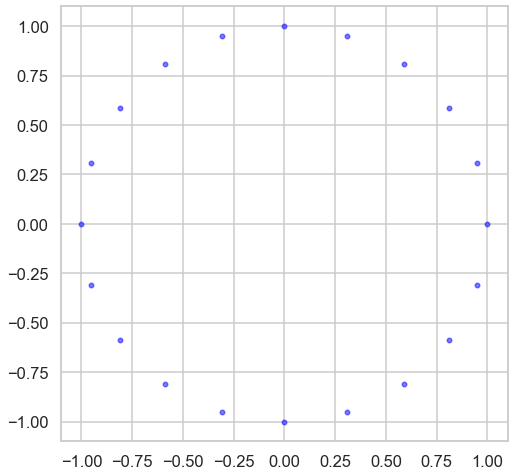

In [ ]:
# prepare the figure sise and background
# this part can be replaced by a number of subplots
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")
# Produce a data set that represent the x and y o coordinates of a circle
# this part can be replaced by data that you import froma file
angle = np.linspace(0,2*np.pi,20, endpoint = False)
X = np.append([np.cos(angle)],[np.sin(angle)],0).transpose()
# Data is displayed
# to display the data only it is assumed that the number of clusters is zero which is the default of the fuction
display_cluster(X)

> #### 2.3. Example 2 : Multi blob Data Gen and display

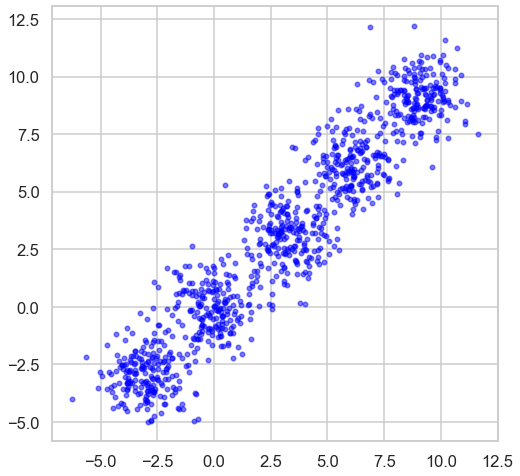

In [ ]:
n_samples = 1000
n_bins = 4
centers = [(-3, -3), (0, 0), (3, 3), (6, 6), (9,9)]
X, y = make_blobs(n_samples=n_samples, n_features=2, cluster_std=1.0,
                  centers=centers, shuffle=False, random_state=42)
display_cluster(X)

#### 2.3. Example 3 : moons Data Gen and display

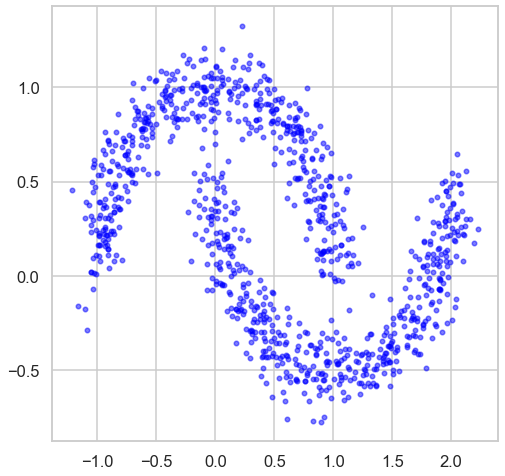

In [ ]:
n_samples = 1000
X, y = noisy_moons = make_moons(n_samples=n_samples, noise= .1)
display_cluster(X)

## 3. Testing the GUC_Kmean function on Simple 2D
1. Apply the GUC_Kmean fucntion to 2D Data provided by example 1, Example 2 and Example 3
2. Try a varing number of cluster centriods that range from 2 to 10 clusters on each set
3. Display your results.
4. plot the Cluster perfromance Metric versus the number of clusters
4. Change the distance function and repeat the above steps

Graphs_For_Cluster= 2


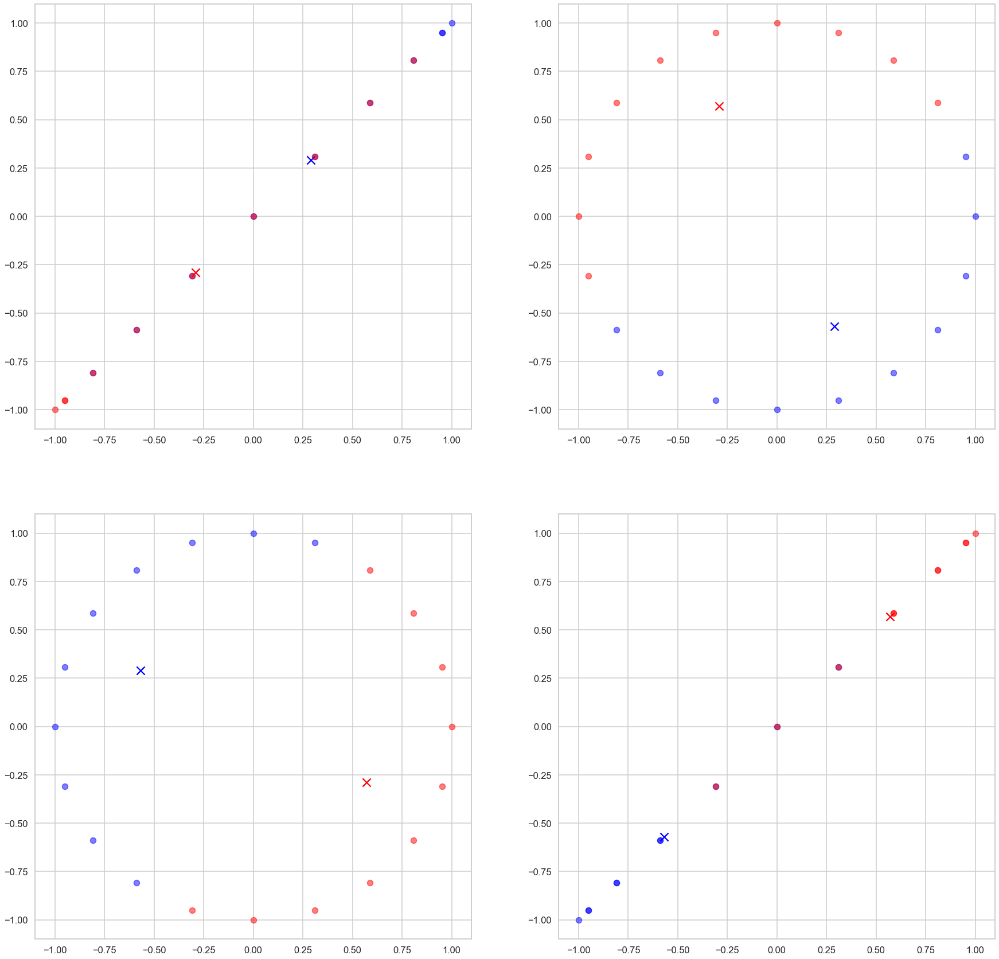

cluster_Performance [11.827308362187718]
Graphs_For_Cluster= 3


C:\Users\Darin\AppData\Local\Temp/ipykernel_3684/1651446491.py:31: RuntimeWarning: Mean of empty slice
  mean_square_distances[i] = np.nanmean(squared_distances)  # Calculate mean while ignoring NaN values


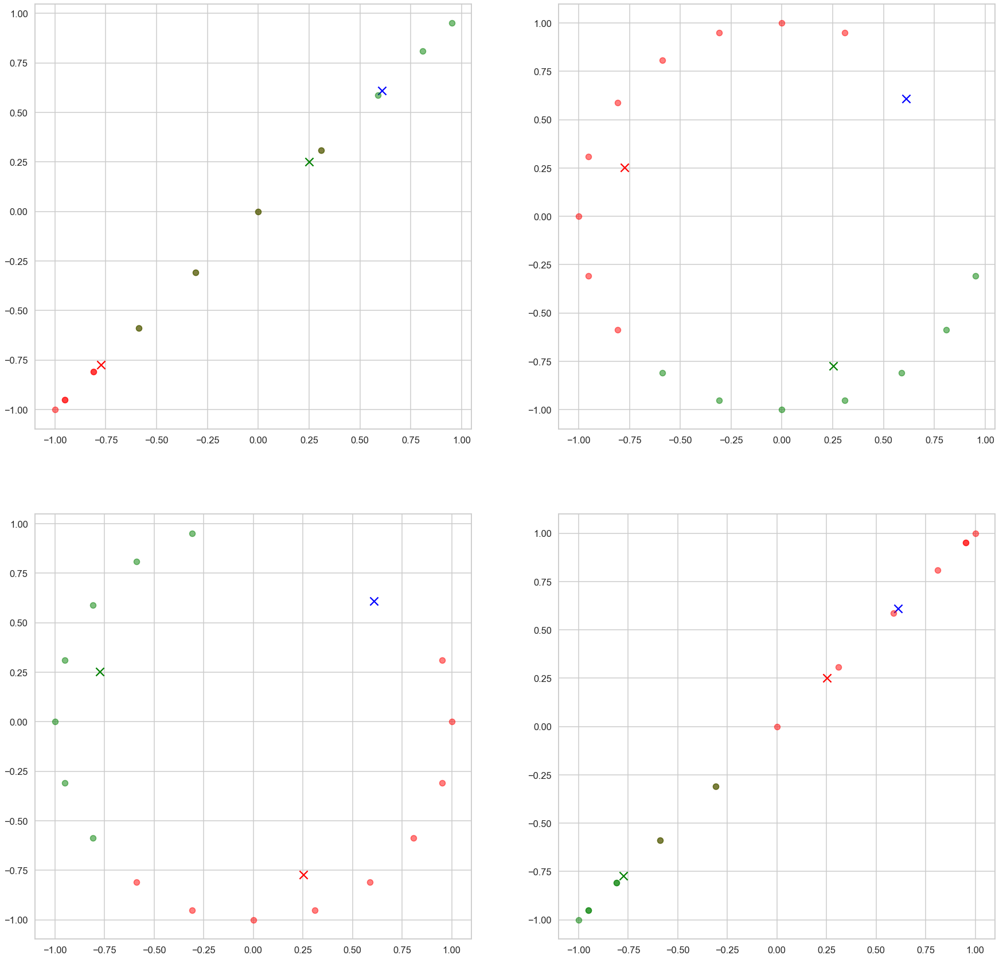

cluster_Performance [11.827308362187718, 6.273506145571169]
Graphs_For_Cluster= 4


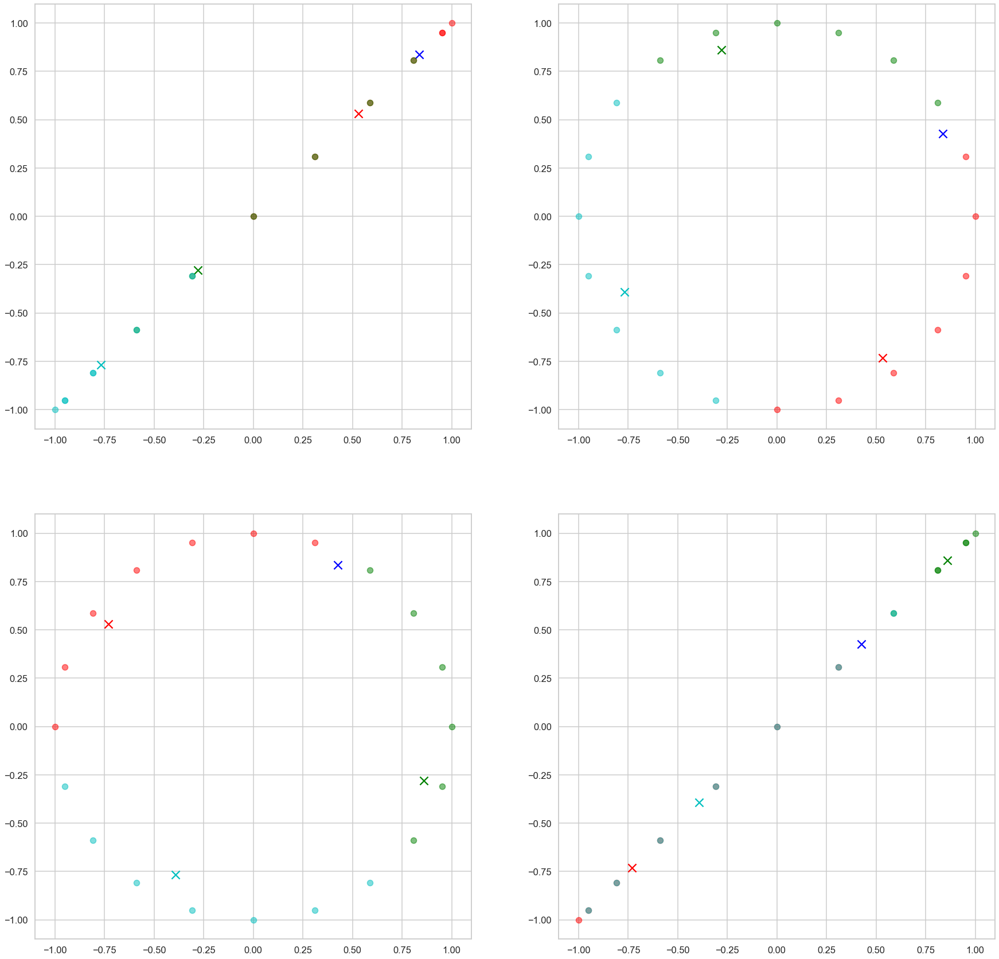

cluster_Performance [11.827308362187718, 6.273506145571169, 3.8402338656895143]
Graphs_For_Cluster= 5


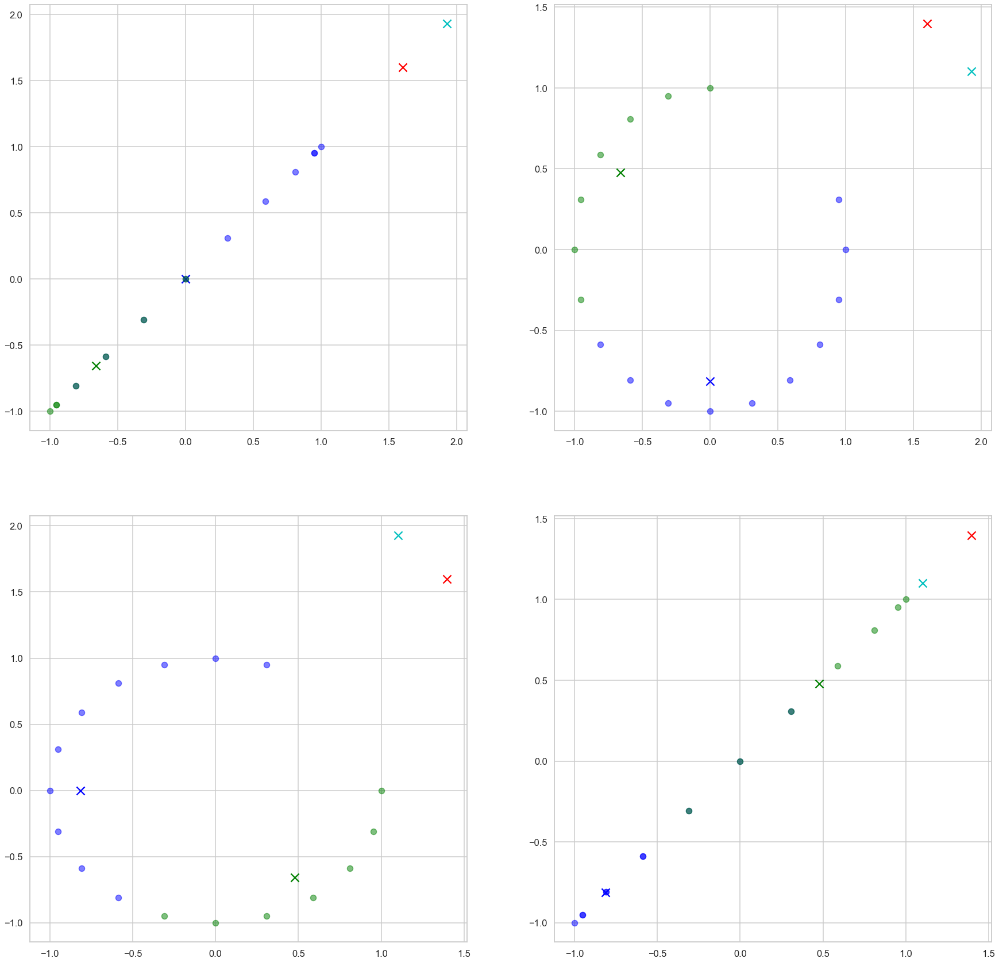

cluster_Performance [11.827308362187718, 6.273506145571169, 3.8402338656895143, 6.273506145571169]
Graphs_For_Cluster= 6


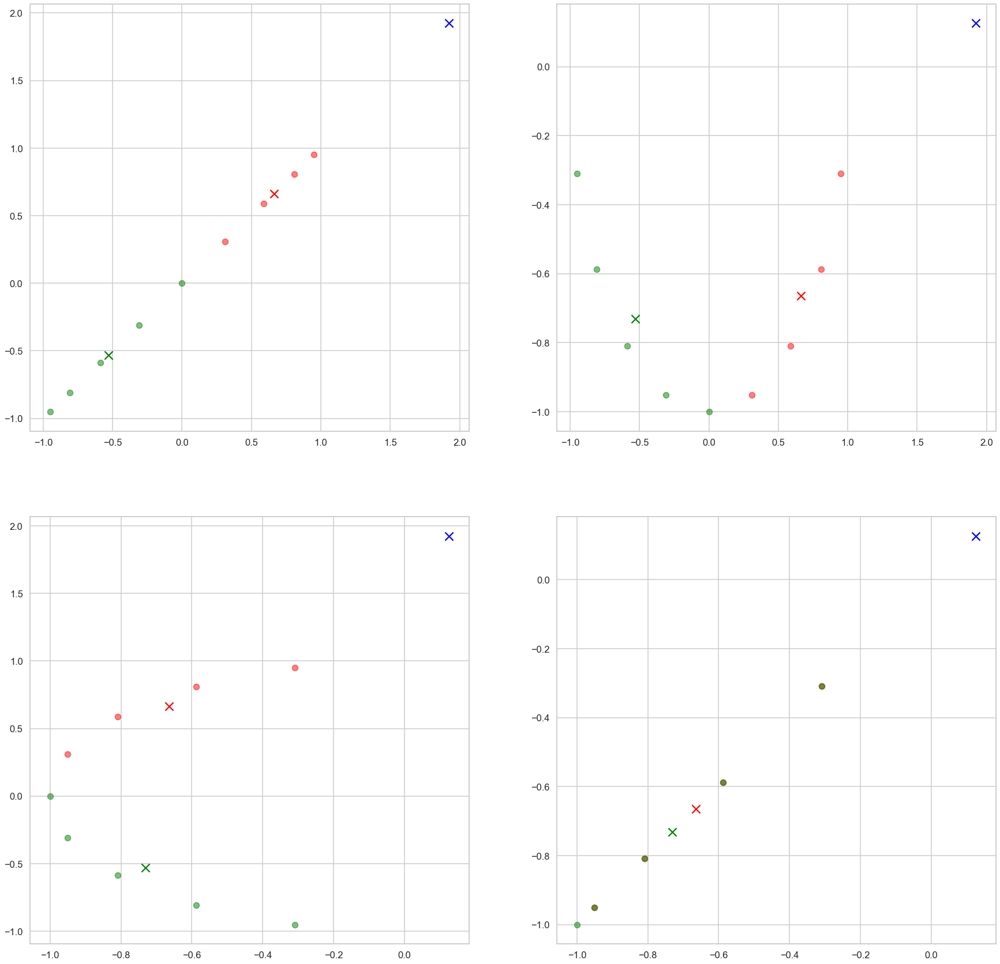

cluster_Performance [11.827308362187718, 6.273506145571169, 3.8402338656895143, 6.273506145571169, 3.8402338656895147]
Graphs_For_Cluster= 7


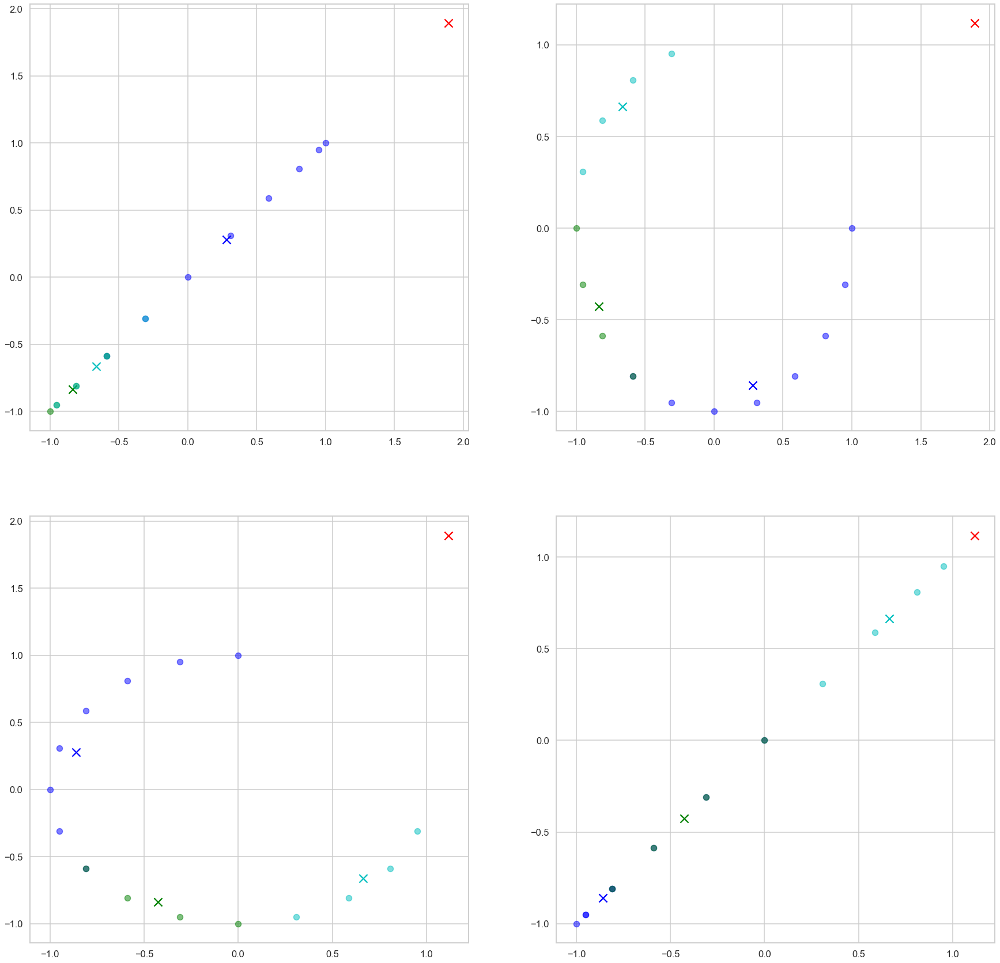

cluster_Performance [11.827308362187718, 6.273506145571169, 3.8402338656895143, 6.273506145571169, 3.8402338656895147, 2.51775097822528]
Graphs_For_Cluster= 8


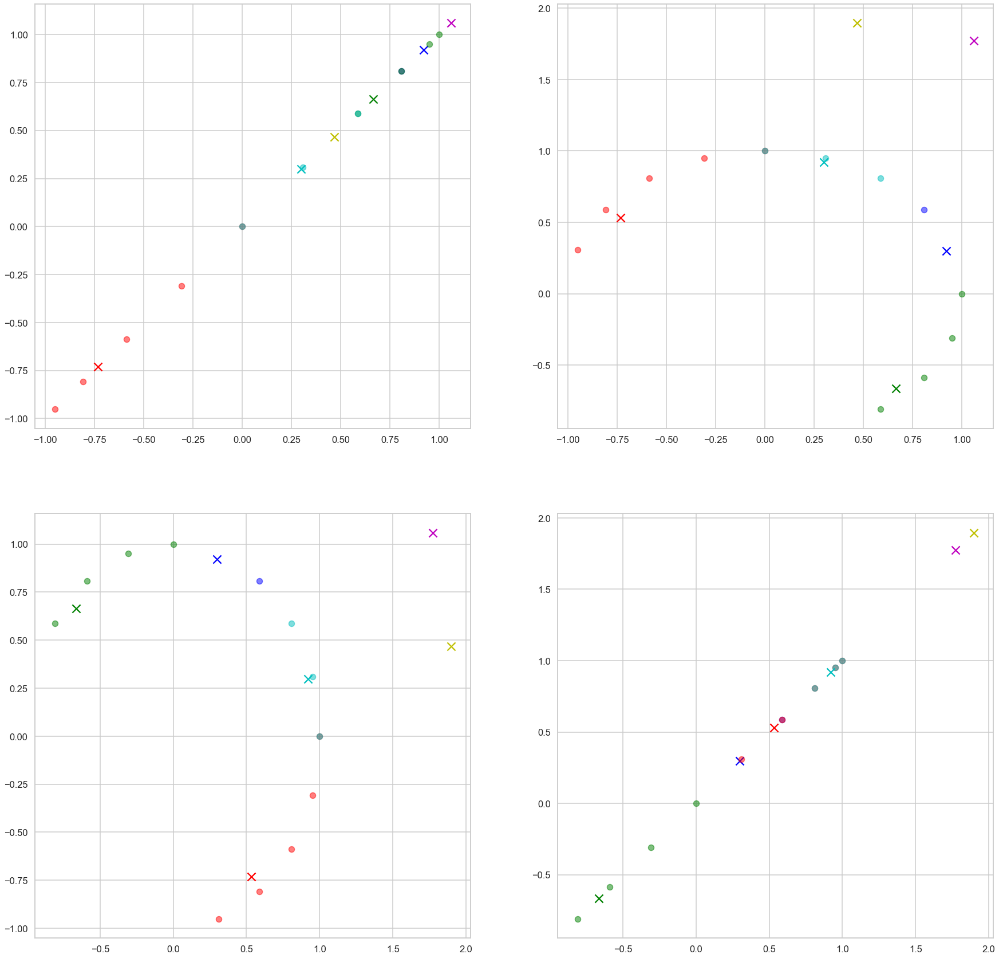

cluster_Performance [11.827308362187718, 6.273506145571169, 3.8402338656895143, 6.273506145571169, 3.8402338656895147, 2.51775097822528, 2.6829739312701326]
Graphs_For_Cluster= 9


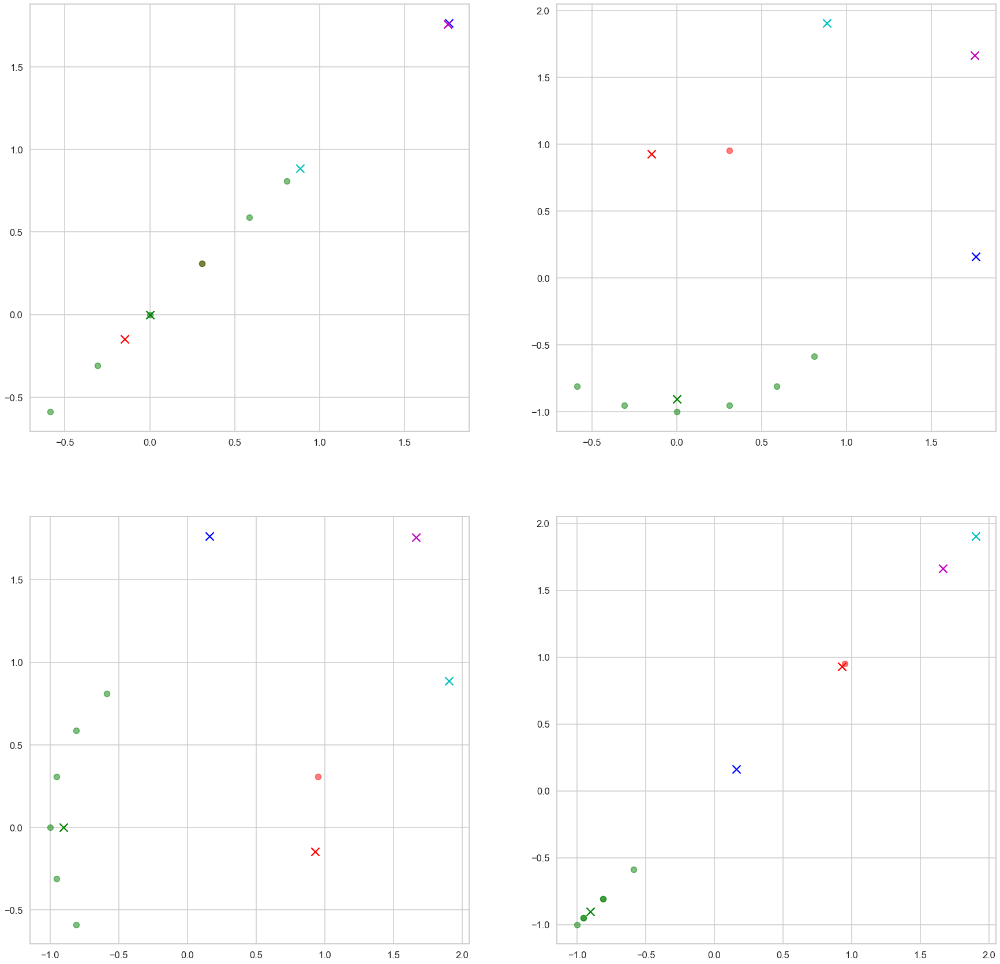

cluster_Performance [11.827308362187718, 6.273506145571169, 3.8402338656895143, 6.273506145571169, 3.8402338656895147, 2.51775097822528, 2.6829739312701326, 2.817263055964738]
Graphs_For_Cluster= 10


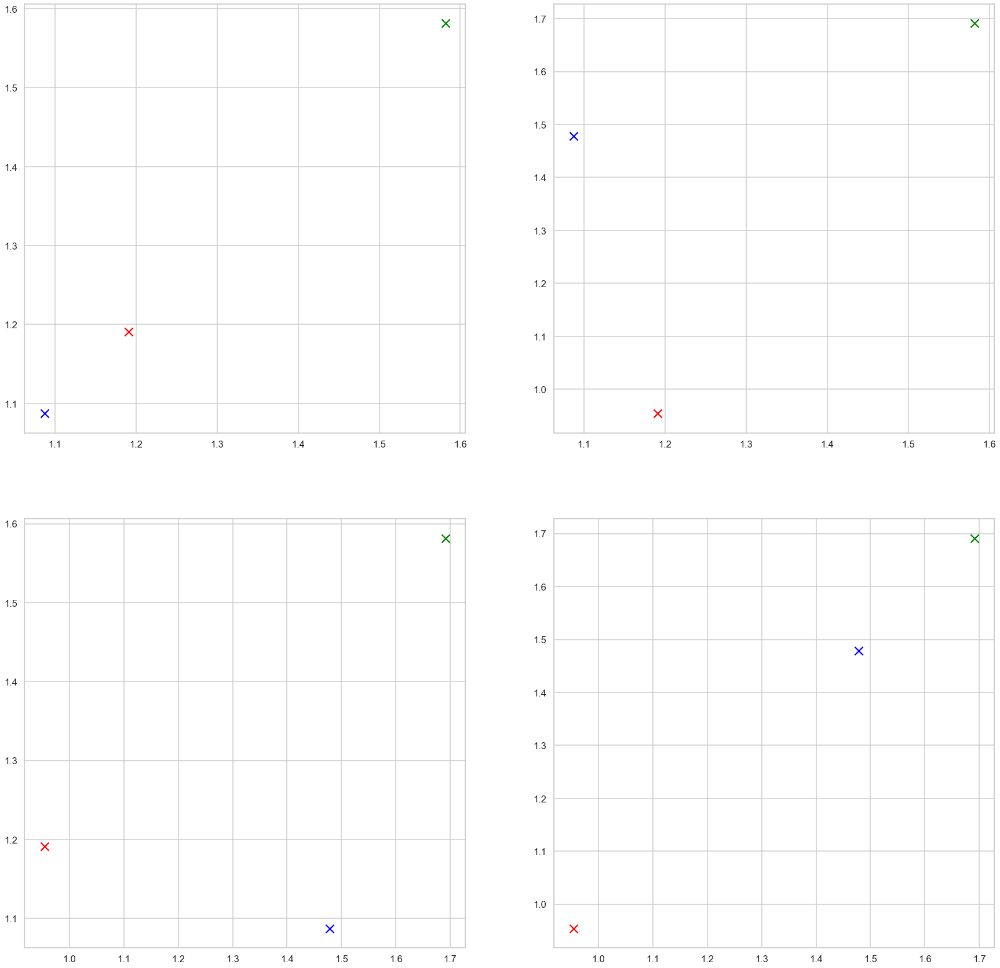

cluster_Performance [11.827308362187718, 6.273506145571169, 3.8402338656895143, 6.273506145571169, 3.8402338656895147, 2.51775097822528, 2.6829739312701326, 2.817263055964738, 4.02585100700359]


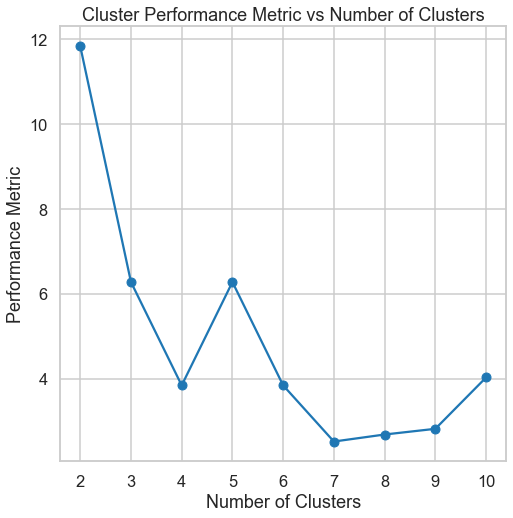

In [126]:
#Eaxmple 1_Euclidian 
# prepare the figure sise and background
# this part can be replaced by a number of subplots
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")
# Produce a data set that represent the x and y o coordinates of a circle
# this part can be replaced by data that you import froma file
angle = np.linspace(0,2*np.pi,20, endpoint = False)
X = np.append([np.cos(angle)],[np.sin(angle)],0).transpose()
# Data is displayed
# to display the data only it is assumed that the number of clusters is zero which is the default of the fuction
# display_cluster(X)
plotting_Examples(X,"euclidean")



Graphs_For_Cluster= 2


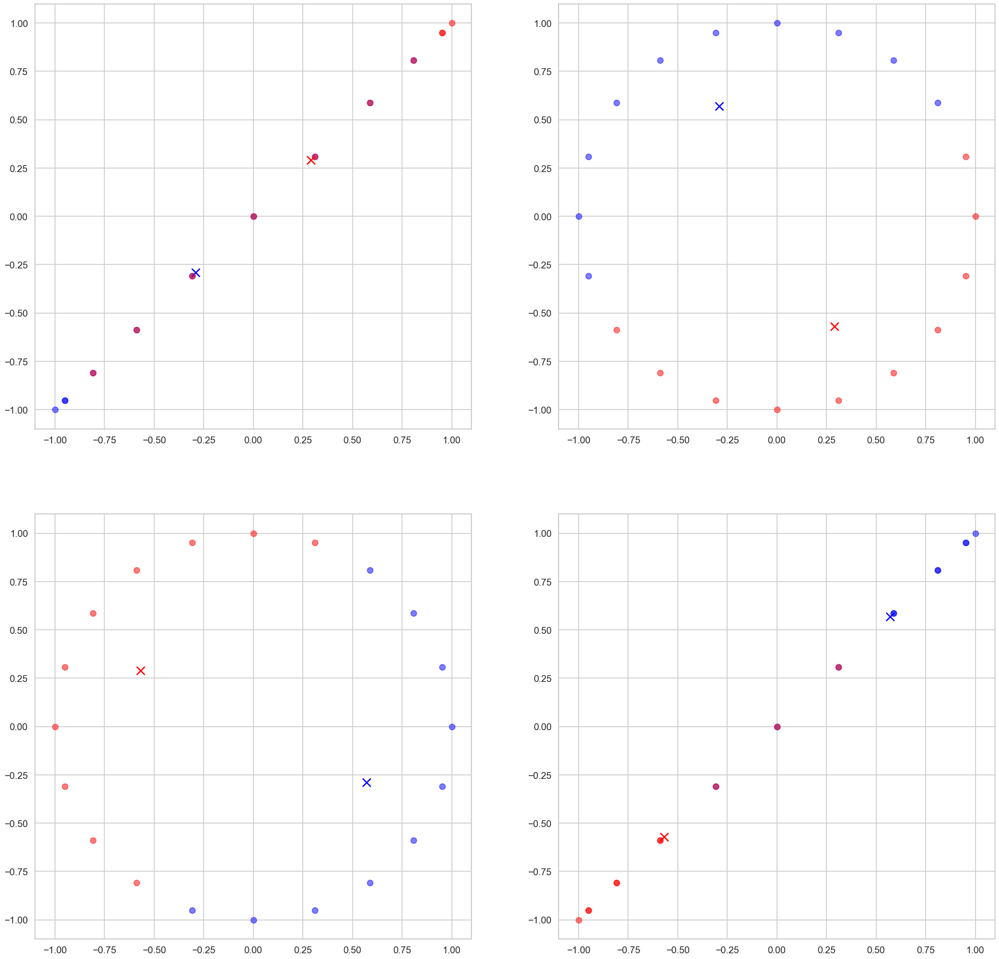

cluster_Performance [11.827308362187718]
Graphs_For_Cluster= 3


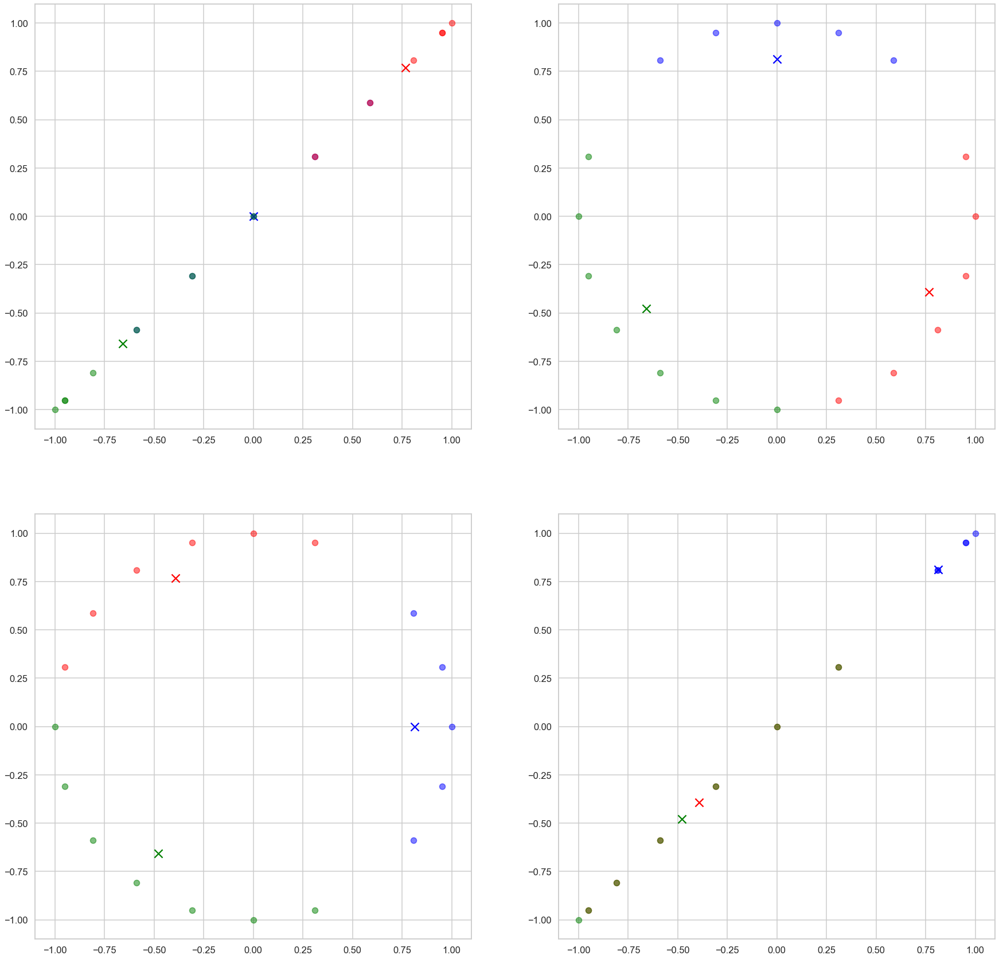

cluster_Performance [11.827308362187718, 6.27350614557117]
Graphs_For_Cluster= 4


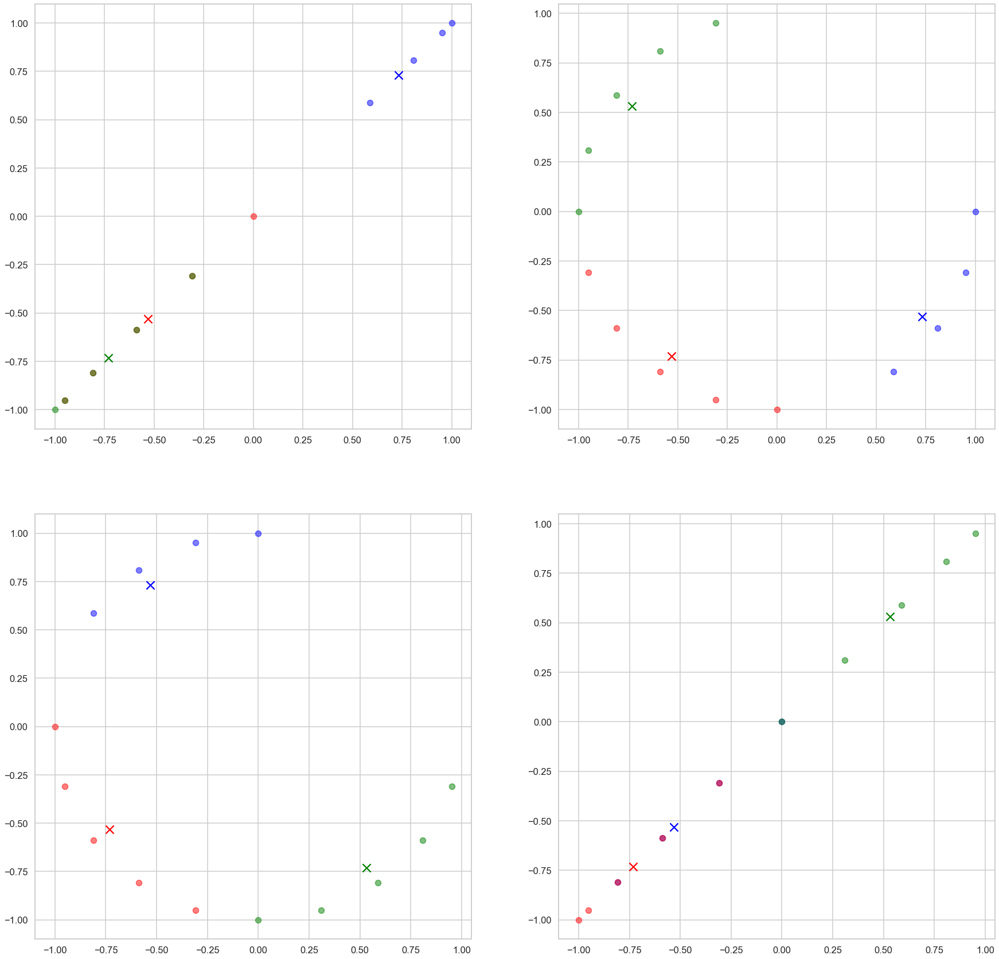

cluster_Performance [11.827308362187718, 6.27350614557117, 3.6546167243754395]
Graphs_For_Cluster= 5


C:\Users\Darin\AppData\Local\Temp/ipykernel_3684/1651446491.py:31: RuntimeWarning: Mean of empty slice
  mean_square_distances[i] = np.nanmean(squared_distances)  # Calculate mean while ignoring NaN values


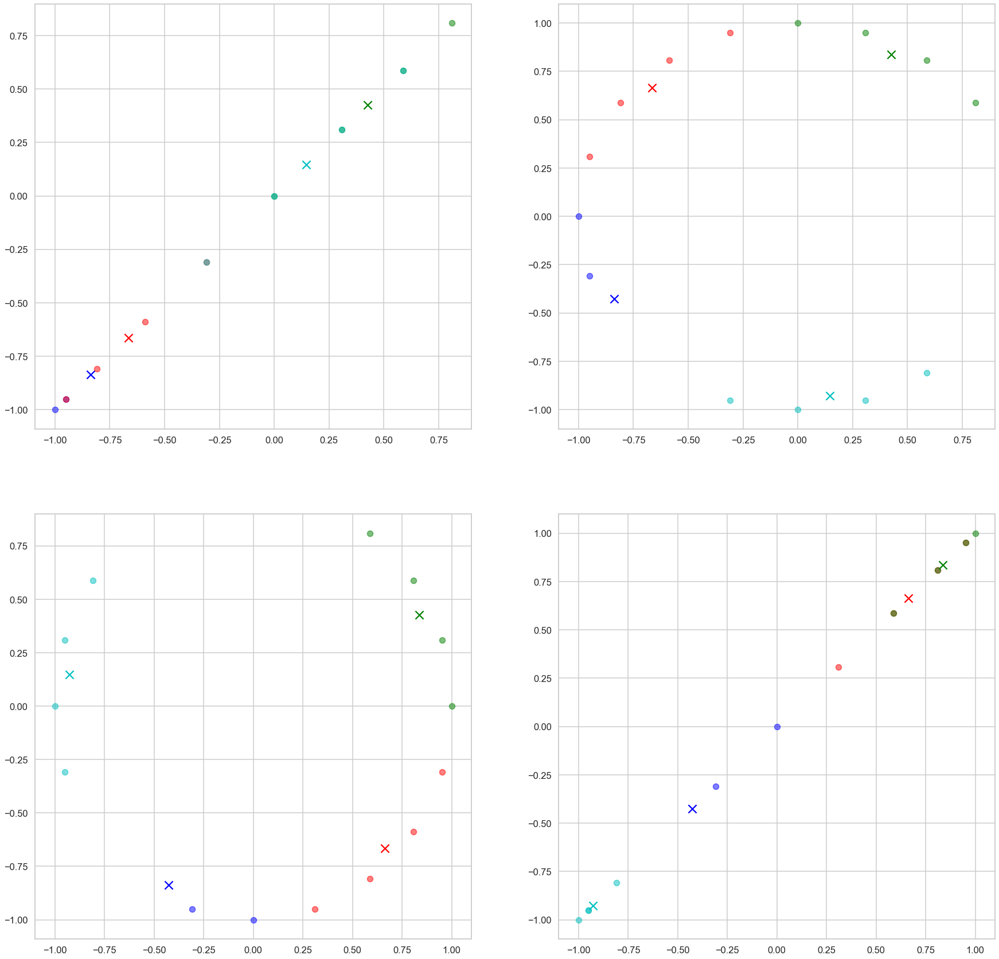

cluster_Performance [11.827308362187718, 6.27350614557117, 3.6546167243754395, 2.352528025180429]
Graphs_For_Cluster= 6


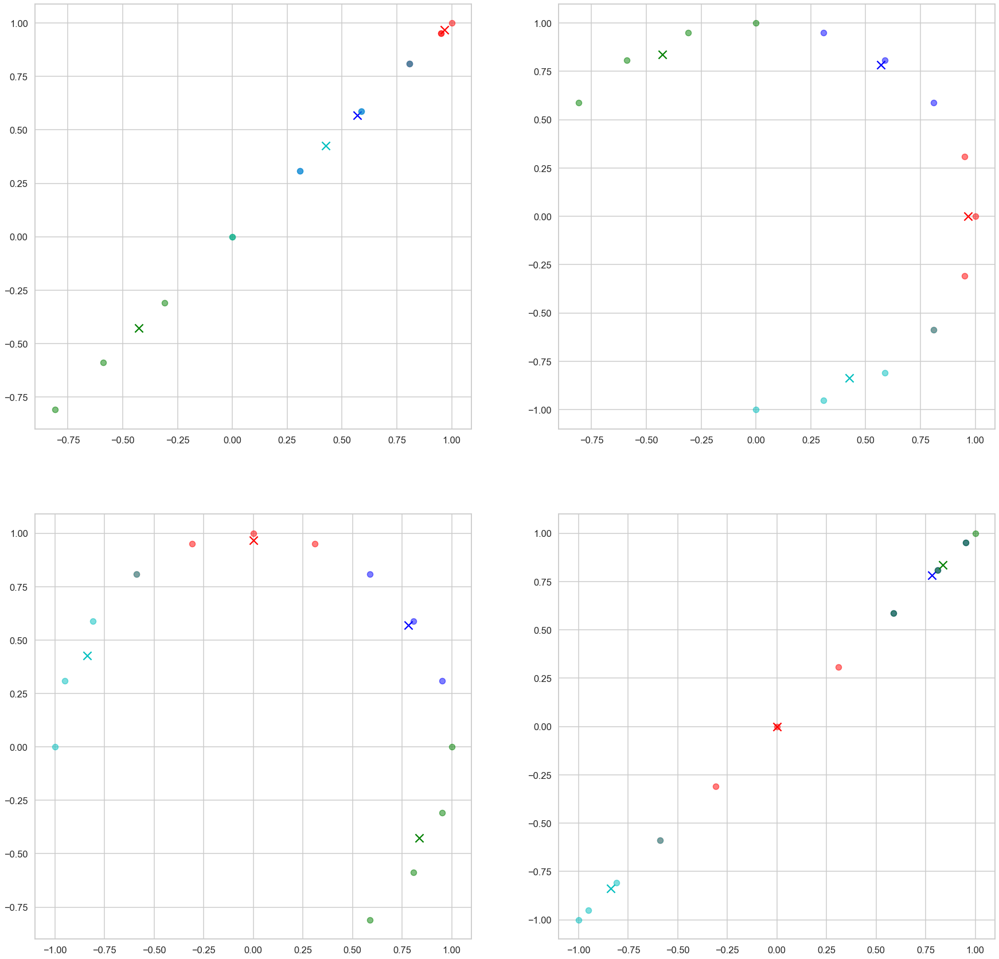

cluster_Performance [11.827308362187718, 6.27350614557117, 3.6546167243754395, 2.352528025180429, 1.7113311381648257]
Graphs_For_Cluster= 7


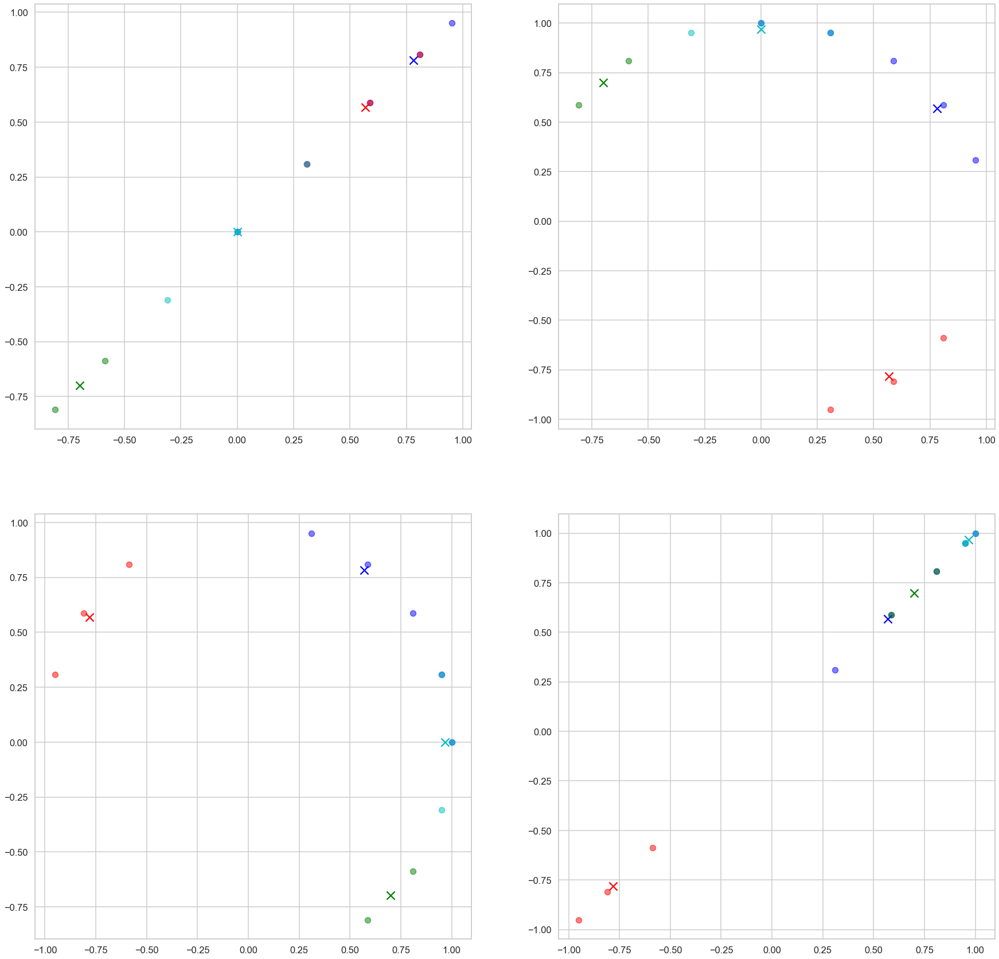

cluster_Performance [11.827308362187718, 6.27350614557117, 3.6546167243754395, 2.352528025180429, 1.7113311381648257, 1.338712500538433]
Graphs_For_Cluster= 8


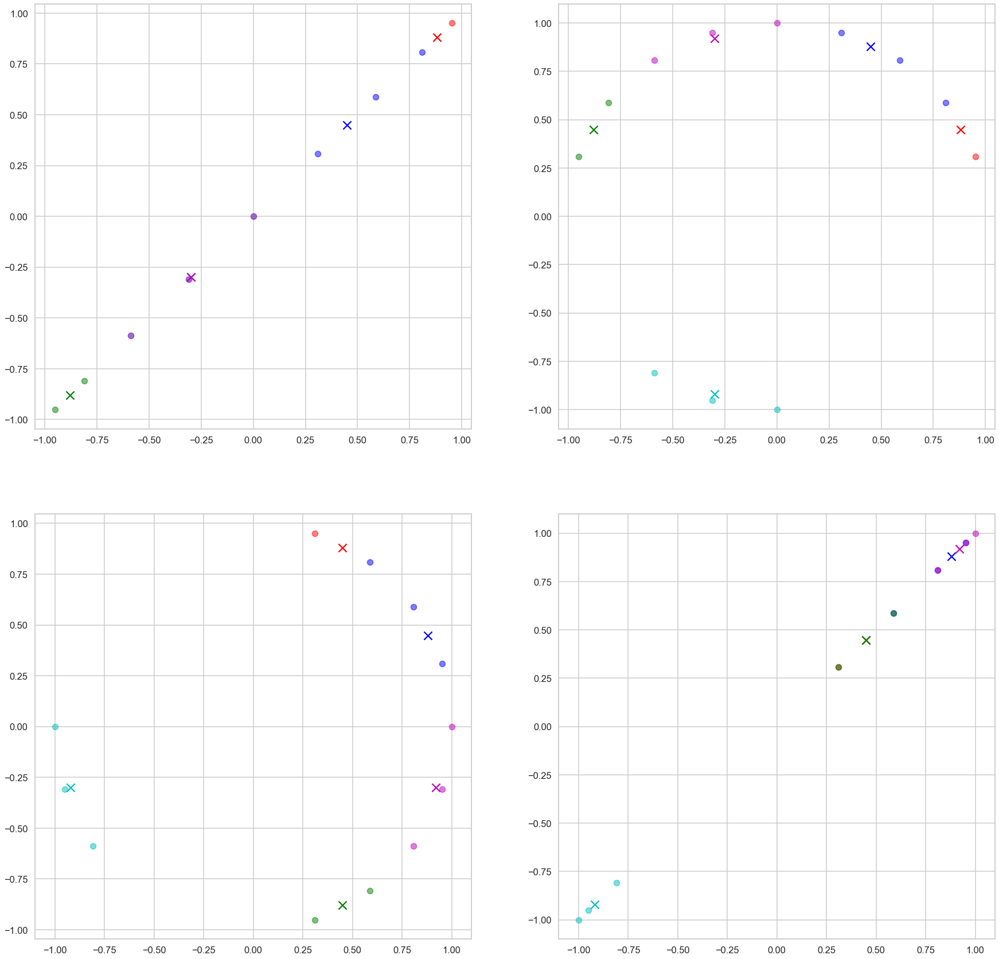

cluster_Performance [11.827308362187718, 6.27350614557117, 3.6546167243754395, 2.352528025180429, 1.7113311381648257, 1.338712500538433, 0.9660938629120404]
Graphs_For_Cluster= 9


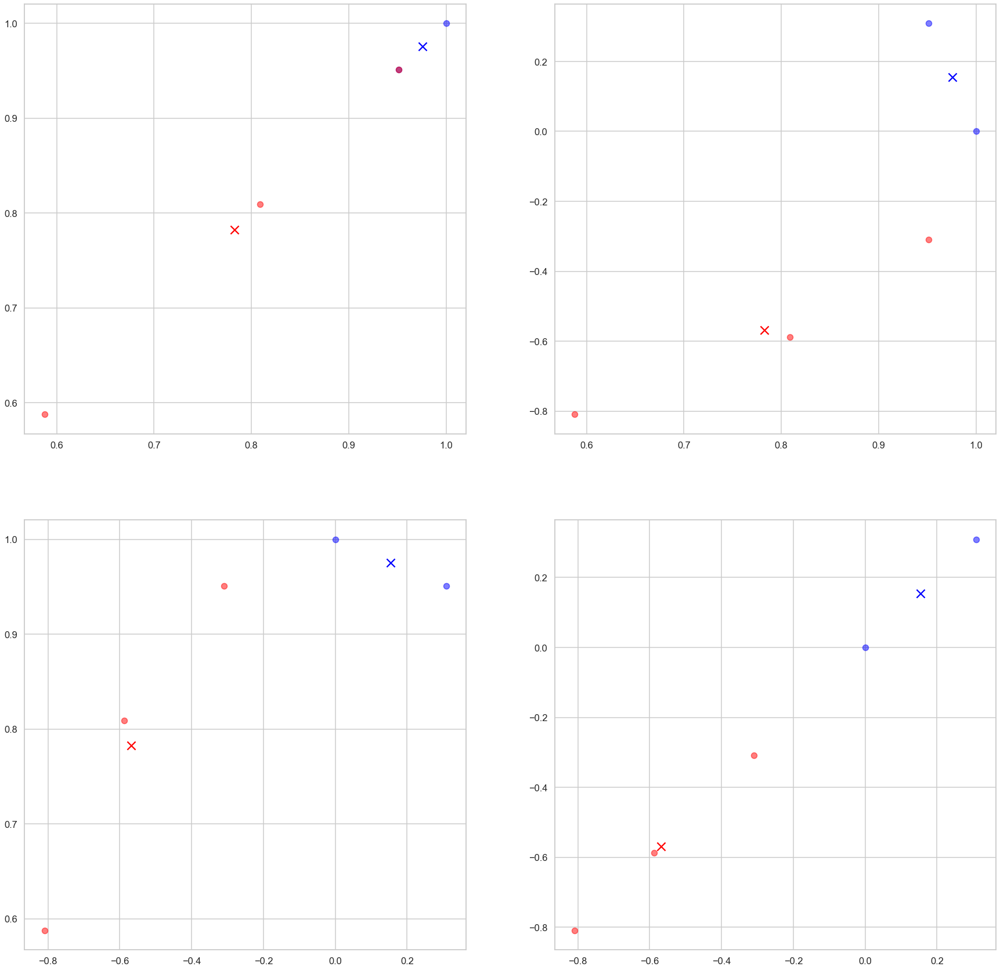

cluster_Performance [11.827308362187718, 6.27350614557117, 3.6546167243754395, 2.352528025180429, 1.7113311381648257, 1.338712500538433, 0.9660938629120404, 0.822457364593723]
Graphs_For_Cluster= 10


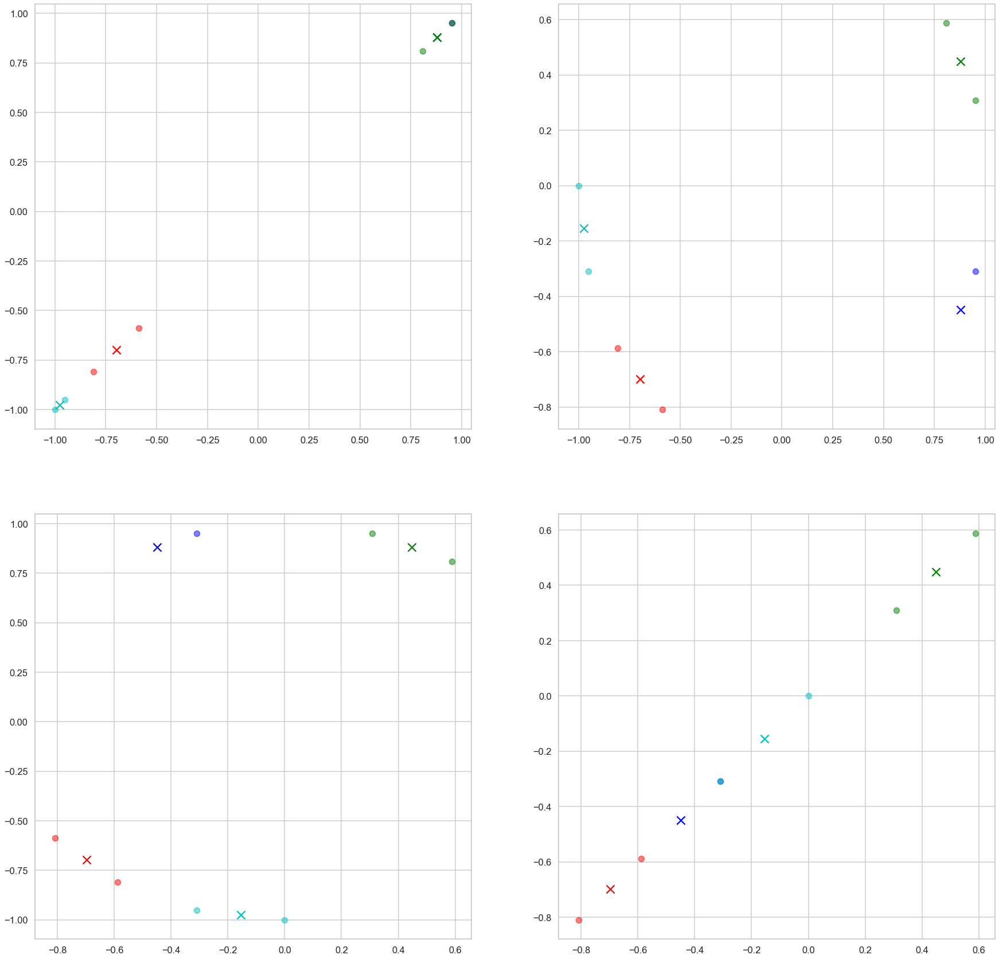

cluster_Performance [11.827308362187718, 6.27350614557117, 3.6546167243754395, 2.352528025180429, 1.7113311381648257, 1.338712500538433, 0.9660938629120404, 0.822457364593723, 0.5841278516619349]


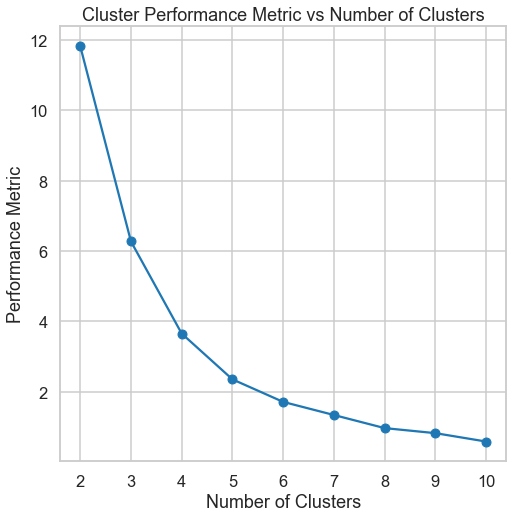

In [127]:
#Eaxmple 1_pearson 

# prepare the figure sise and background
# this part can be replaced by a number of subplots
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")
# Produce a data set that represent the x and y o coordinates of a circle
# this part can be replaced by data that you import froma file
angle = np.linspace(0,2*np.pi,20, endpoint = False)
X = np.append([np.cos(angle)],[np.sin(angle)],0).transpose()
# Data is displayed
# to display the data only it is assumed that the number of clusters is zero which is the default of the fuction
# display_cluster(X)

plotting_Examples(X,"pearson")


Graphs_For_Cluster= 2


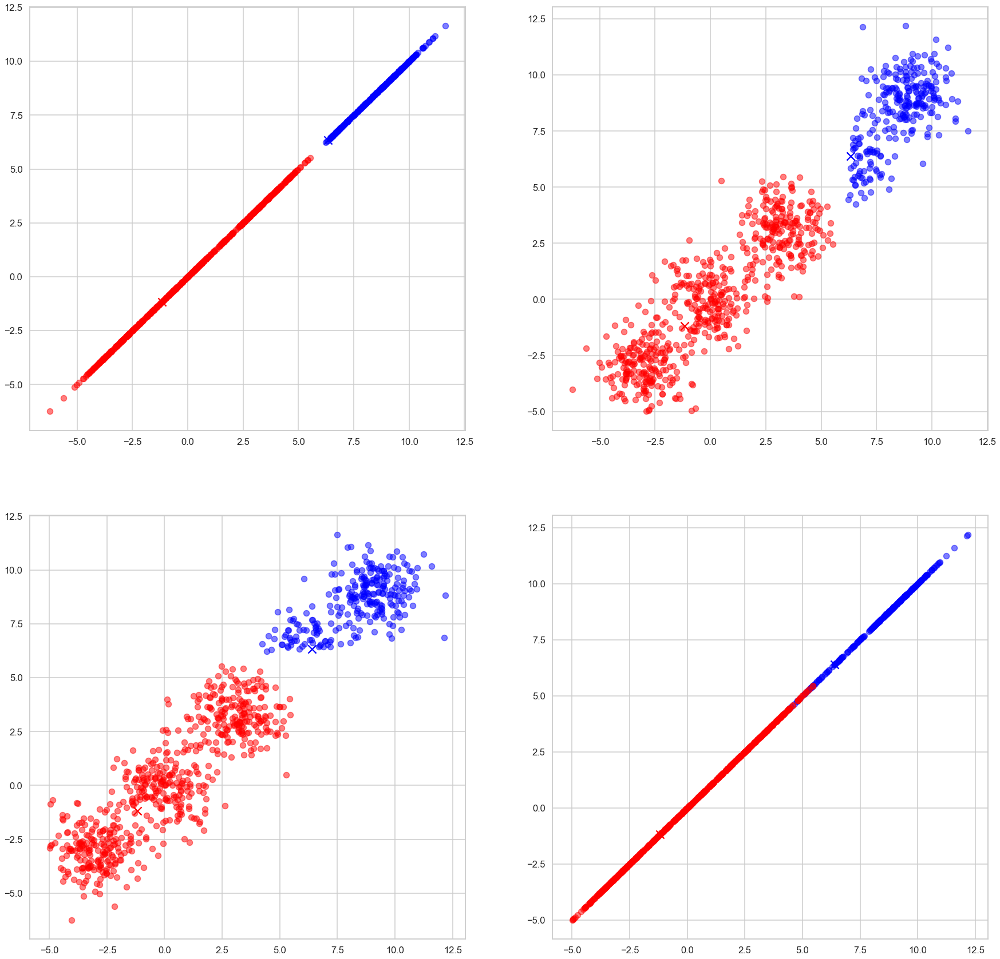

cluster_Performance [10354.018824821156]
Graphs_For_Cluster= 3


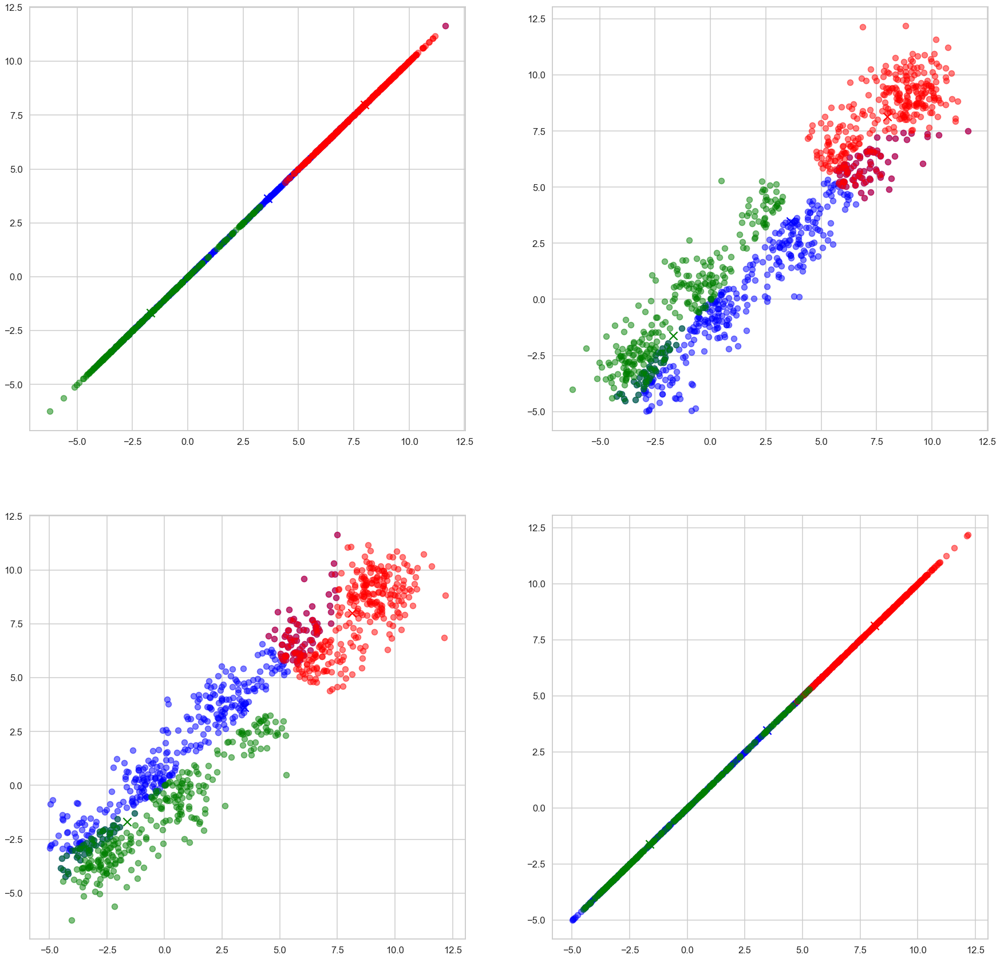

cluster_Performance [10354.018824821156, 4937.314260192345]
Graphs_For_Cluster= 4


C:\Users\Darin\AppData\Local\Temp/ipykernel_3684/1651446491.py:31: RuntimeWarning: Mean of empty slice
  mean_square_distances[i] = np.nanmean(squared_distances)  # Calculate mean while ignoring NaN values


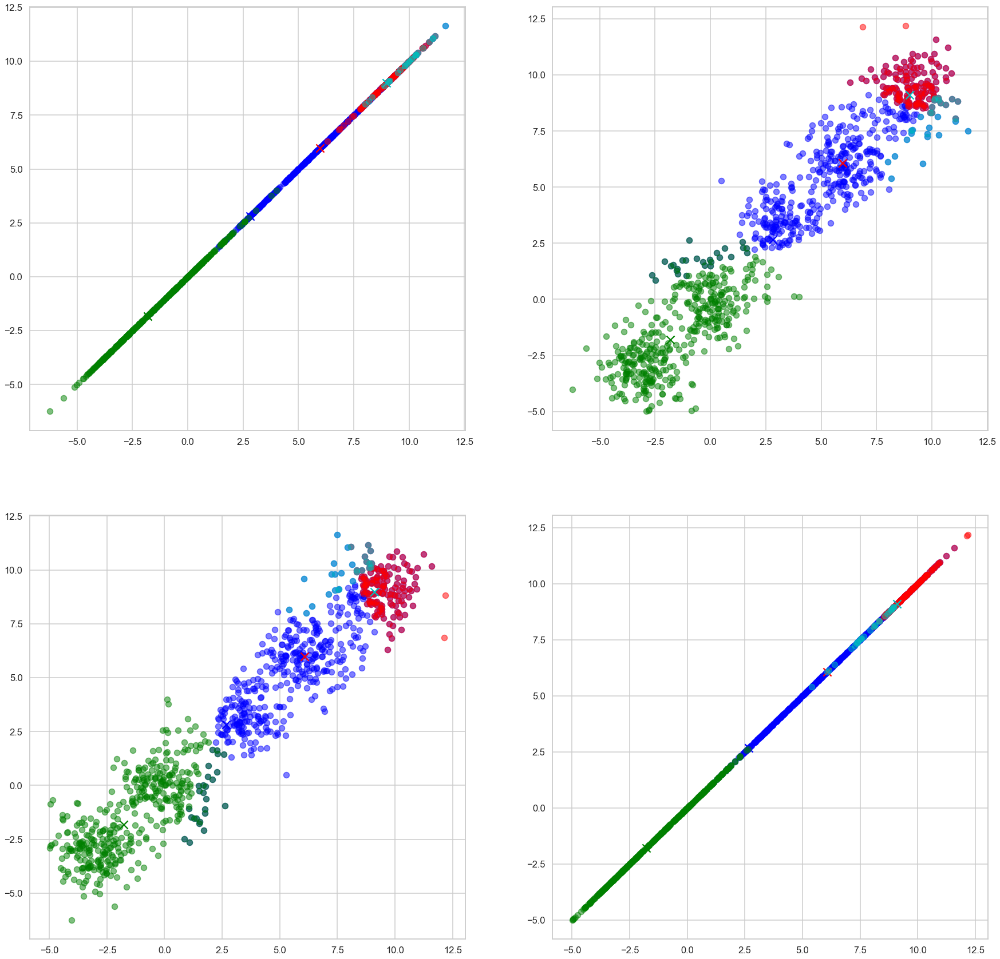

cluster_Performance [10354.018824821156, 4937.314260192345, 3384.5822669910976]
Graphs_For_Cluster= 5


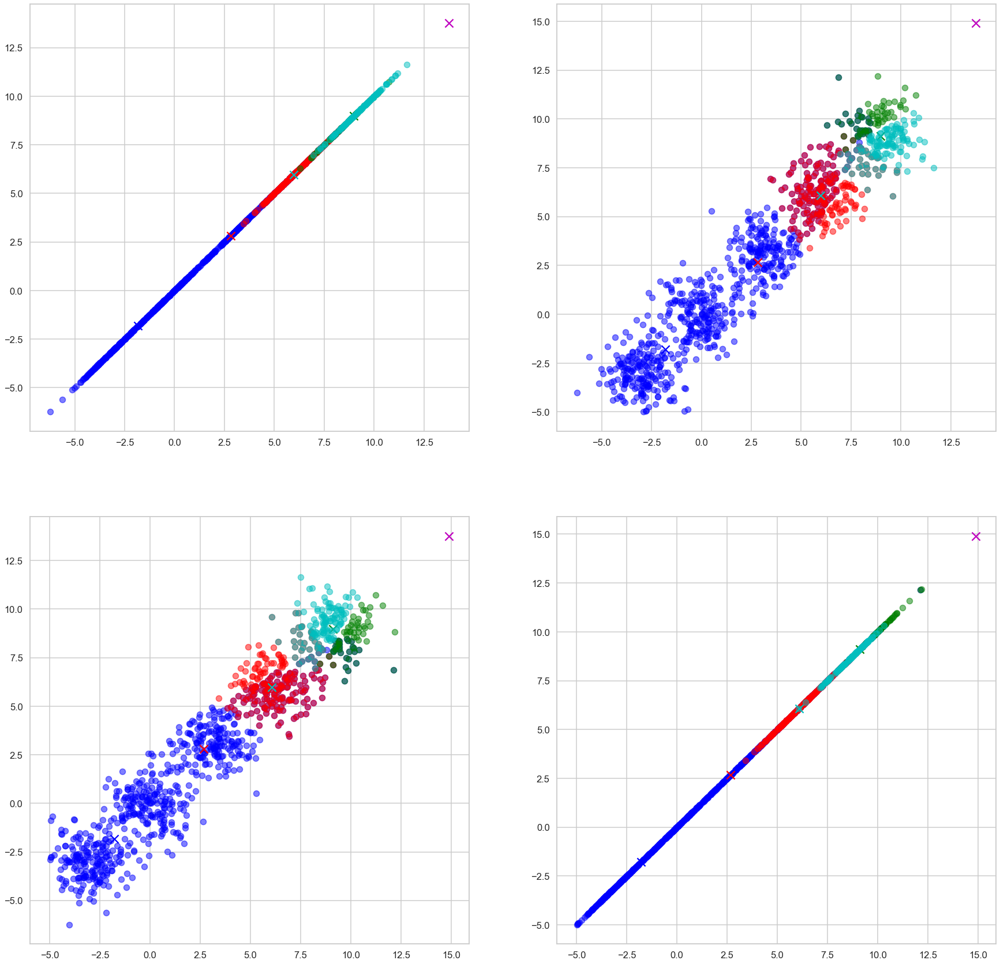

cluster_Performance [10354.018824821156, 4937.314260192345, 3384.5822669910976, 3384.5822669910976]
Graphs_For_Cluster= 6


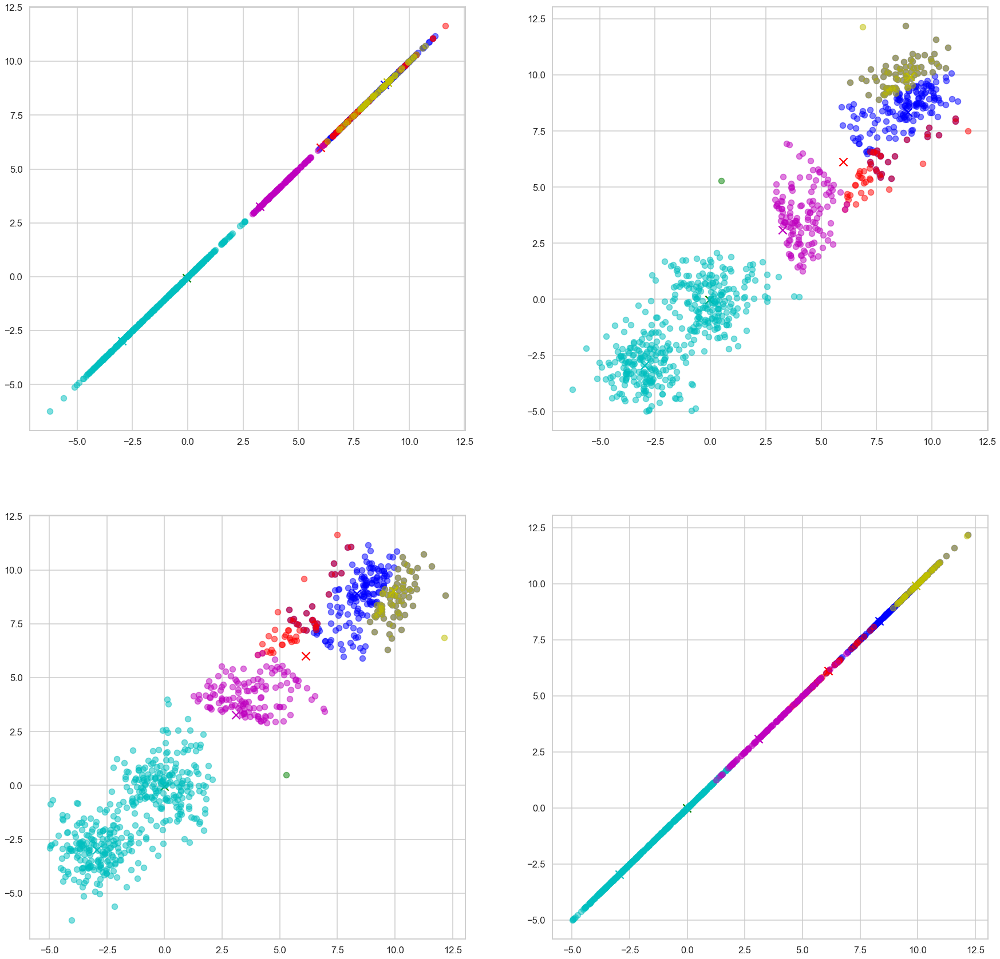

cluster_Performance [10354.018824821156, 4937.314260192345, 3384.5822669910976, 3384.5822669910976, 1746.3535609166256]
Graphs_For_Cluster= 7


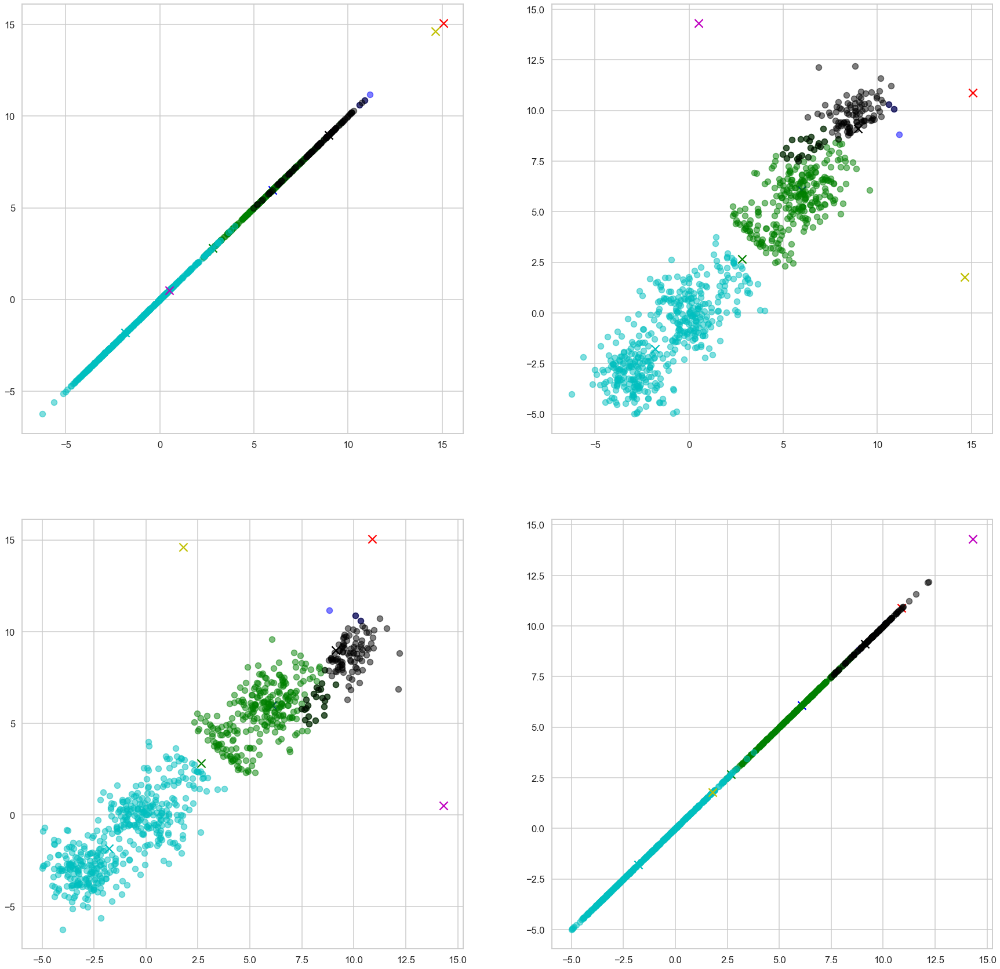

cluster_Performance [10354.018824821156, 4937.314260192345, 3384.5822669910976, 3384.5822669910976, 1746.3535609166256, 3384.5822669910976]
Graphs_For_Cluster= 8


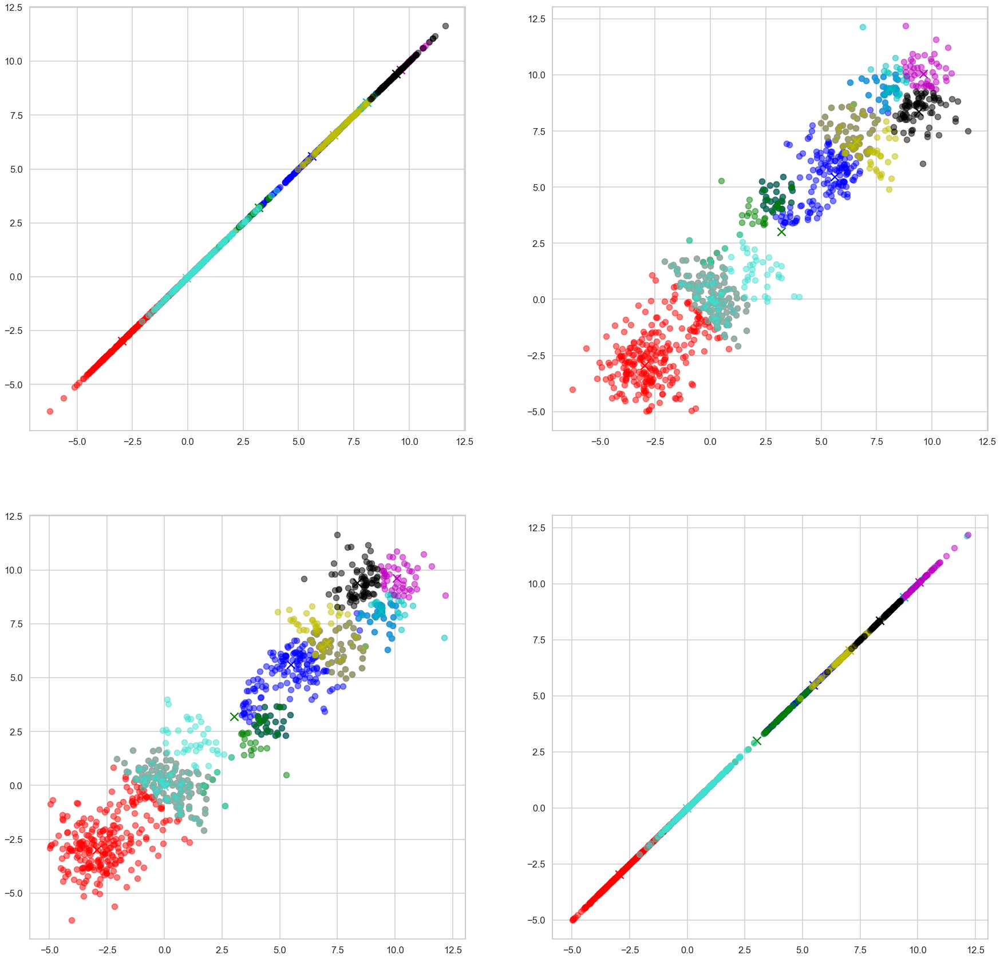

cluster_Performance [10354.018824821156, 4937.314260192345, 3384.5822669910976, 3384.5822669910976, 1746.3535609166256, 3384.5822669910976, 1544.2902061993113]
Graphs_For_Cluster= 9


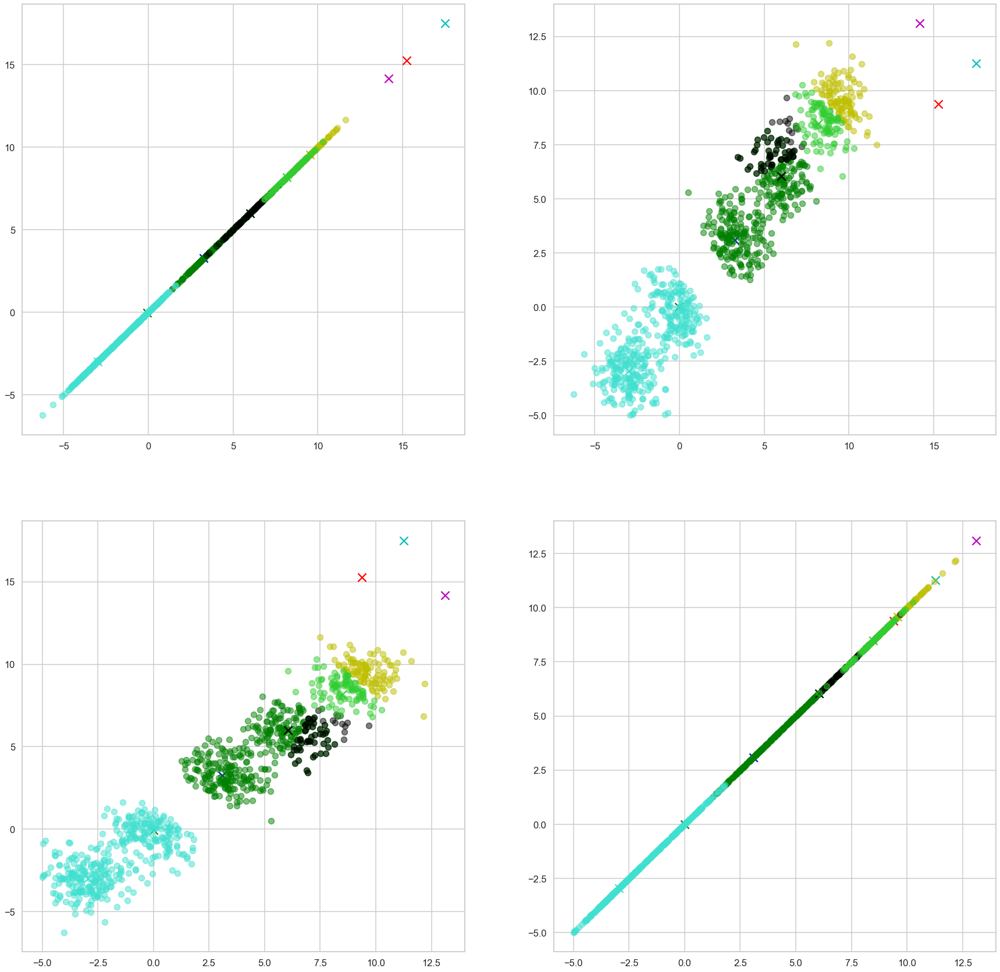

cluster_Performance [10354.018824821156, 4937.314260192345, 3384.5822669910976, 3384.5822669910976, 1746.3535609166256, 3384.5822669910976, 1544.2902061993113, 1724.55577079861]
Graphs_For_Cluster= 10


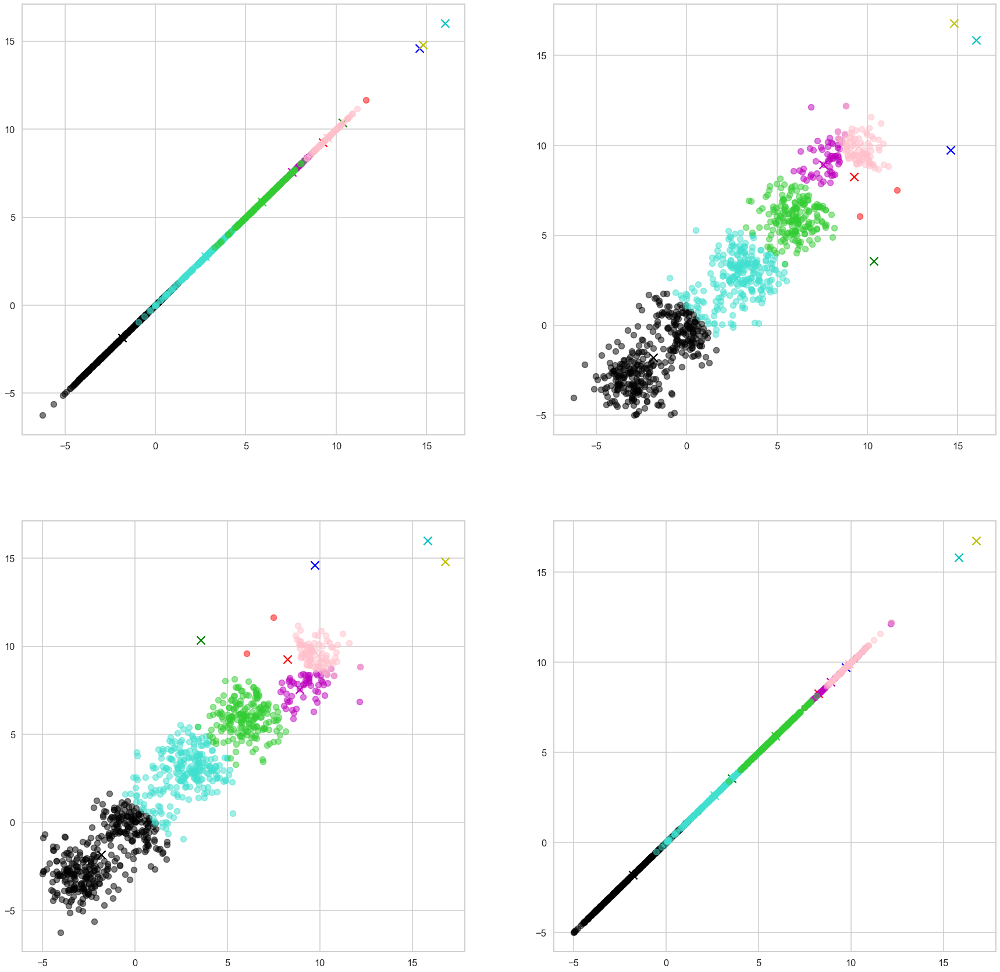

cluster_Performance [10354.018824821156, 4937.314260192345, 3384.5822669910976, 3384.5822669910976, 1746.3535609166256, 3384.5822669910976, 1544.2902061993113, 1724.55577079861, 3155.099390268442]


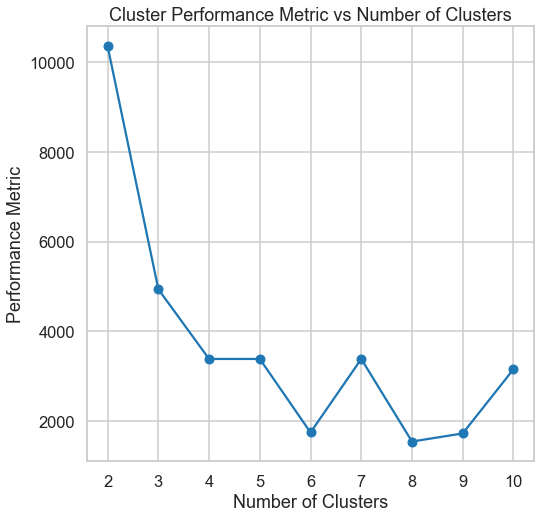

In [128]:
#Example_2_Euclidian
n_samples = 1000
n_bins = 4
centers = [(-3, -3), (0, 0), (3, 3), (6, 6), (9,9)]
X, y = make_blobs(n_samples=n_samples, n_features=2, cluster_std=1.0,
                  centers=centers, shuffle=False, random_state=42)

plotting_Examples(X,"euclidean")


Graphs_For_Cluster= 2


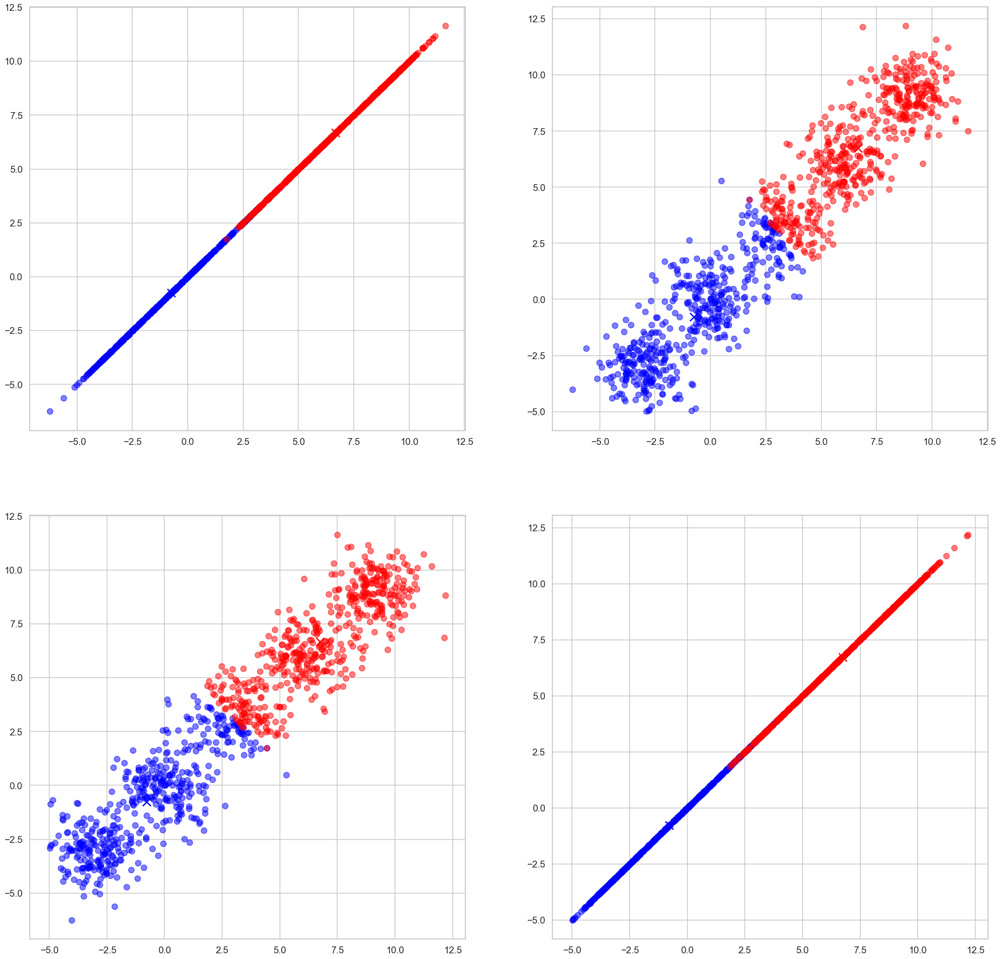

cluster_Performance [10457.832007622164]
Graphs_For_Cluster= 3


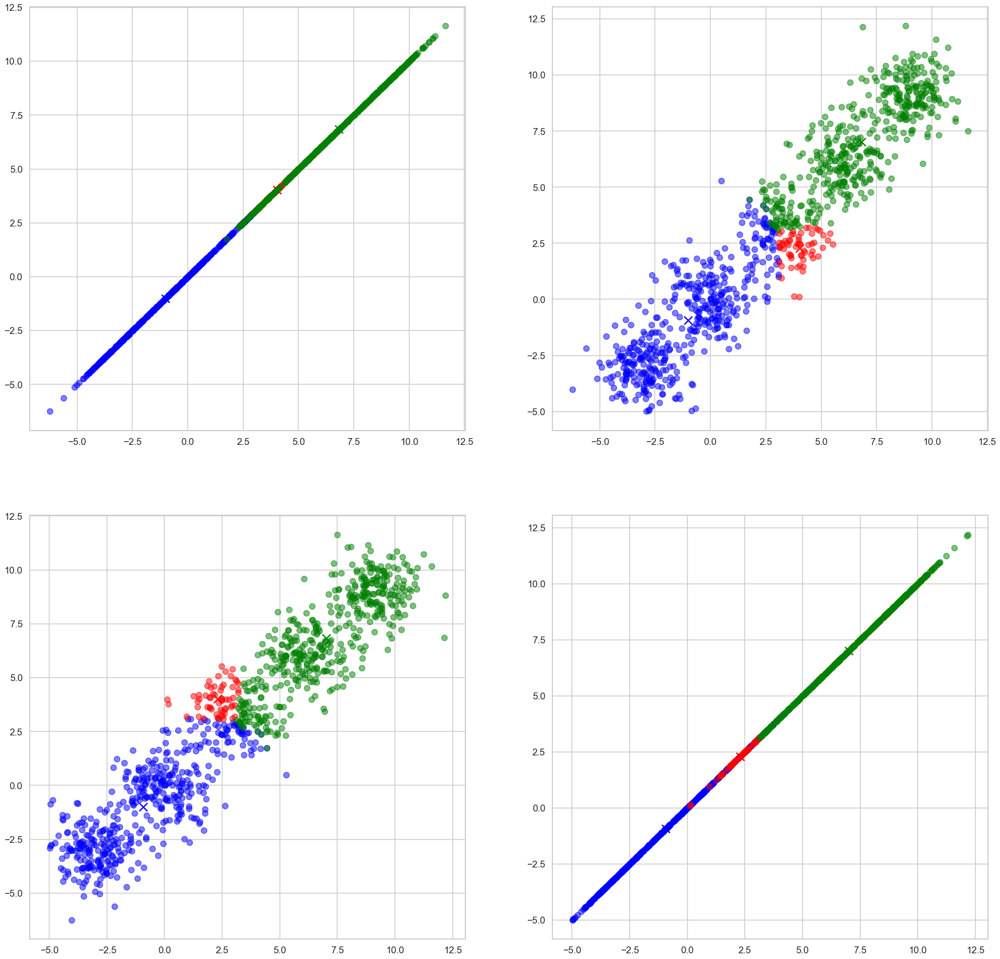

cluster_Performance [10457.832007622164, 8986.036919219581]
Graphs_For_Cluster= 4


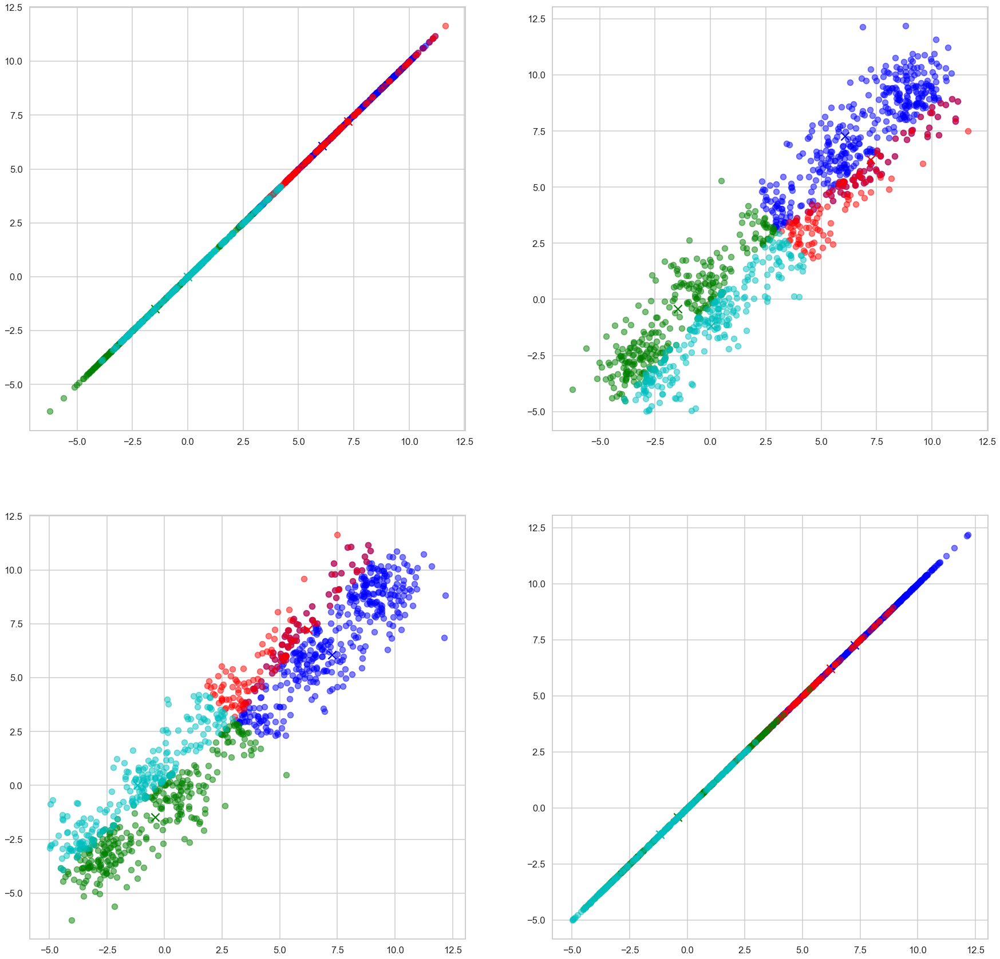

cluster_Performance [10457.832007622164, 8986.036919219581, 9801.181079040447]
Graphs_For_Cluster= 5


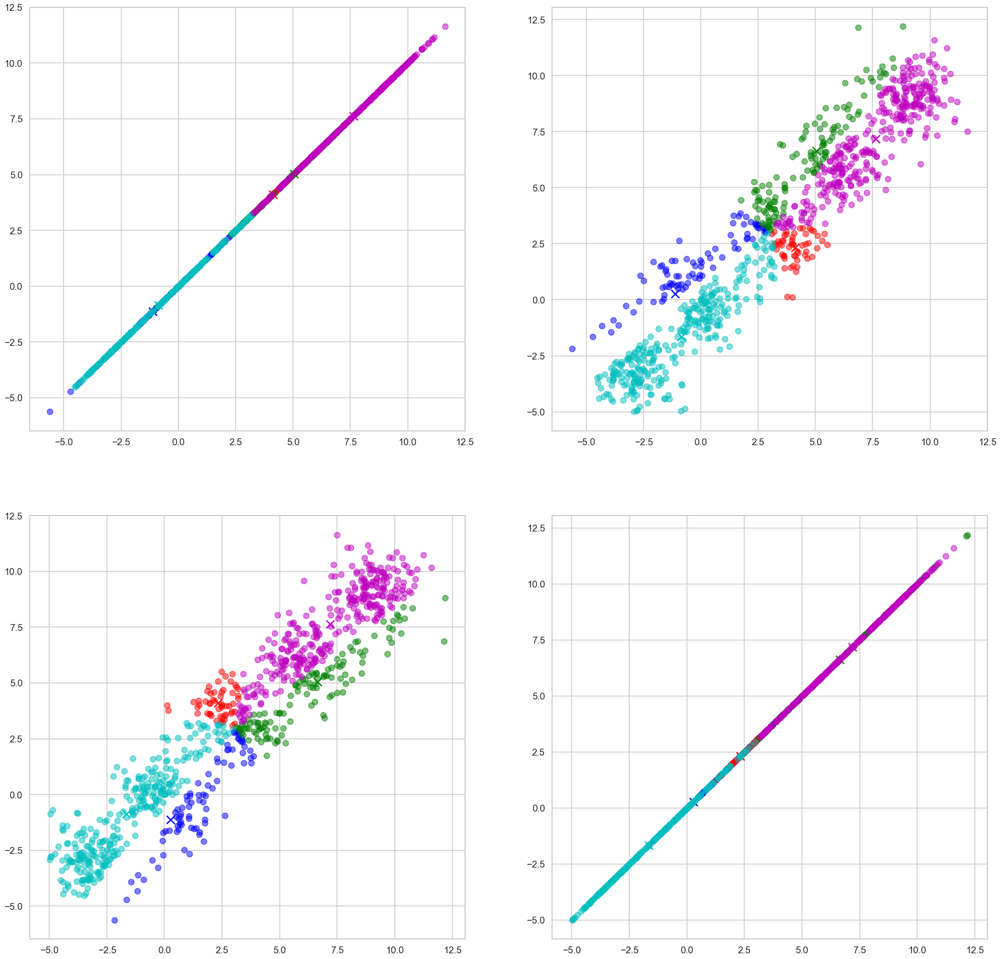

cluster_Performance [10457.832007622164, 8986.036919219581, 9801.181079040447, 7972.947572218595]
Graphs_For_Cluster= 6


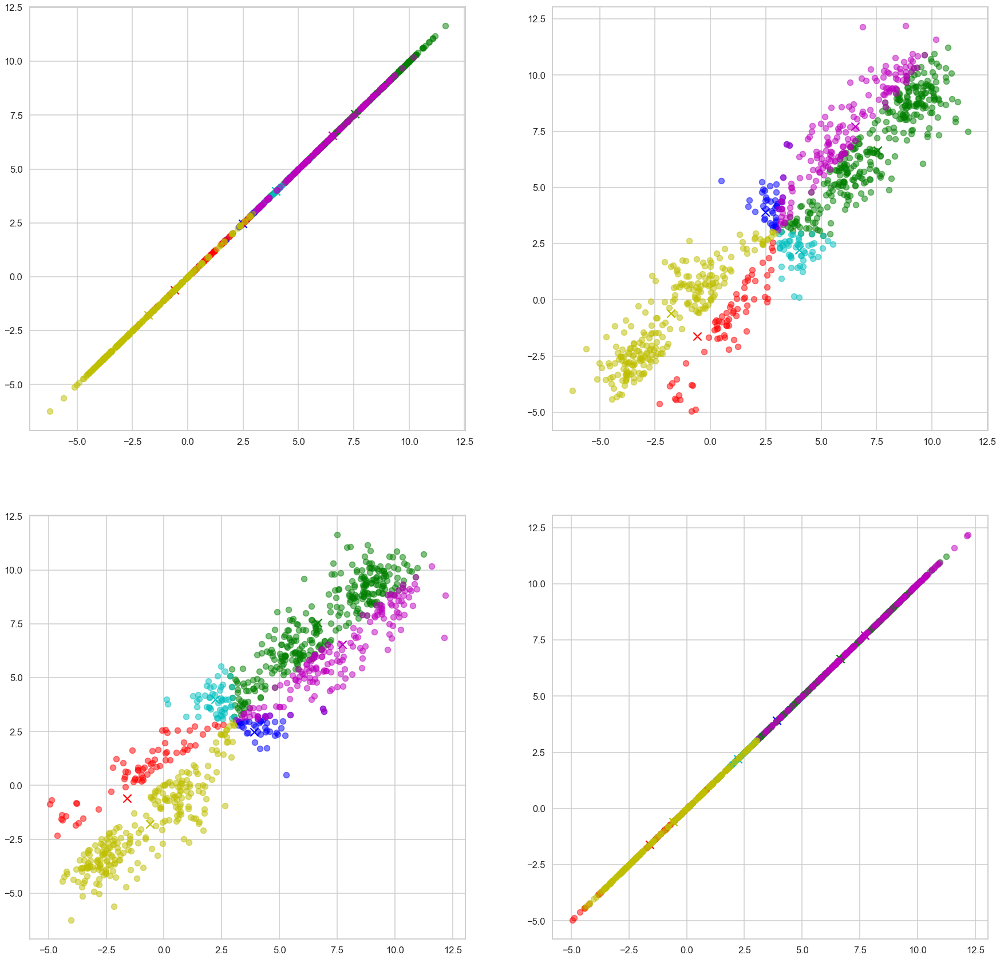

cluster_Performance [10457.832007622164, 8986.036919219581, 9801.181079040447, 7972.947572218595, 7142.065347506115]
Graphs_For_Cluster= 7


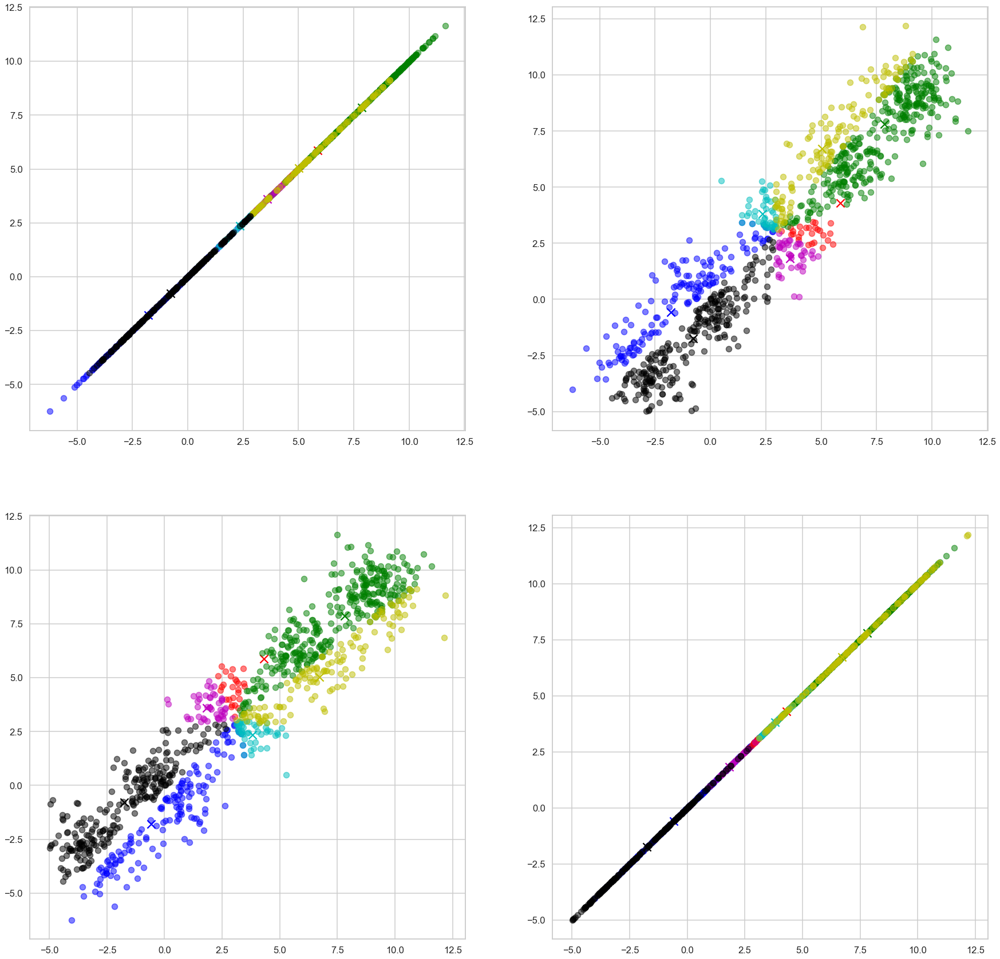

cluster_Performance [10457.832007622164, 8986.036919219581, 9801.181079040447, 7972.947572218595, 7142.065347506115, 6252.555624725424]
Graphs_For_Cluster= 8


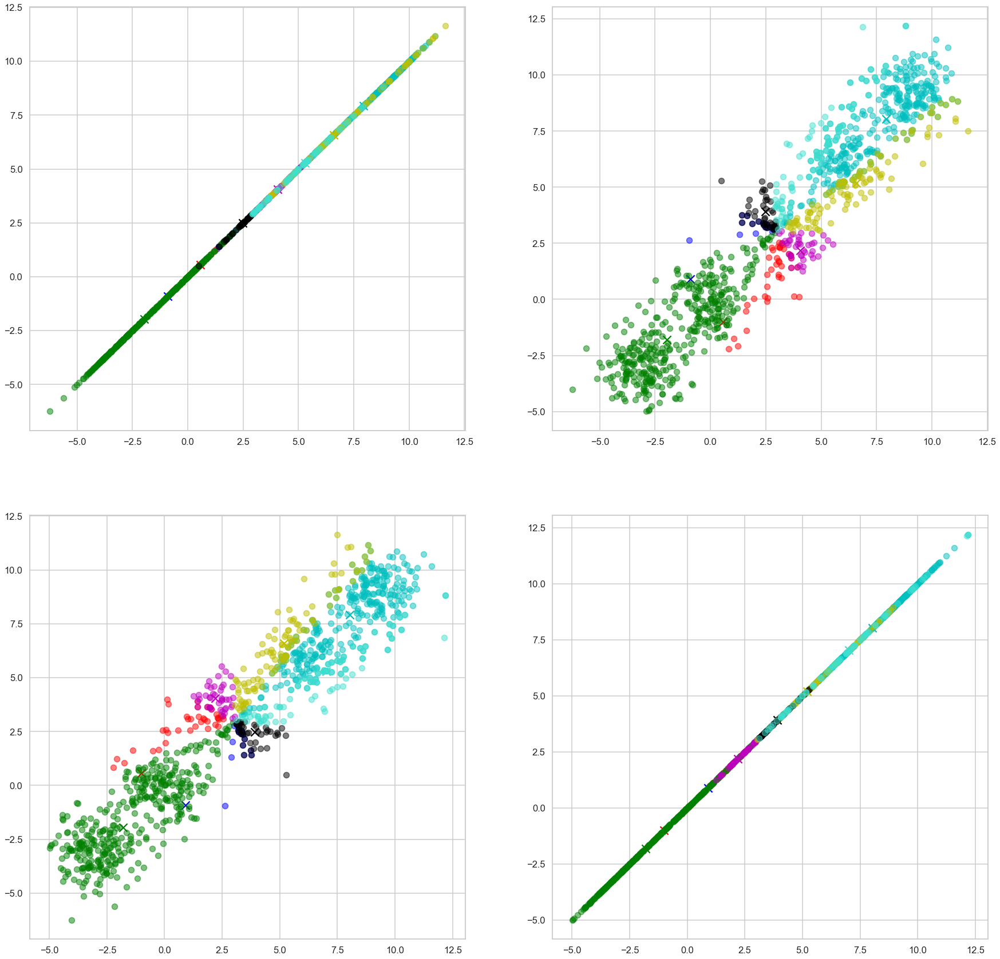

cluster_Performance [10457.832007622164, 8986.036919219581, 9801.181079040447, 7972.947572218595, 7142.065347506115, 6252.555624725424, 5754.498789589253]
Graphs_For_Cluster= 9


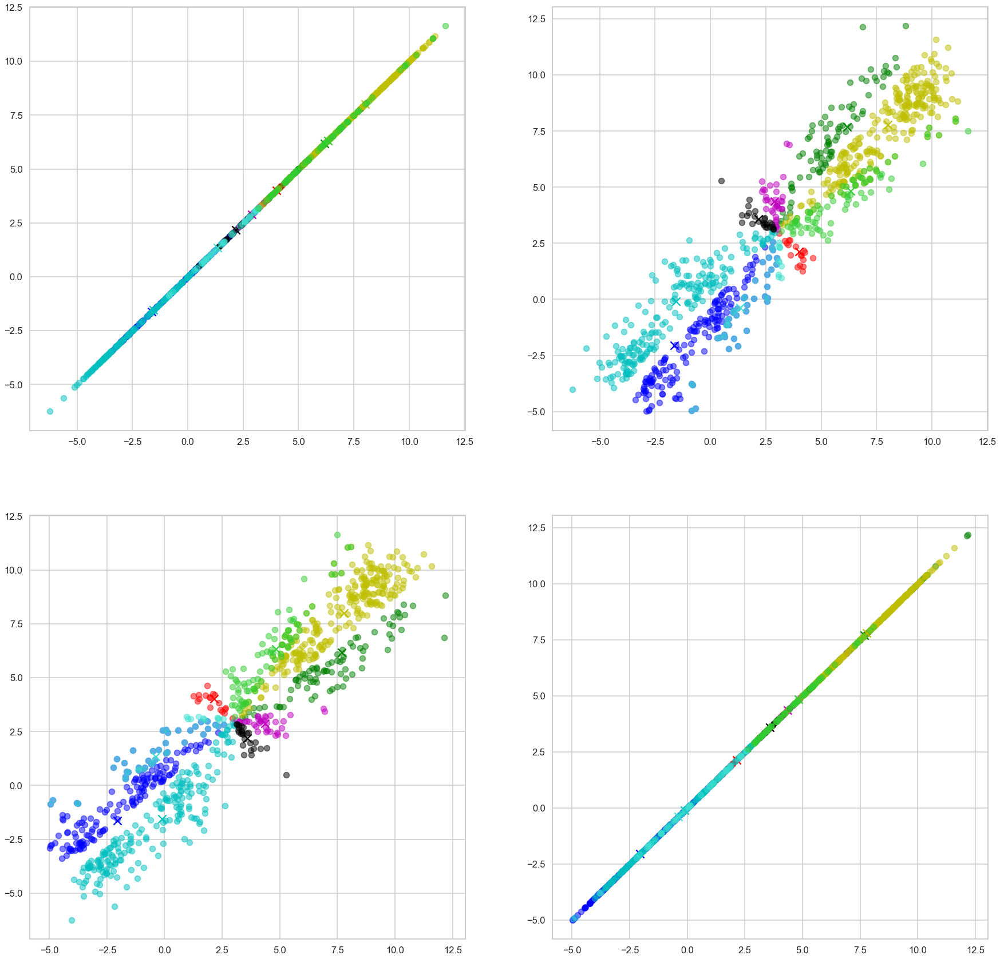

cluster_Performance [10457.832007622164, 8986.036919219581, 9801.181079040447, 7972.947572218595, 7142.065347506115, 6252.555624725424, 5754.498789589253, 5775.232091204969]
Graphs_For_Cluster= 10


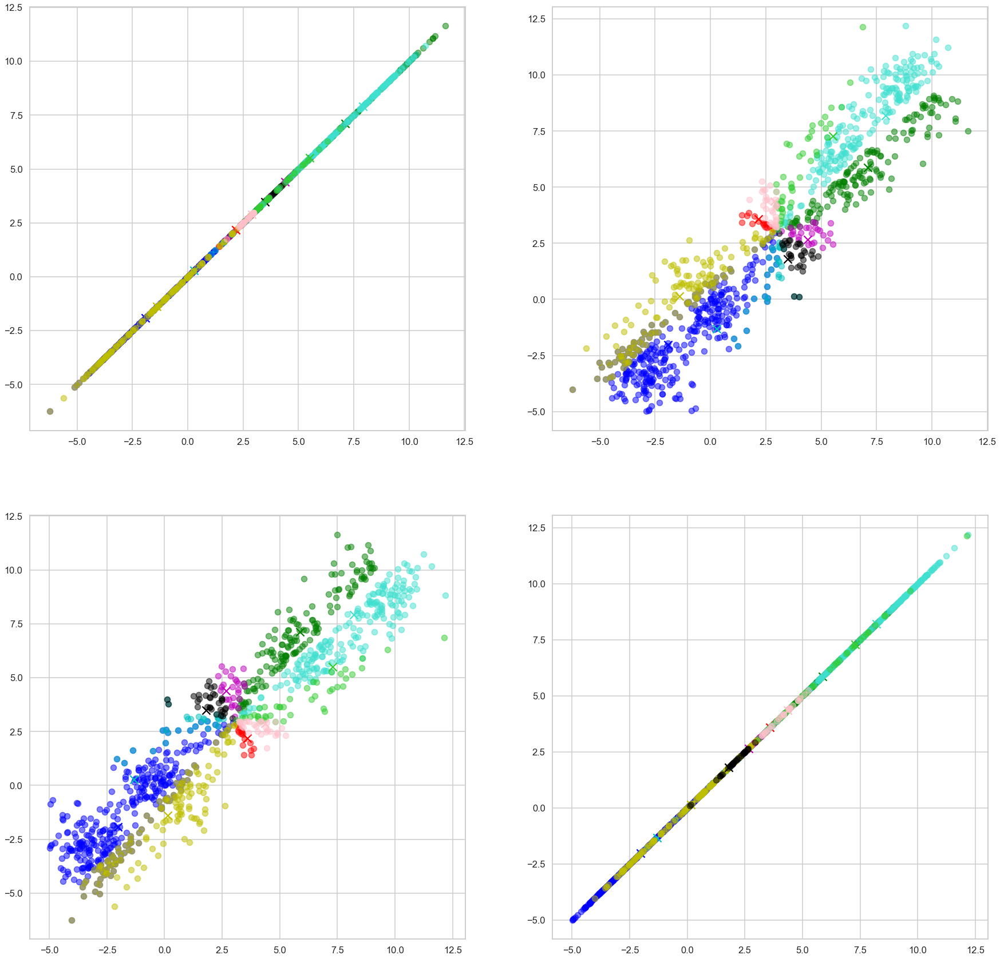

cluster_Performance [10457.832007622164, 8986.036919219581, 9801.181079040447, 7972.947572218595, 7142.065347506115, 6252.555624725424, 5754.498789589253, 5775.232091204969, 5550.258054157025]


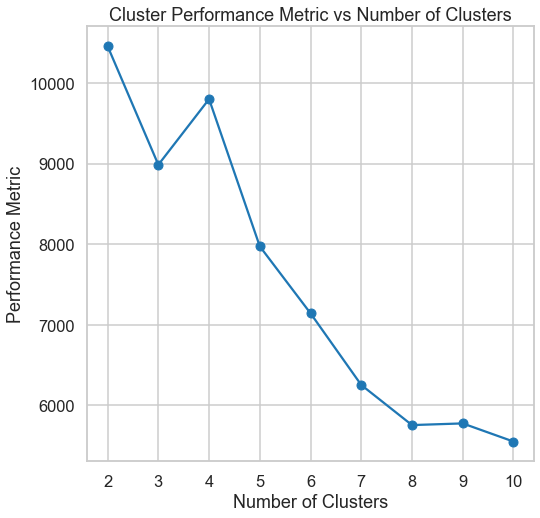

In [130]:
#Example_2_pearson
n_samples = 1000
n_bins = 4
centers = [(-3, -3), (0, 0), (3, 3), (6, 6), (9,9)]
X, y = make_blobs(n_samples=n_samples, n_features=2, cluster_std=1.0,
                  centers=centers, shuffle=False, random_state=42)
plotting_Examples(X,"pearson")


Graphs_For_Cluster= 2


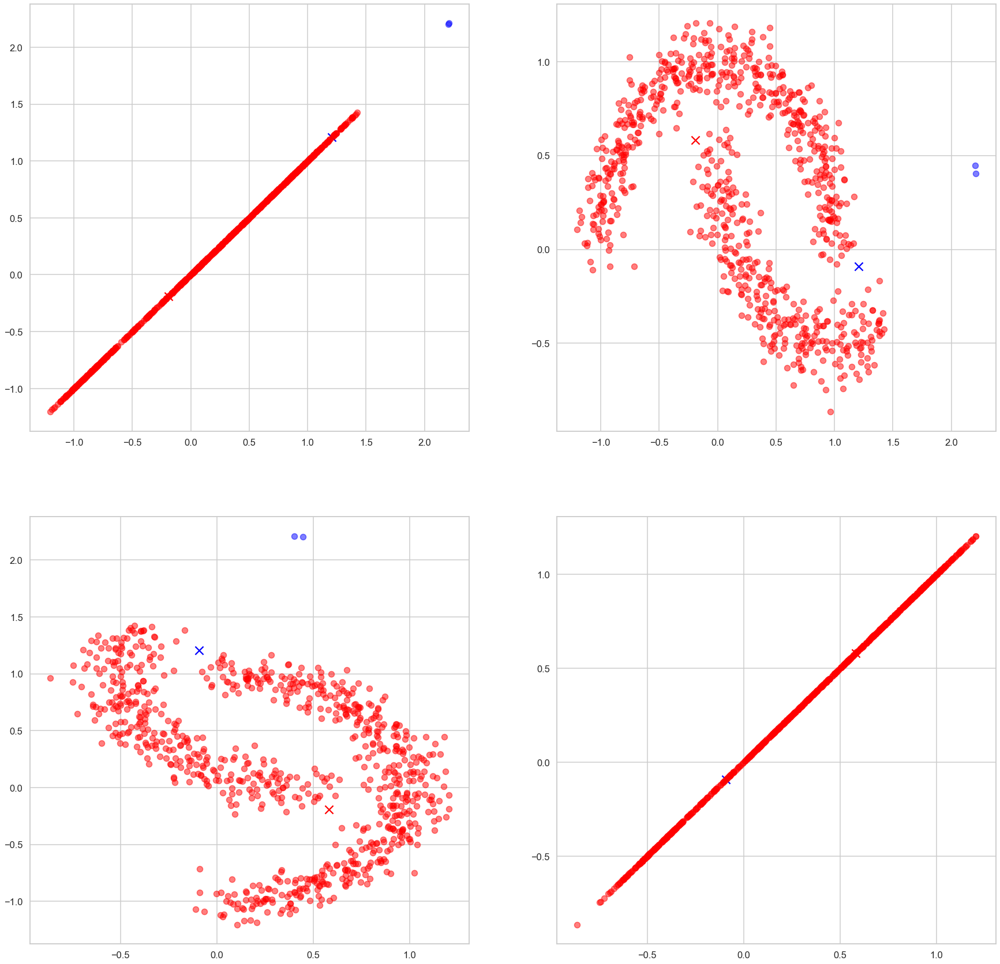

cluster_Performance [410.6761794958234]
Graphs_For_Cluster= 3


C:\Users\Darin\AppData\Local\Temp/ipykernel_3684/1651446491.py:31: RuntimeWarning: Mean of empty slice
  mean_square_distances[i] = np.nanmean(squared_distances)  # Calculate mean while ignoring NaN values


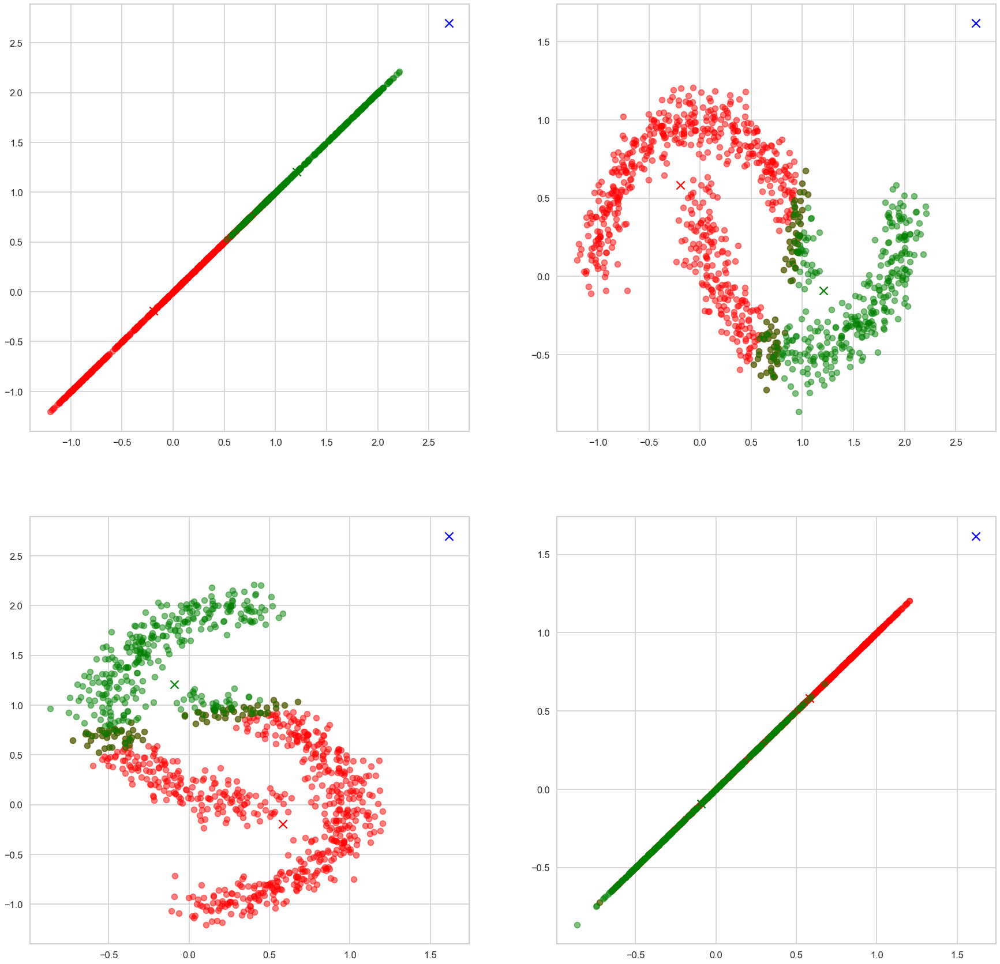

cluster_Performance [410.6761794958234, 410.6761794958234]
Graphs_For_Cluster= 4


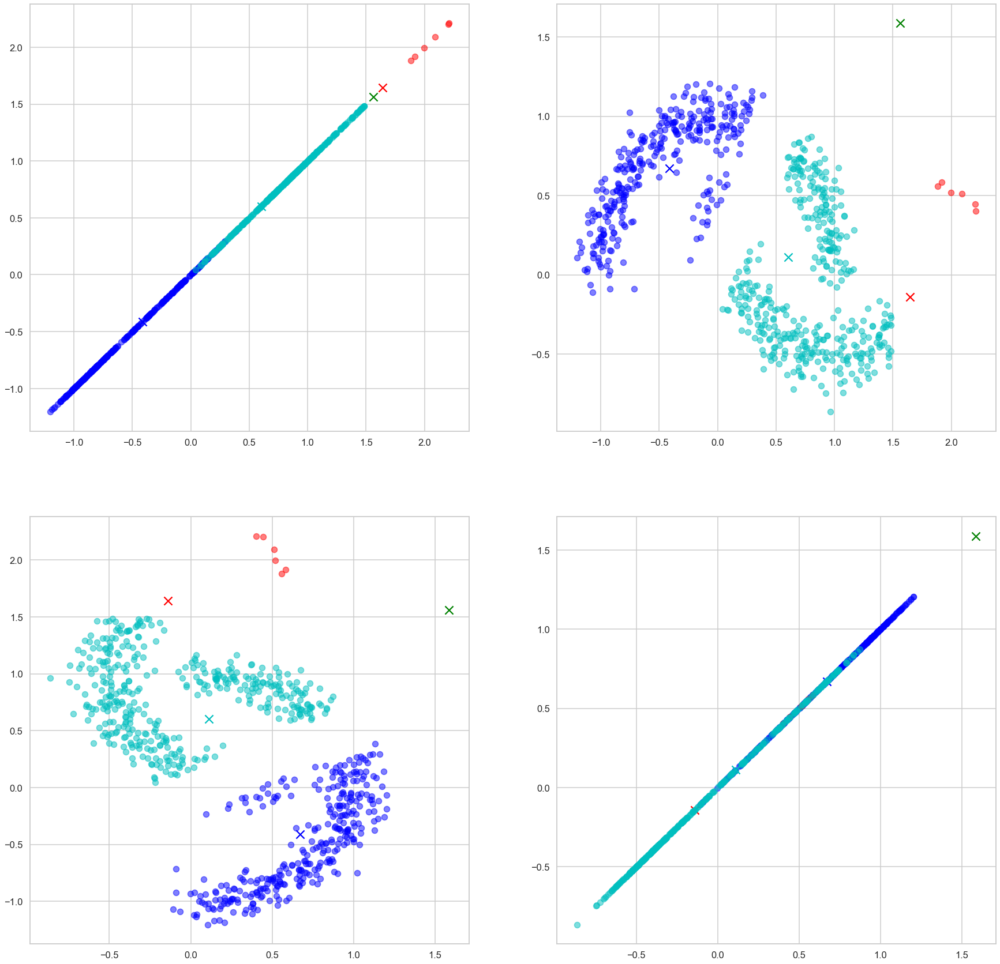

cluster_Performance [410.6761794958234, 410.6761794958234, 276.5118243240741]
Graphs_For_Cluster= 5


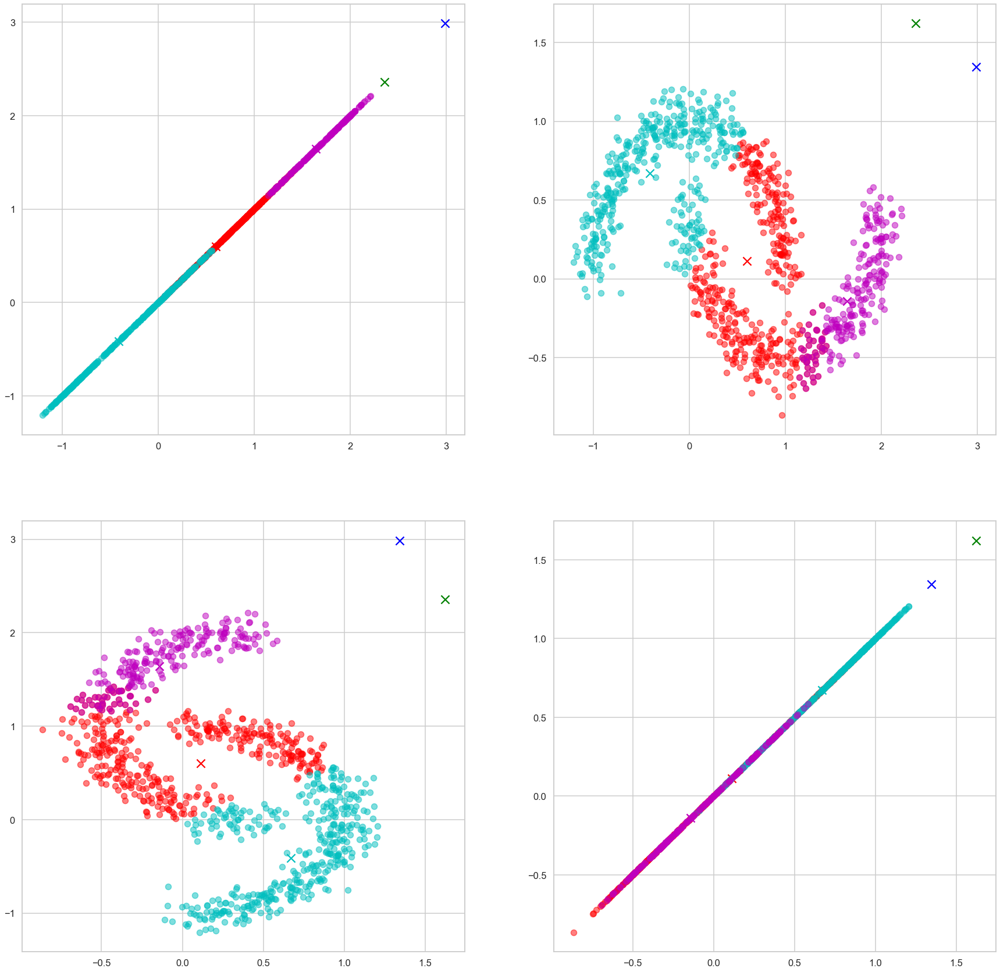

cluster_Performance [410.6761794958234, 410.6761794958234, 276.5118243240741, 276.5118243240741]
Graphs_For_Cluster= 6


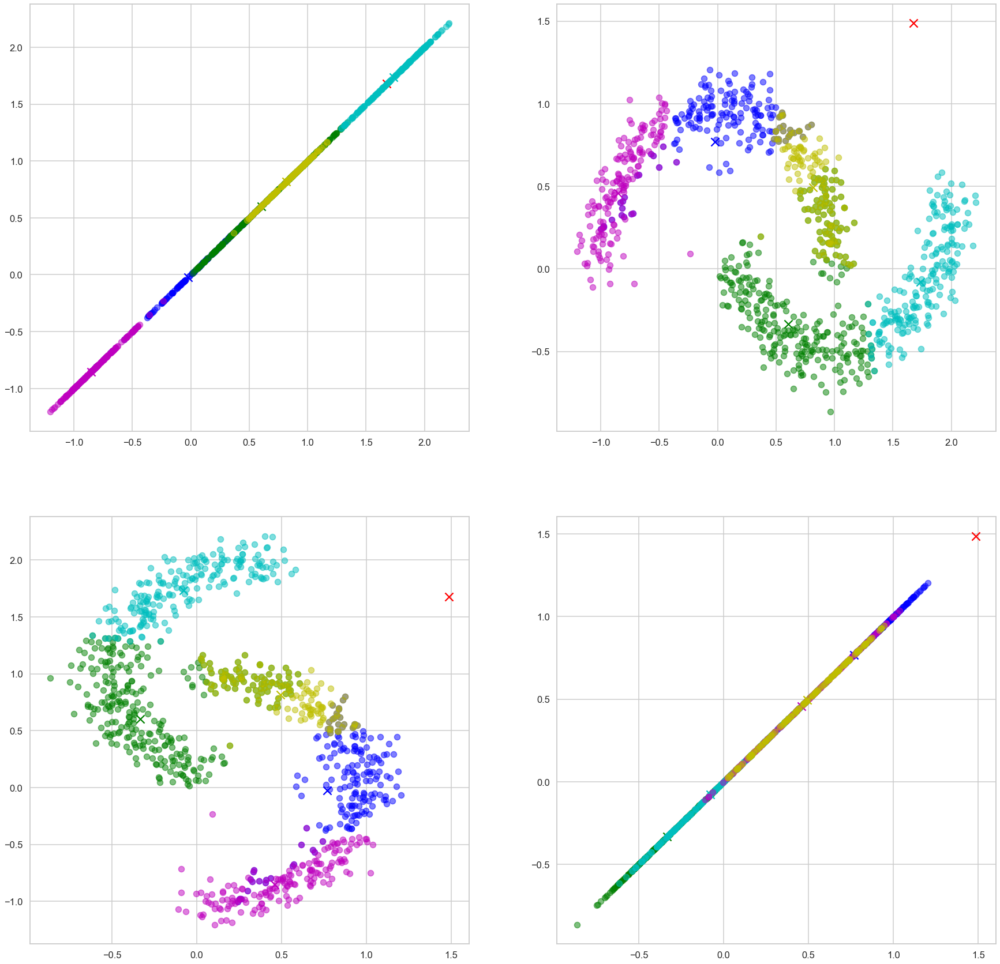

cluster_Performance [410.6761794958234, 410.6761794958234, 276.5118243240741, 276.5118243240741, 136.52026835845663]
Graphs_For_Cluster= 7


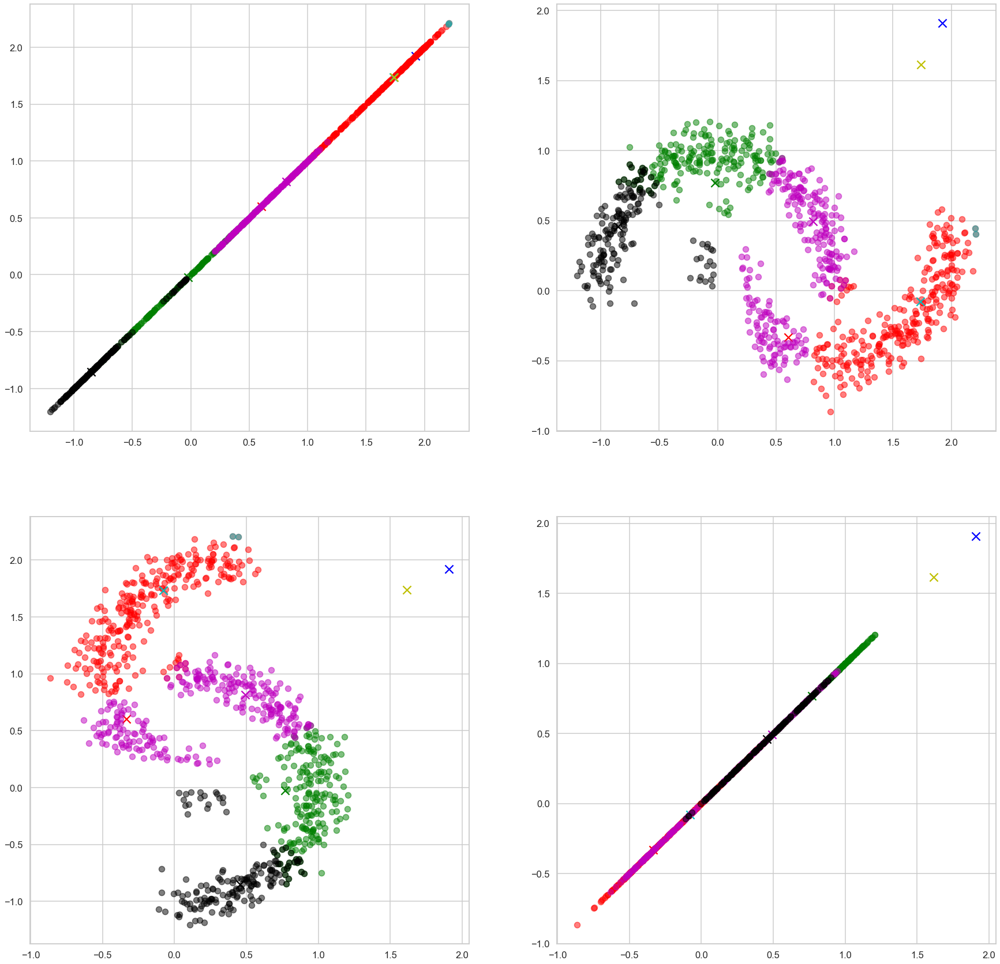

cluster_Performance [410.6761794958234, 410.6761794958234, 276.5118243240741, 276.5118243240741, 136.52026835845663, 136.52026835845663]
Graphs_For_Cluster= 8


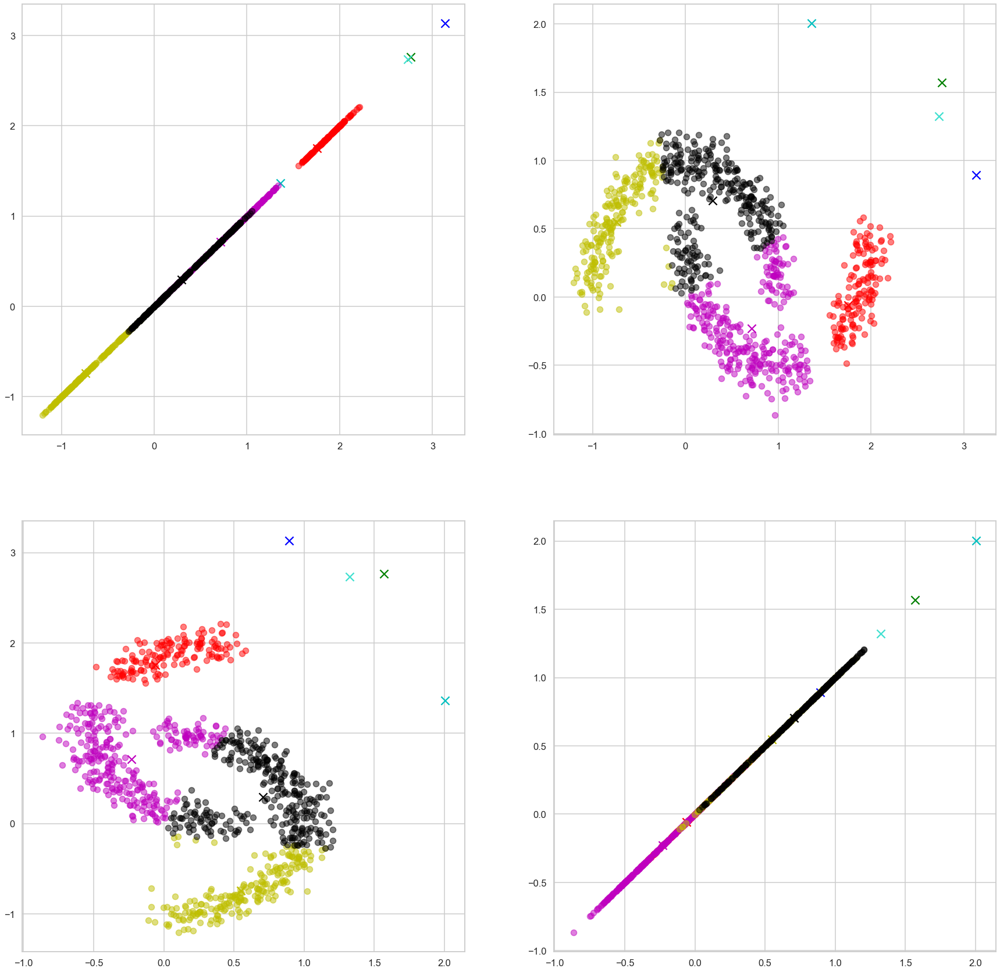

cluster_Performance [410.6761794958234, 410.6761794958234, 276.5118243240741, 276.5118243240741, 136.52026835845663, 136.52026835845663, 182.96484962041245]
Graphs_For_Cluster= 9


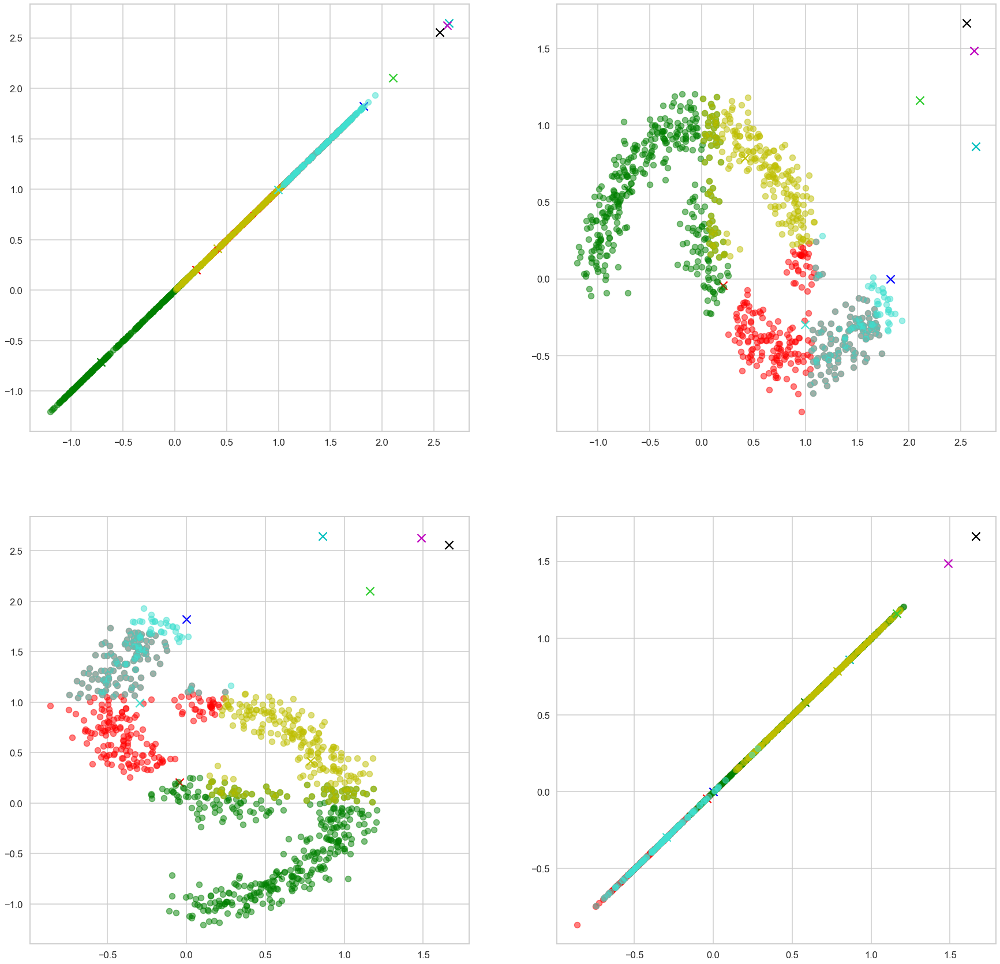

cluster_Performance [410.6761794958234, 410.6761794958234, 276.5118243240741, 276.5118243240741, 136.52026835845663, 136.52026835845663, 182.96484962041245, 144.02195606858243]
Graphs_For_Cluster= 10


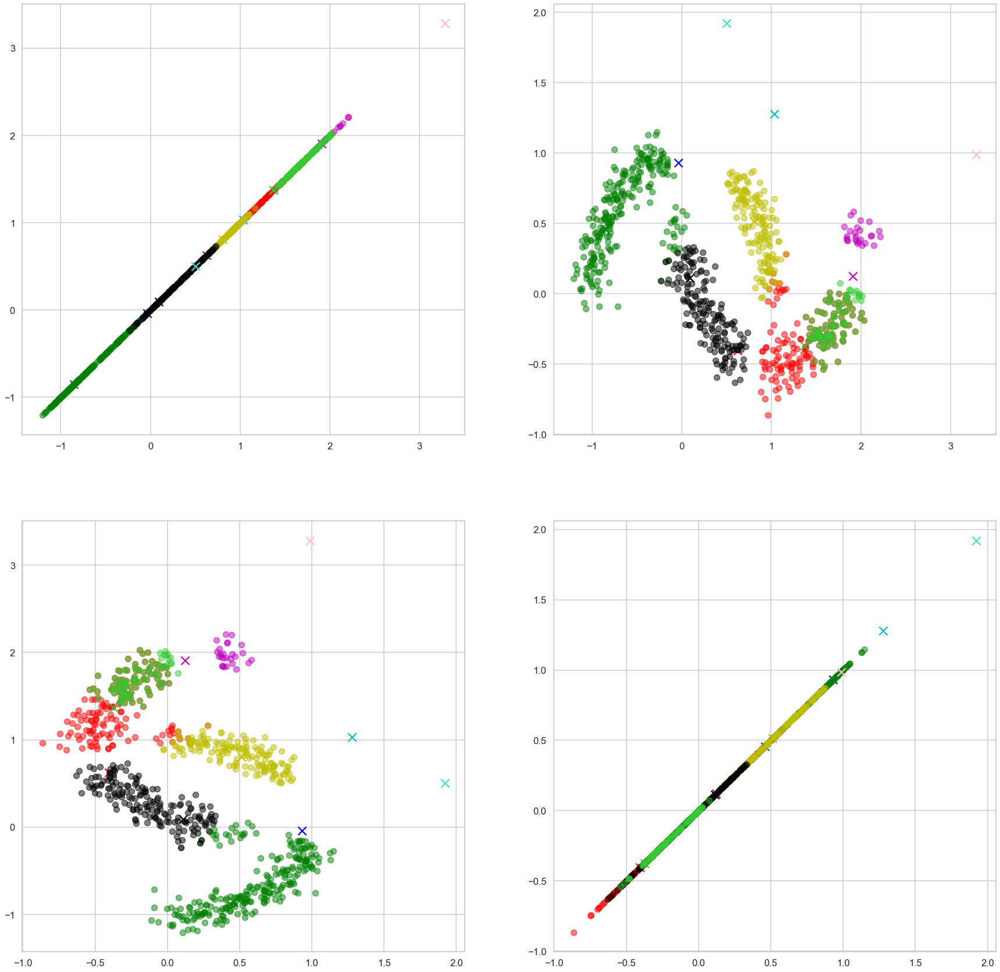

cluster_Performance [410.6761794958234, 410.6761794958234, 276.5118243240741, 276.5118243240741, 136.52026835845663, 136.52026835845663, 182.96484962041245, 144.02195606858243, 78.6764330160258]


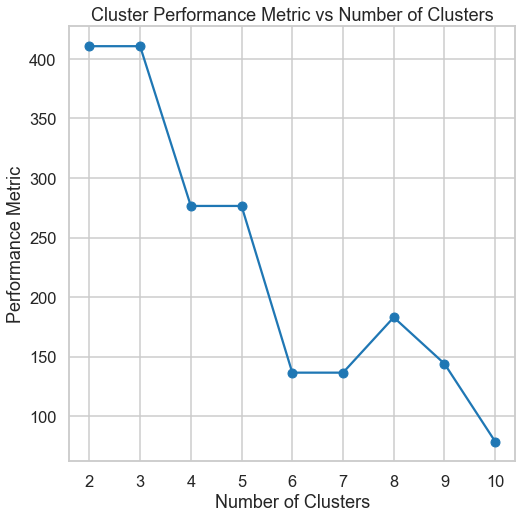

In [131]:
#Example_3_Euclidian
n_samples = 1000
X, y = noisy_moons = make_moons(n_samples=n_samples, noise= .1)

plotting_Examples(X,"euclidean")

Graphs_For_Cluster= 2


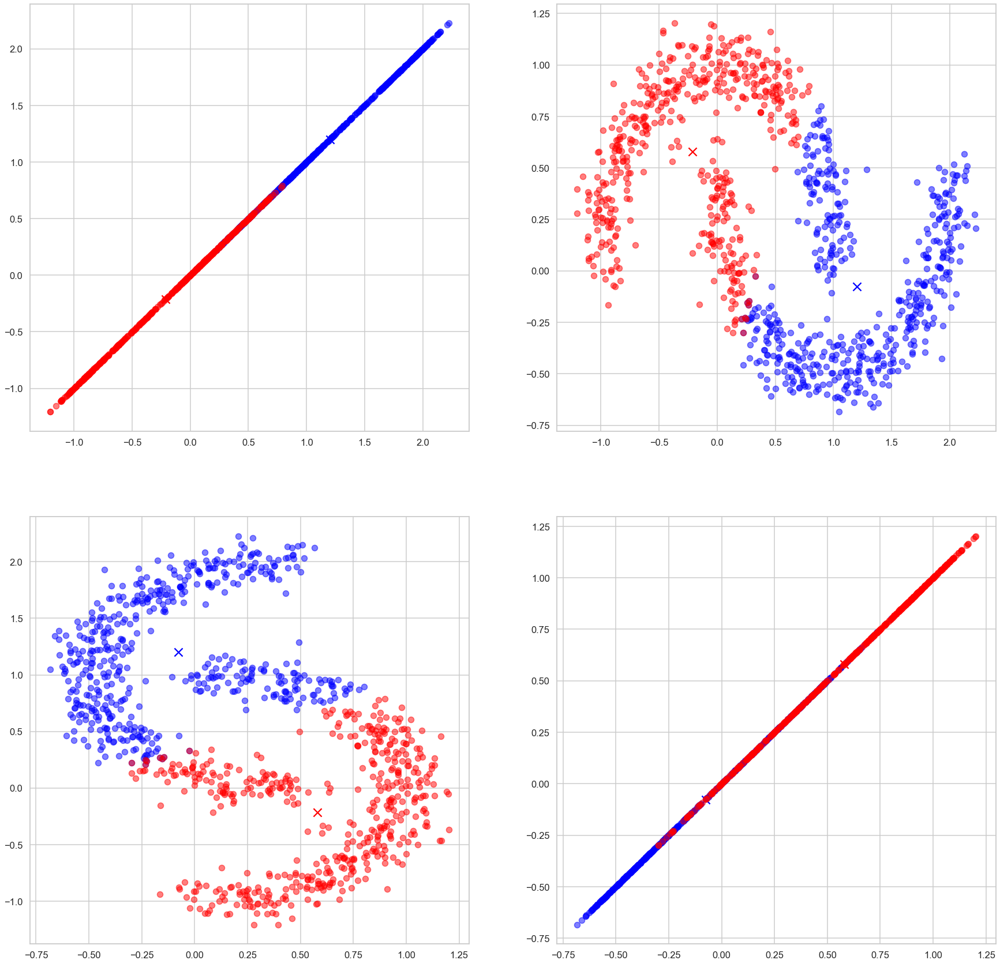

cluster_Performance [411.7792808019857]
Graphs_For_Cluster= 3


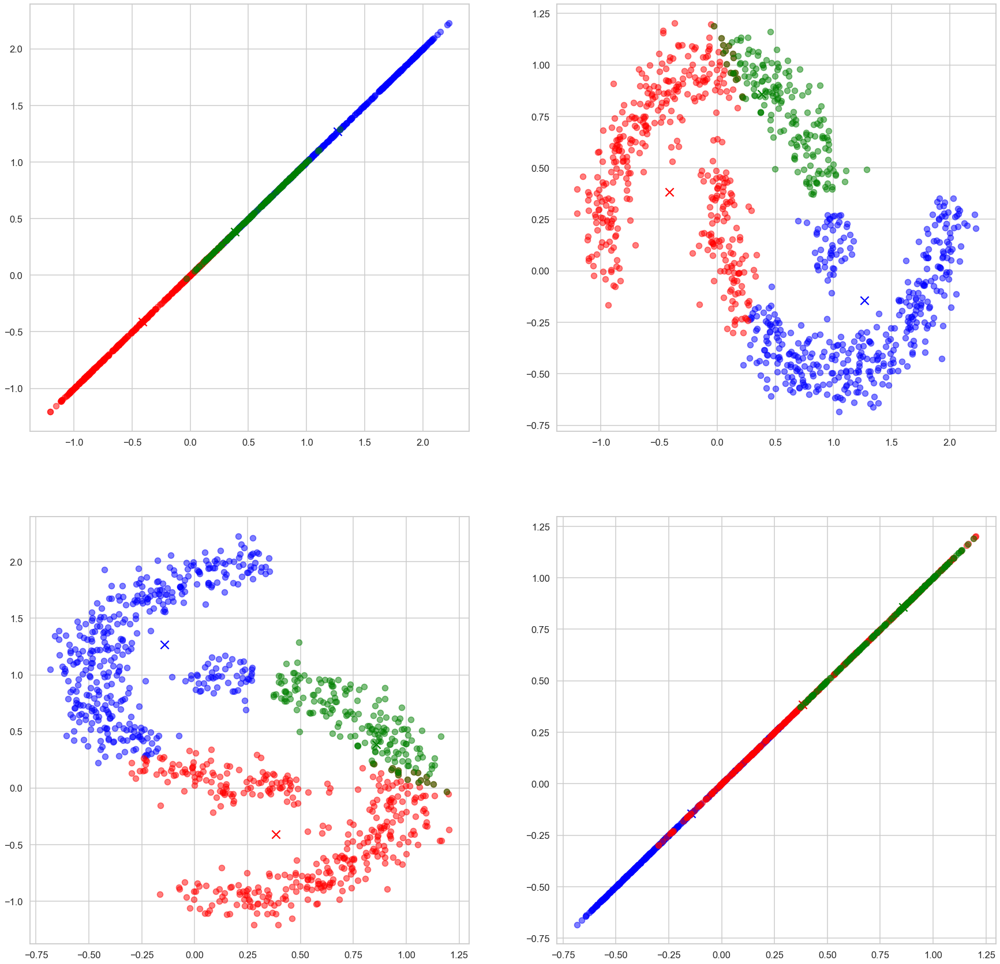

cluster_Performance [411.7792808019857, 314.4033822962208]
Graphs_For_Cluster= 4


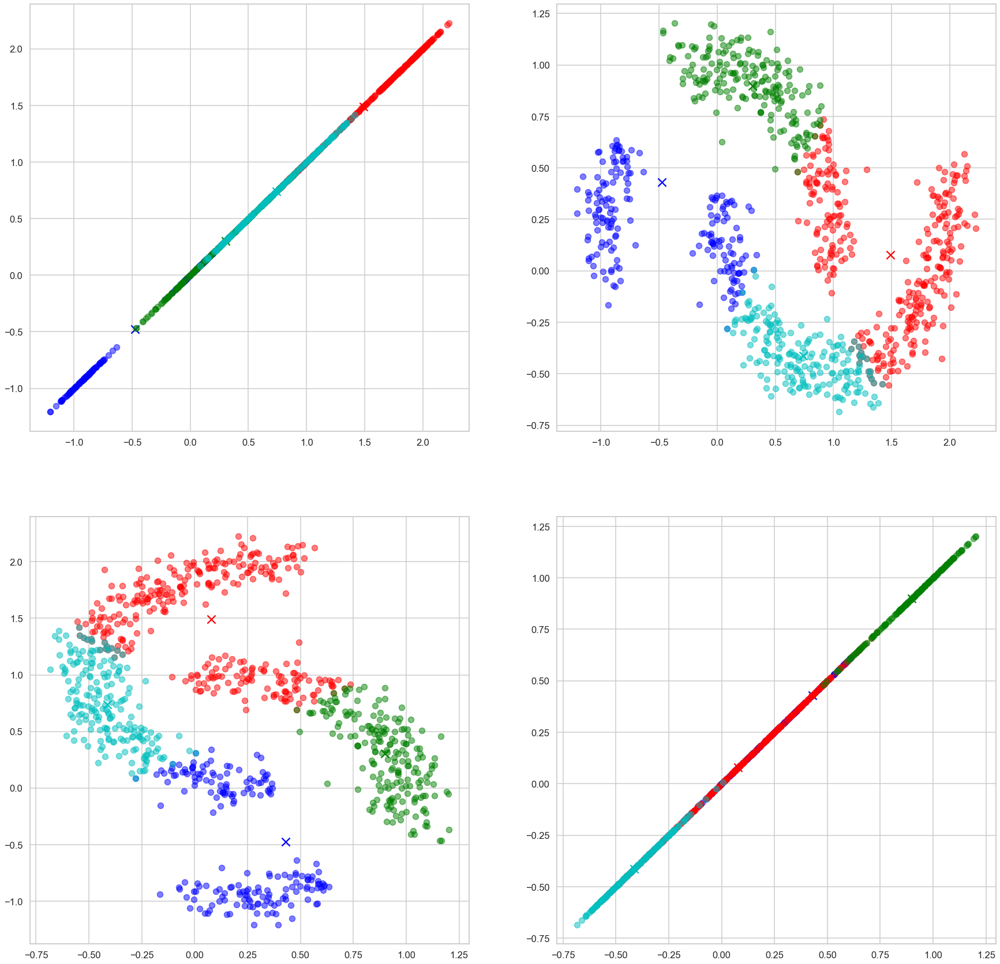

cluster_Performance [411.7792808019857, 314.4033822962208, 225.0630850644845]
Graphs_For_Cluster= 5


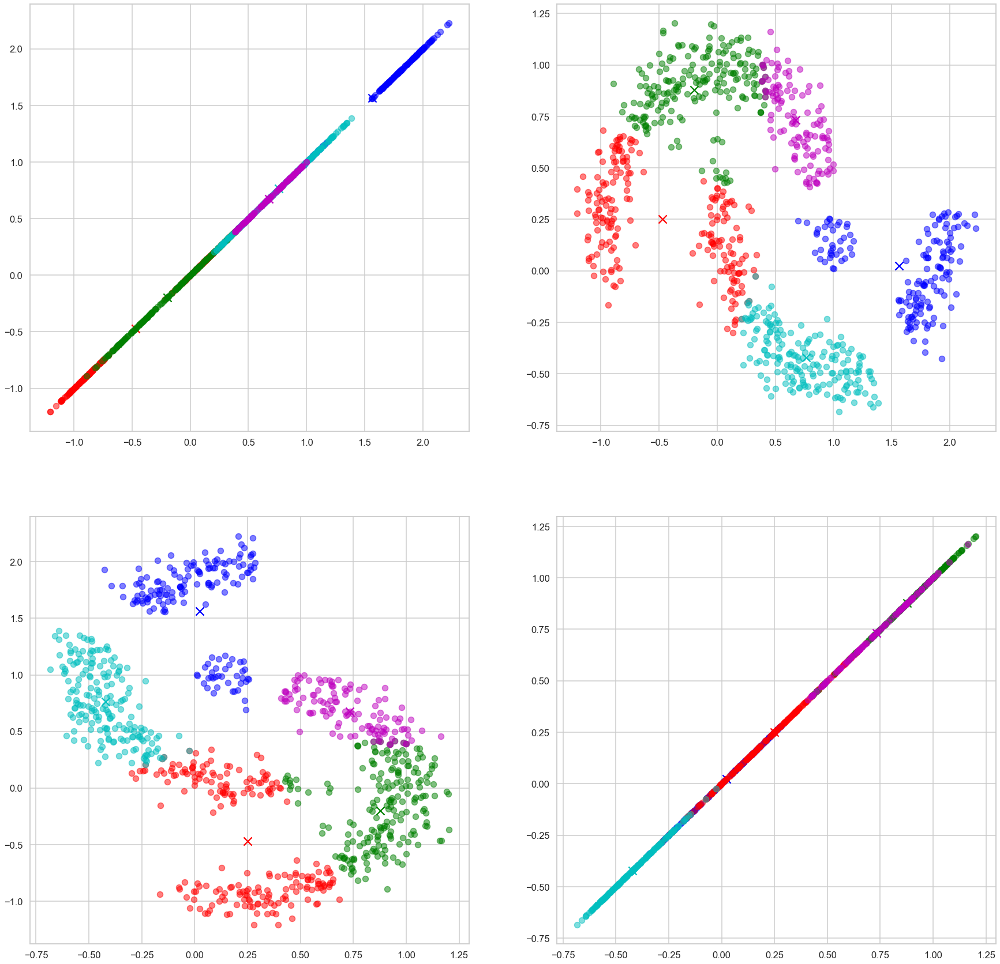

cluster_Performance [411.7792808019857, 314.4033822962208, 225.0630850644845, 190.13039715517056]
Graphs_For_Cluster= 6


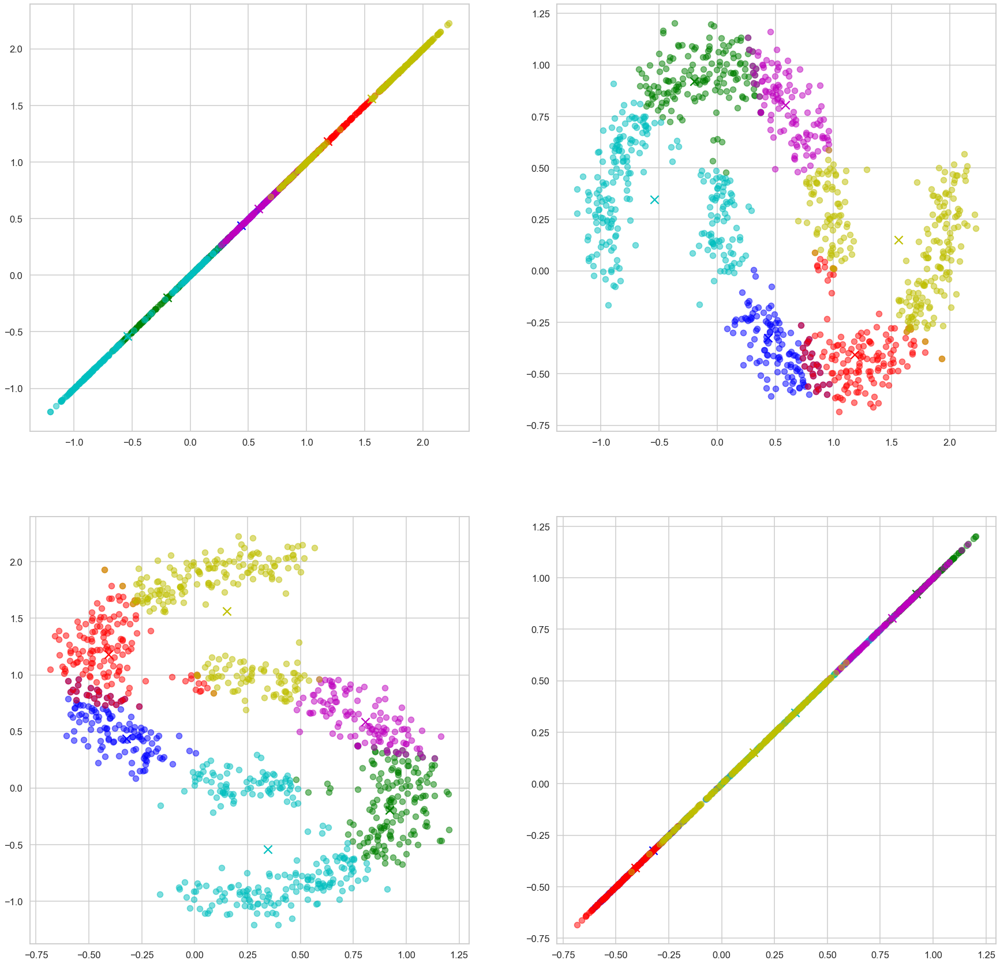

cluster_Performance [411.7792808019857, 314.4033822962208, 225.0630850644845, 190.13039715517056, 161.4722356697888]
Graphs_For_Cluster= 7


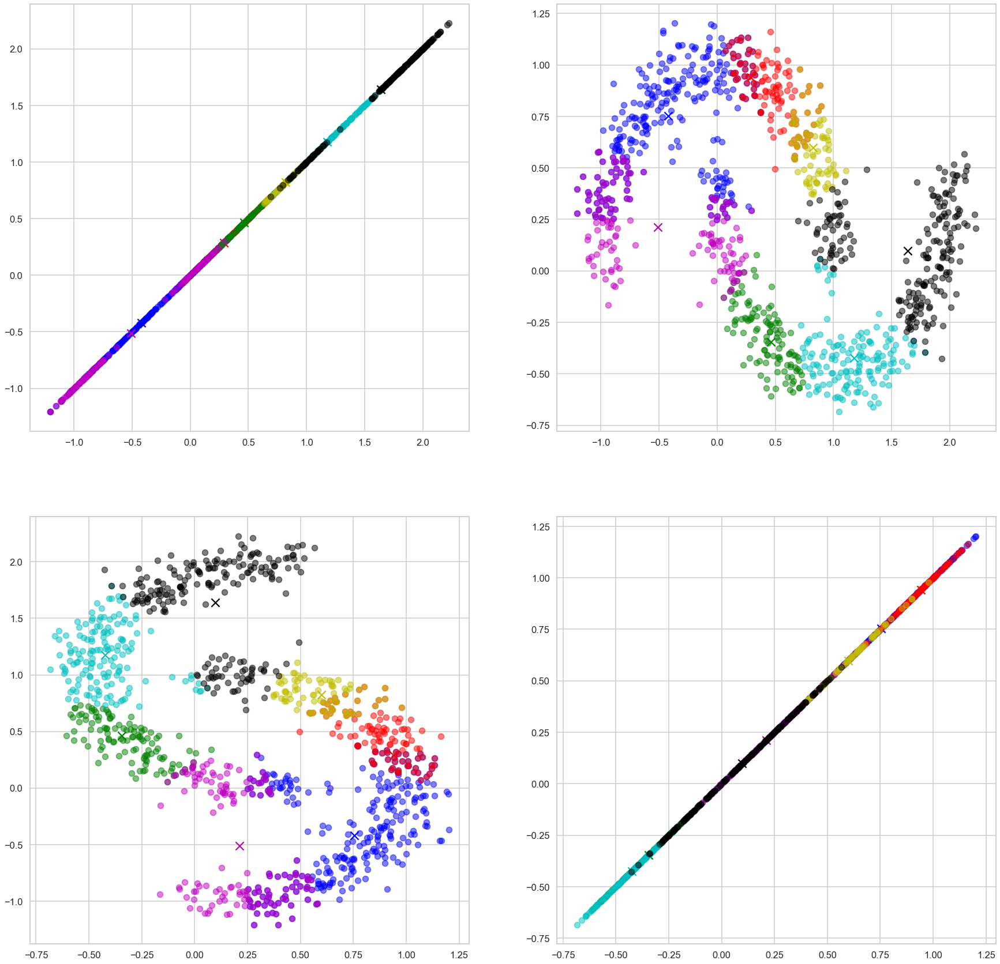

cluster_Performance [411.7792808019857, 314.4033822962208, 225.0630850644845, 190.13039715517056, 161.4722356697888, 140.19992425337634]
Graphs_For_Cluster= 8


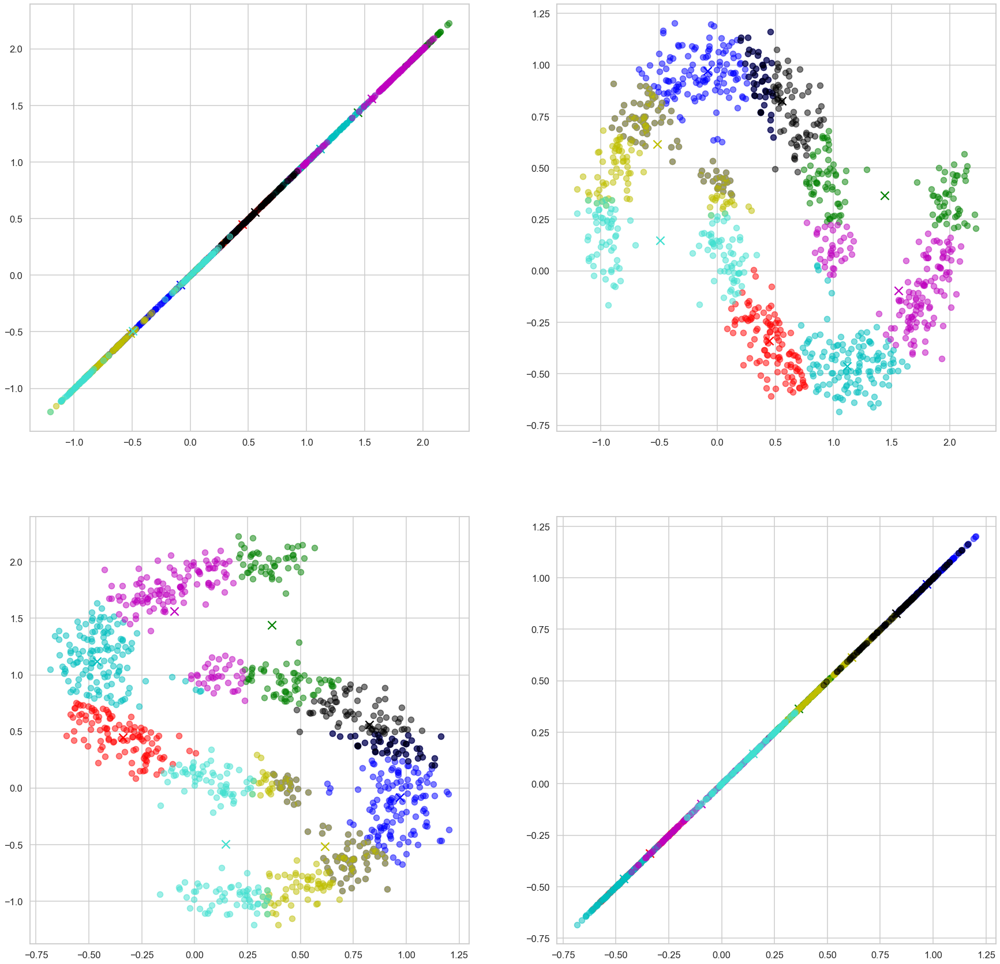

cluster_Performance [411.7792808019857, 314.4033822962208, 225.0630850644845, 190.13039715517056, 161.4722356697888, 140.19992425337634, 146.9800687936373]
Graphs_For_Cluster= 9


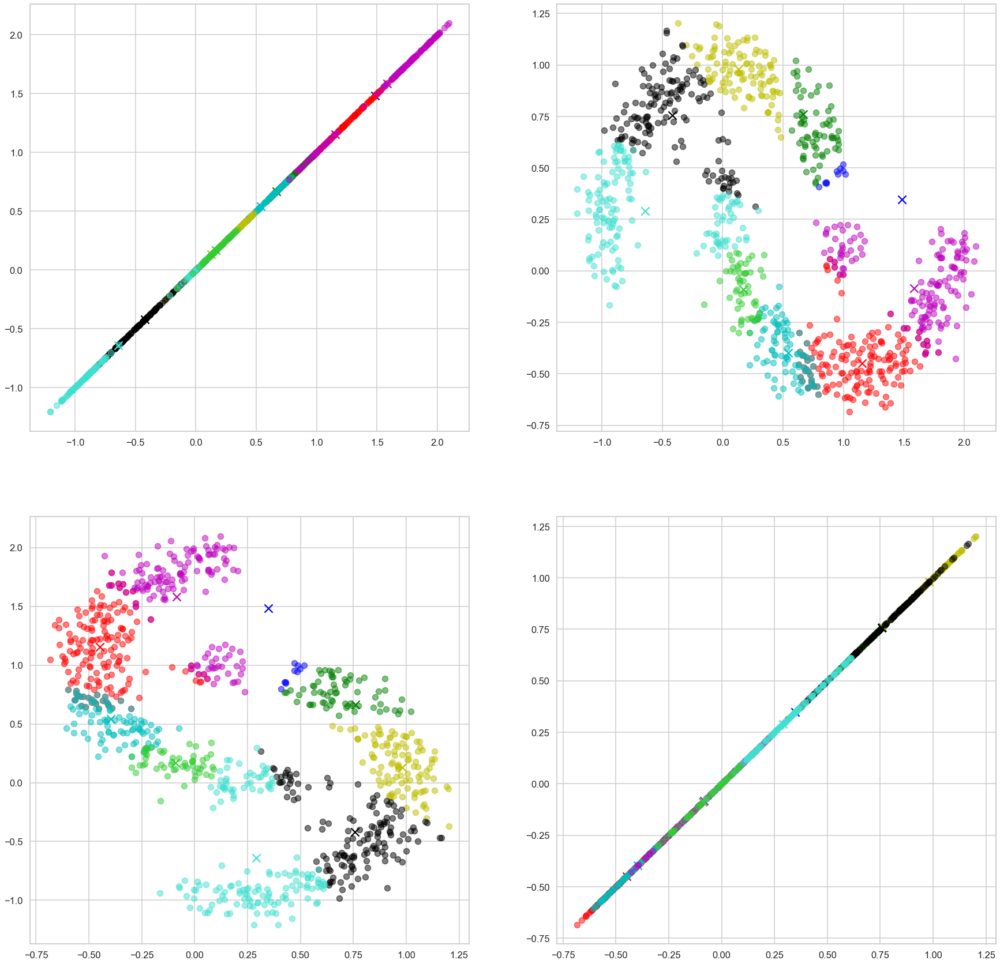

cluster_Performance [411.7792808019857, 314.4033822962208, 225.0630850644845, 190.13039715517056, 161.4722356697888, 140.19992425337634, 146.9800687936373, 126.07316098501974]
Graphs_For_Cluster= 10


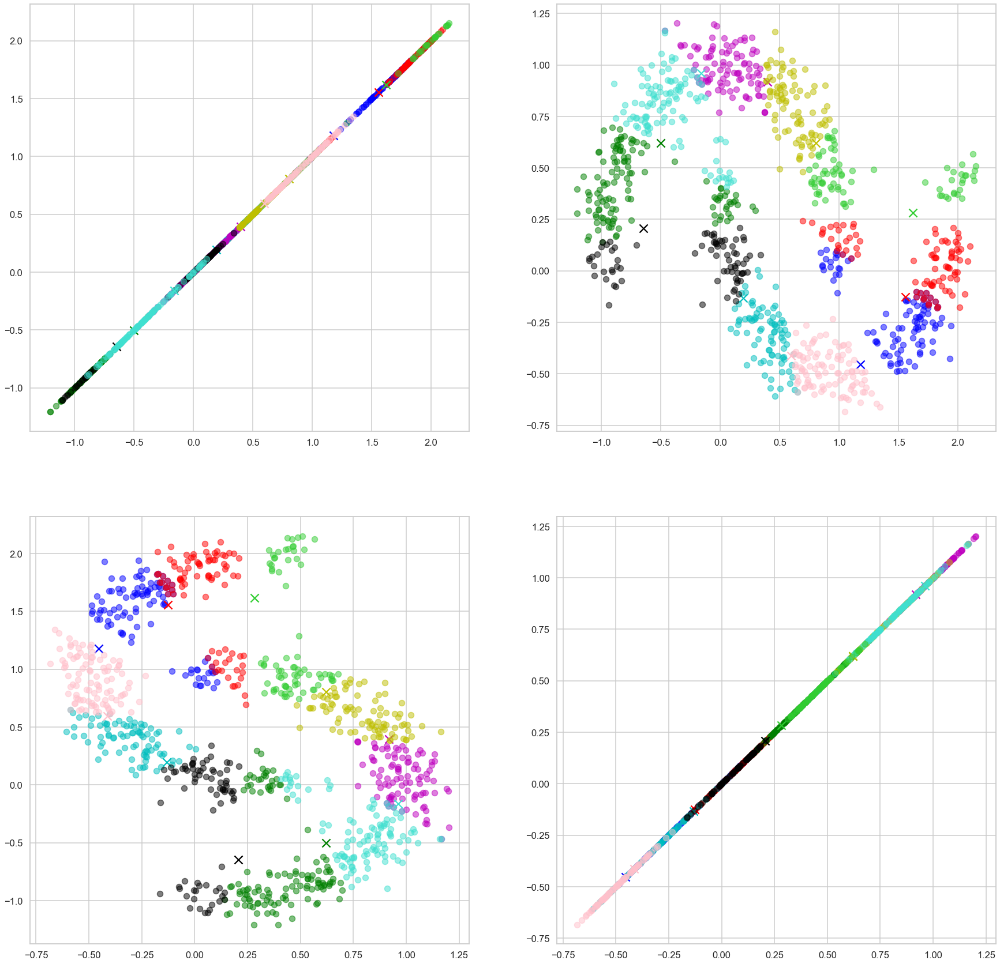

cluster_Performance [411.7792808019857, 314.4033822962208, 225.0630850644845, 190.13039715517056, 161.4722356697888, 140.19992425337634, 146.9800687936373, 126.07316098501974, 113.56595829962282]


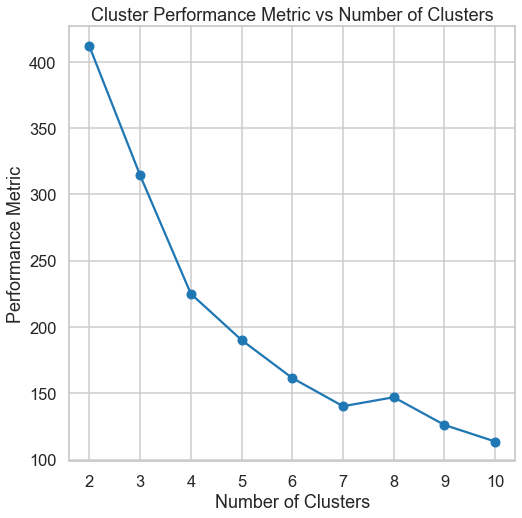

In [132]:
#Example_3_pearson
n_samples = 1000
X, y = noisy_moons = make_moons(n_samples=n_samples, noise= .1)
plotting_Examples(X,"pearson")

## 4. Using the GUC_Kmean function to segment customers int he provided customer dataset
1. Apply the GUC_Kmean fucntion to customer data  
2. Try a varing number of cluster that range from 2 to 10 cluster on each set
3. Display your results.
4. plot the Cluster Metric versus the number of clusters
4. Change the distance function and repeat the above steps

In [133]:
Customer_df=pd.read_csv('F:/Machine_Learning/Customer_data.csv')
Customer_df.set_index('ID', inplace=True)
def plotting_dataset(example_data,distance_type):
    Num_of_clusters=[]
    cluster_Performance_mertic=[]
    for i in range(2,11):
        clusters=i
        print("Graphs_For_Cluster=",i)
        [Final_Cluster_Distance , Cluster_Metric ] = GUC_Kmean(example_data,i,distance_type)
        cluster_Performance_mertic.append(Cluster_Metric)
        Num_of_clusters.append(clusters)
        print("cluster_Performance",cluster_Performance_mertic)
        
    plt.plot(Num_of_clusters,cluster_Performance_mertic, marker='o',linestyle='-')
    plt.xlabel('Number of Clusters')
    plt.ylabel('Performance Metric')
    plt.title('Cluster Performance Metric vs Number of Clusters')
    plt.show()    

Graphs_For_Cluster= 2


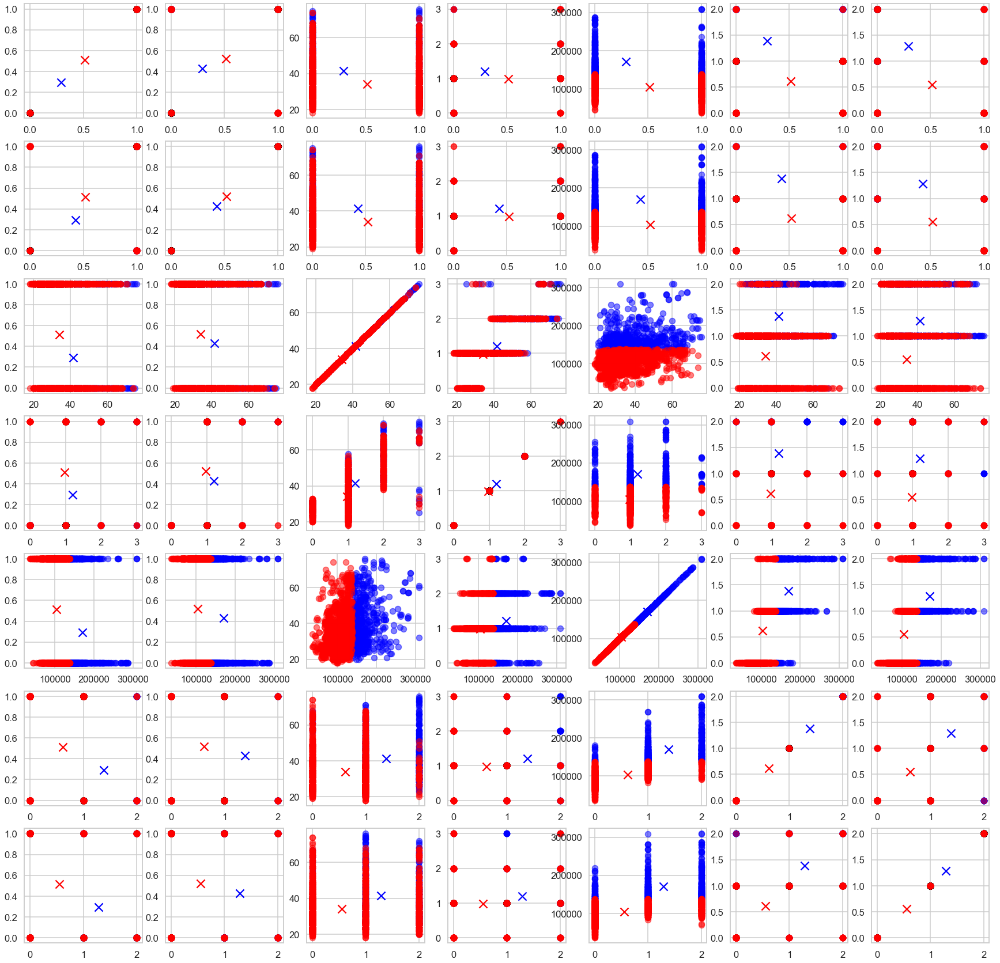

cluster_Performance [1214568333894.6052]
Graphs_For_Cluster= 3


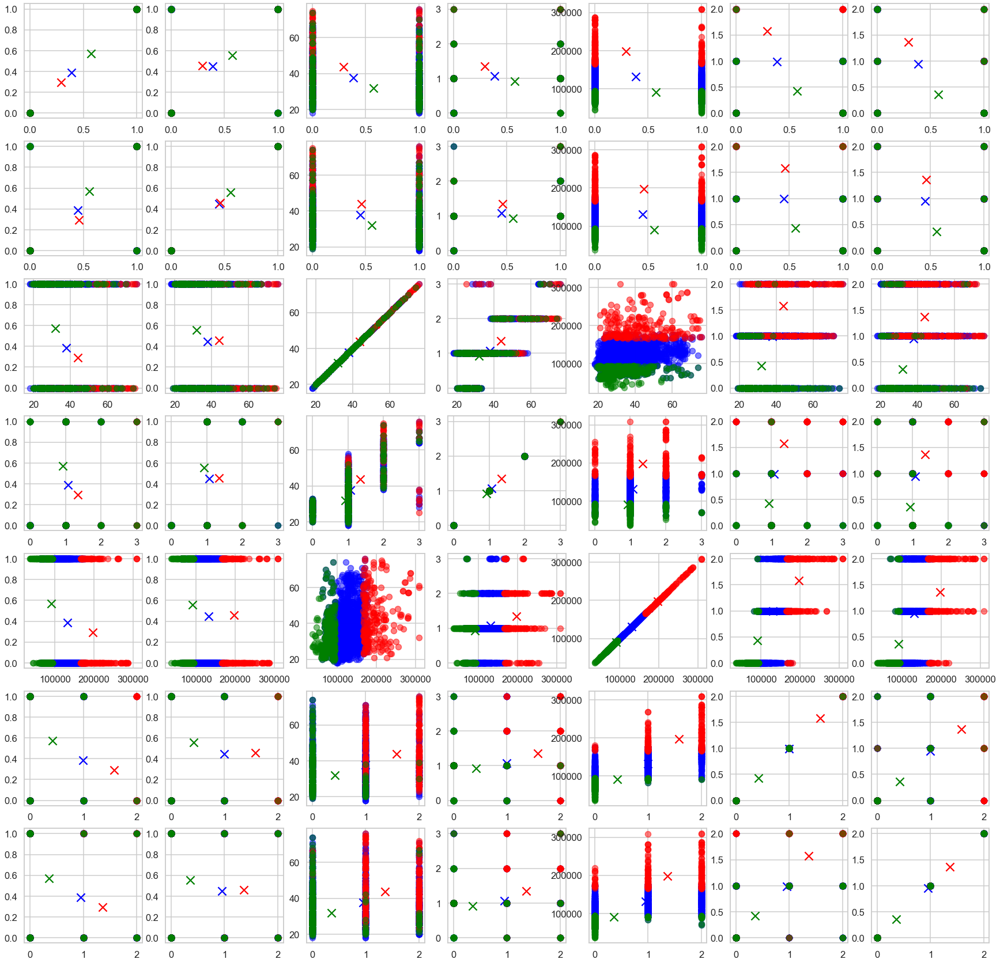

cluster_Performance [1214568333894.6052, 673037871941.4103]
Graphs_For_Cluster= 4


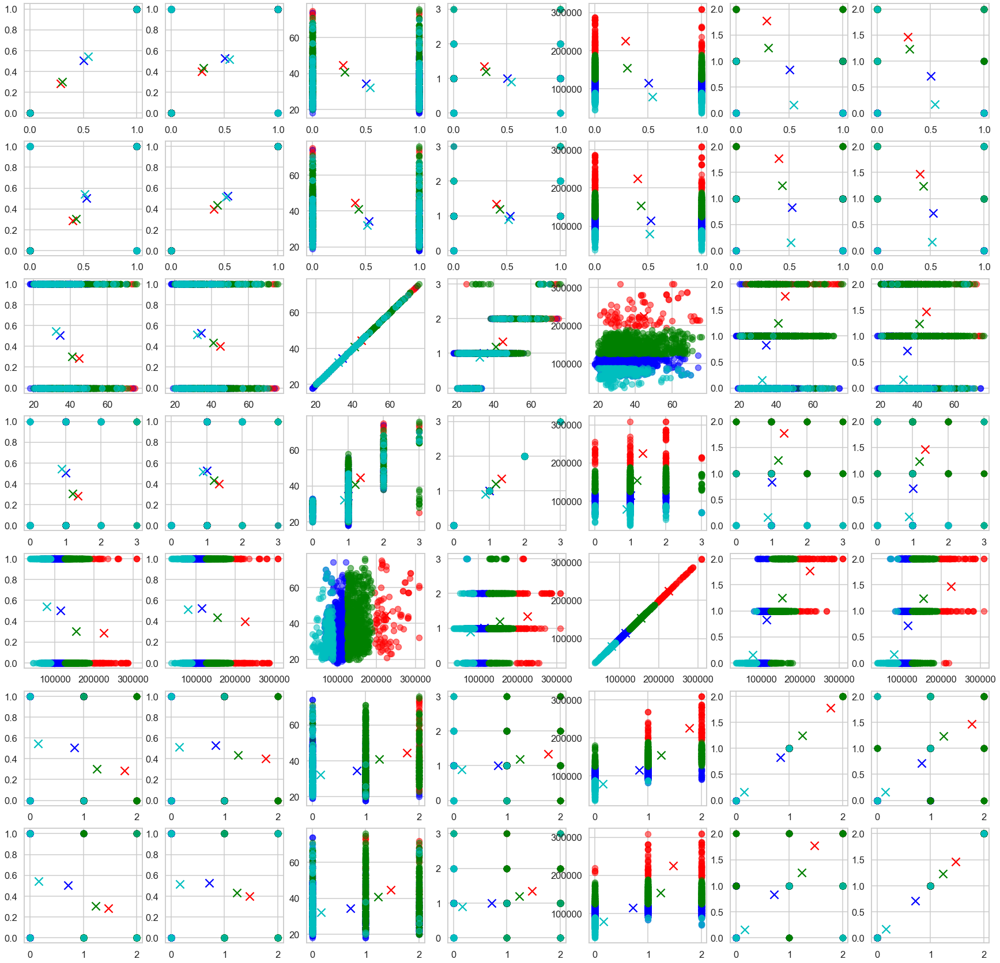

cluster_Performance [1214568333894.6052, 673037871941.4103, 377110110166.39795]
Graphs_For_Cluster= 5


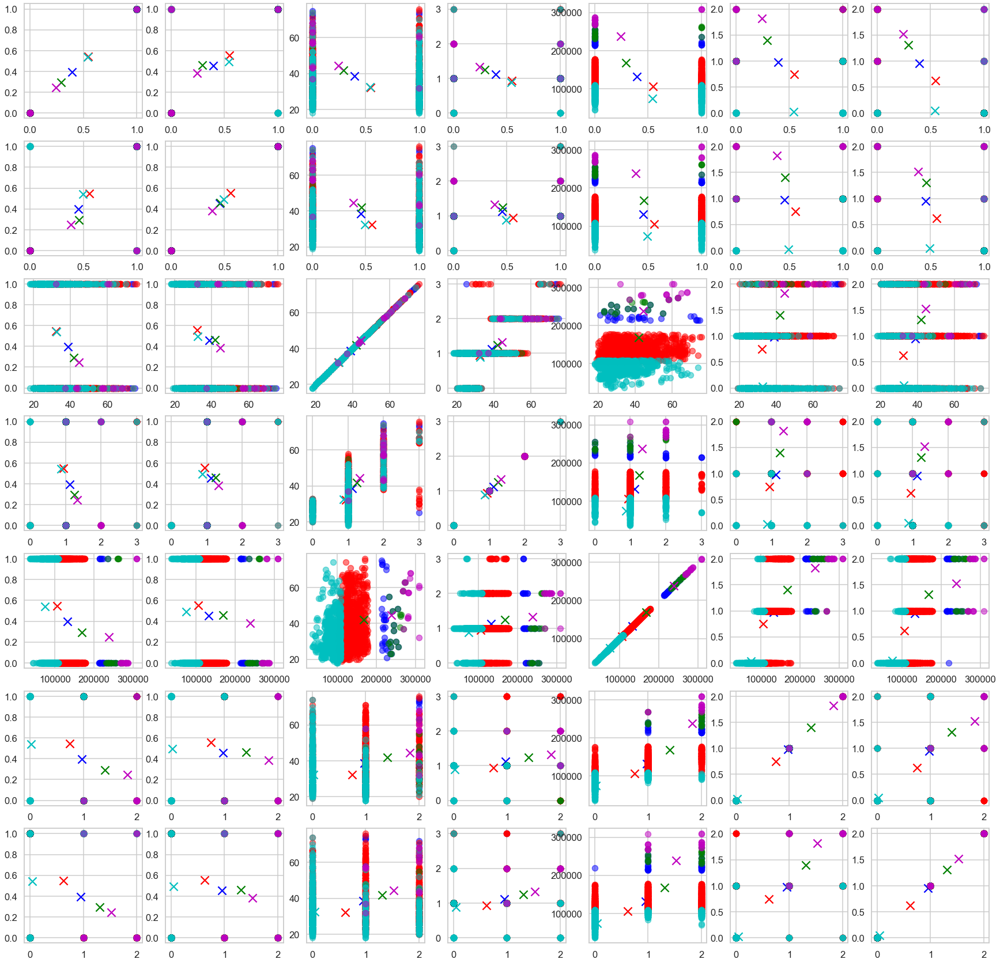

cluster_Performance [1214568333894.6052, 673037871941.4103, 377110110166.39795, 248986409889.95688]
Graphs_For_Cluster= 6


C:\Users\Darin\AppData\Local\Temp/ipykernel_3684/1651446491.py:31: RuntimeWarning: Mean of empty slice
  mean_square_distances[i] = np.nanmean(squared_distances)  # Calculate mean while ignoring NaN values


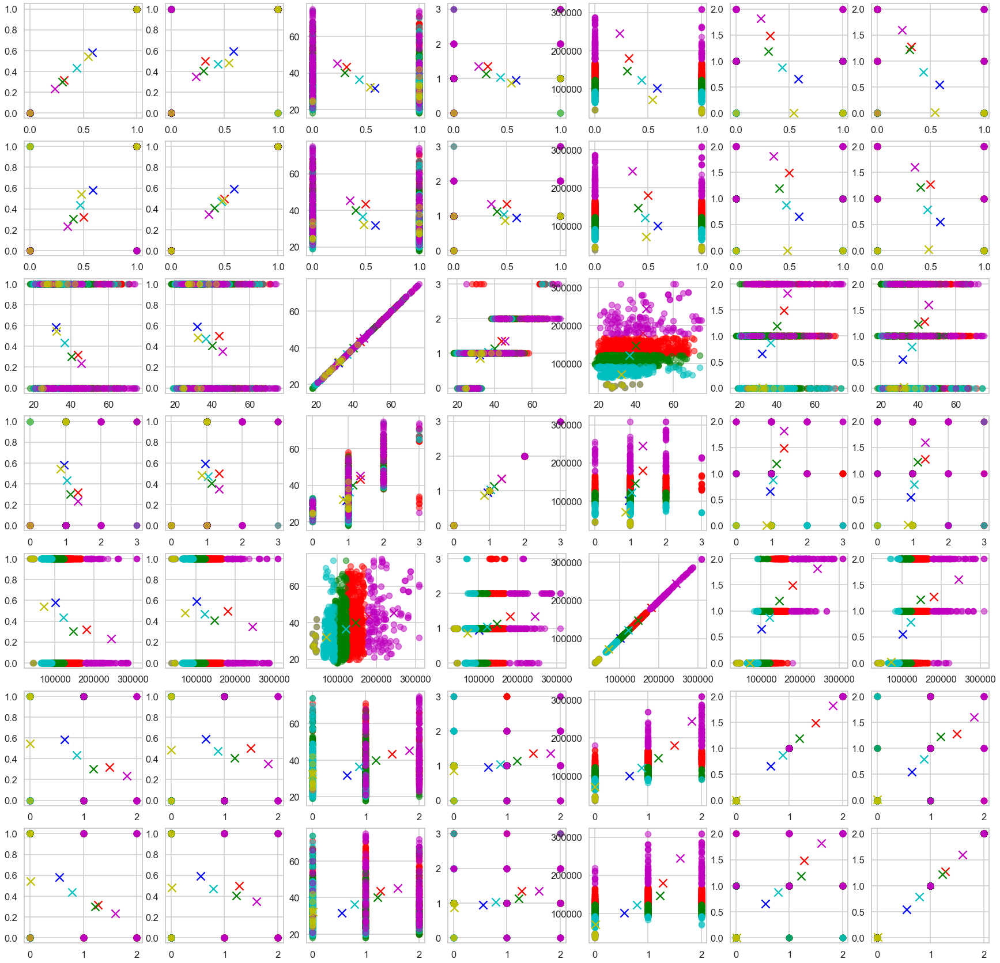

cluster_Performance [1214568333894.6052, 673037871941.4103, 377110110166.39795, 248986409889.95688, 187440491309.844]
Graphs_For_Cluster= 7


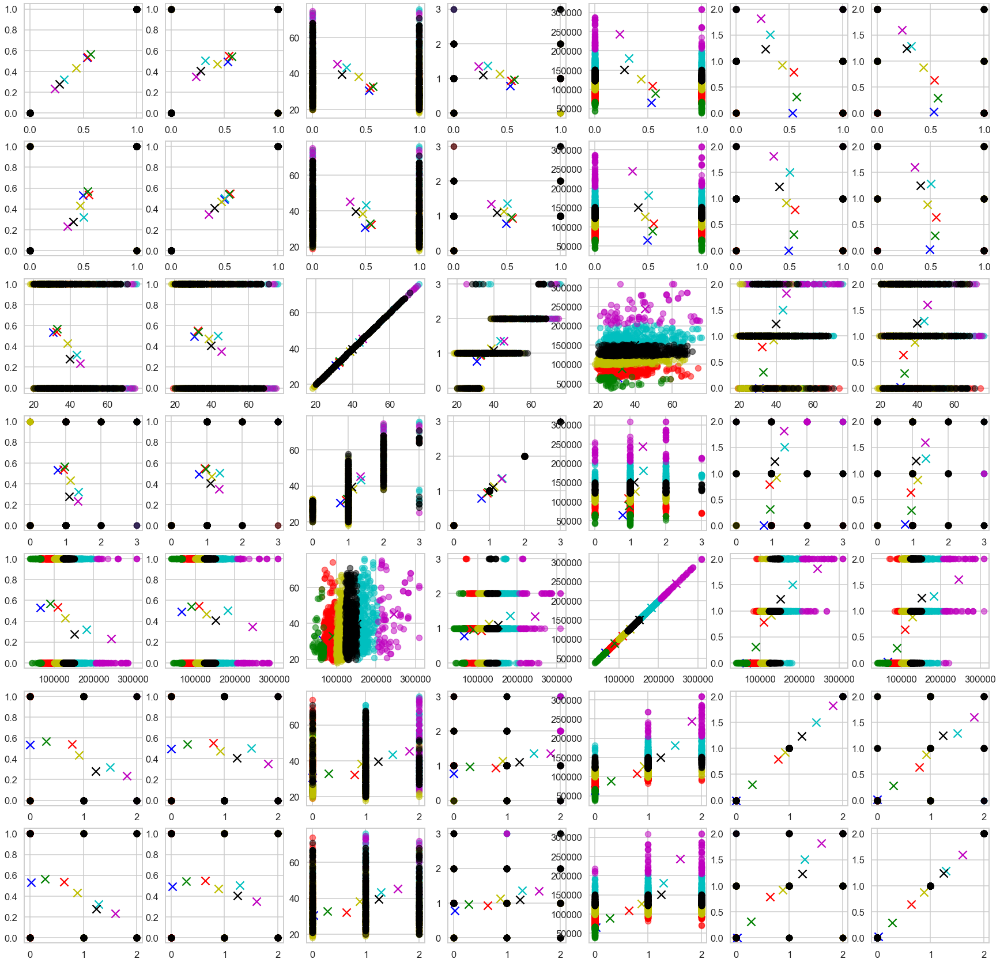

cluster_Performance [1214568333894.6052, 673037871941.4103, 377110110166.39795, 248986409889.95688, 187440491309.844, 146889862239.16605]
Graphs_For_Cluster= 8


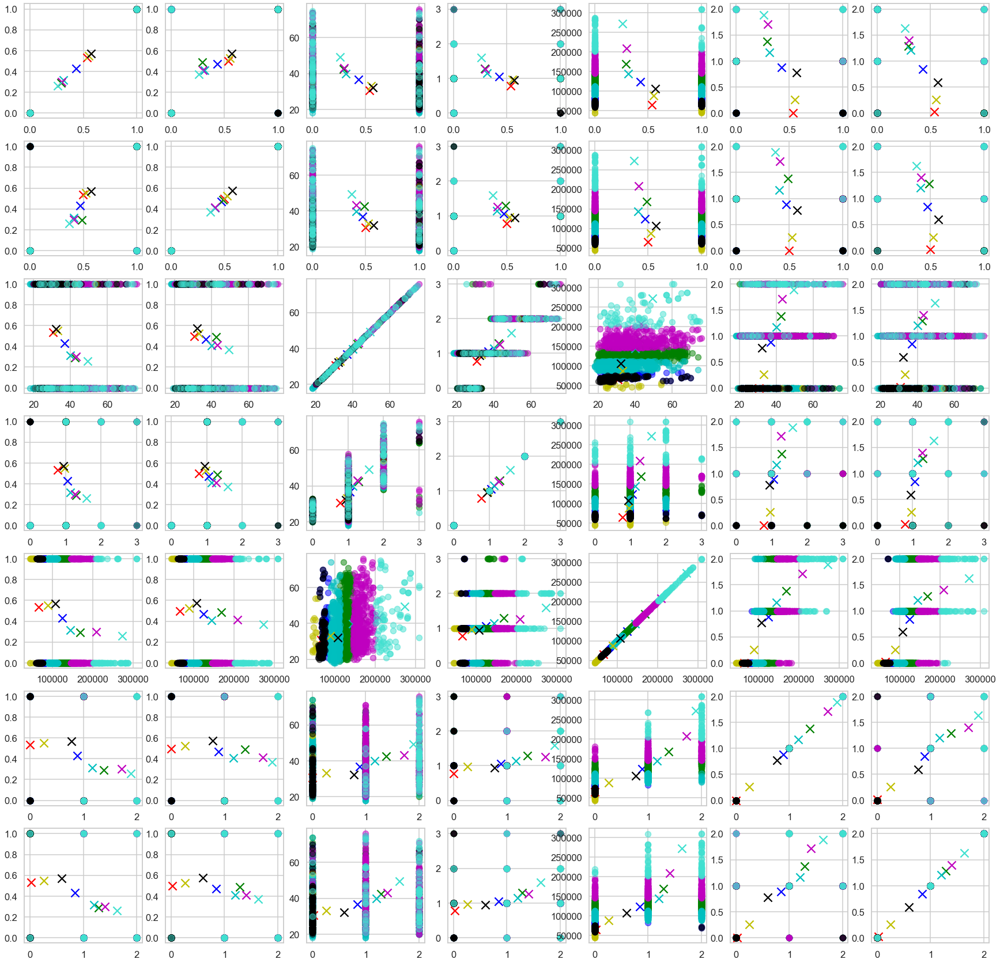

cluster_Performance [1214568333894.6052, 673037871941.4103, 377110110166.39795, 248986409889.95688, 187440491309.844, 146889862239.16605, 96374300727.16837]
Graphs_For_Cluster= 9


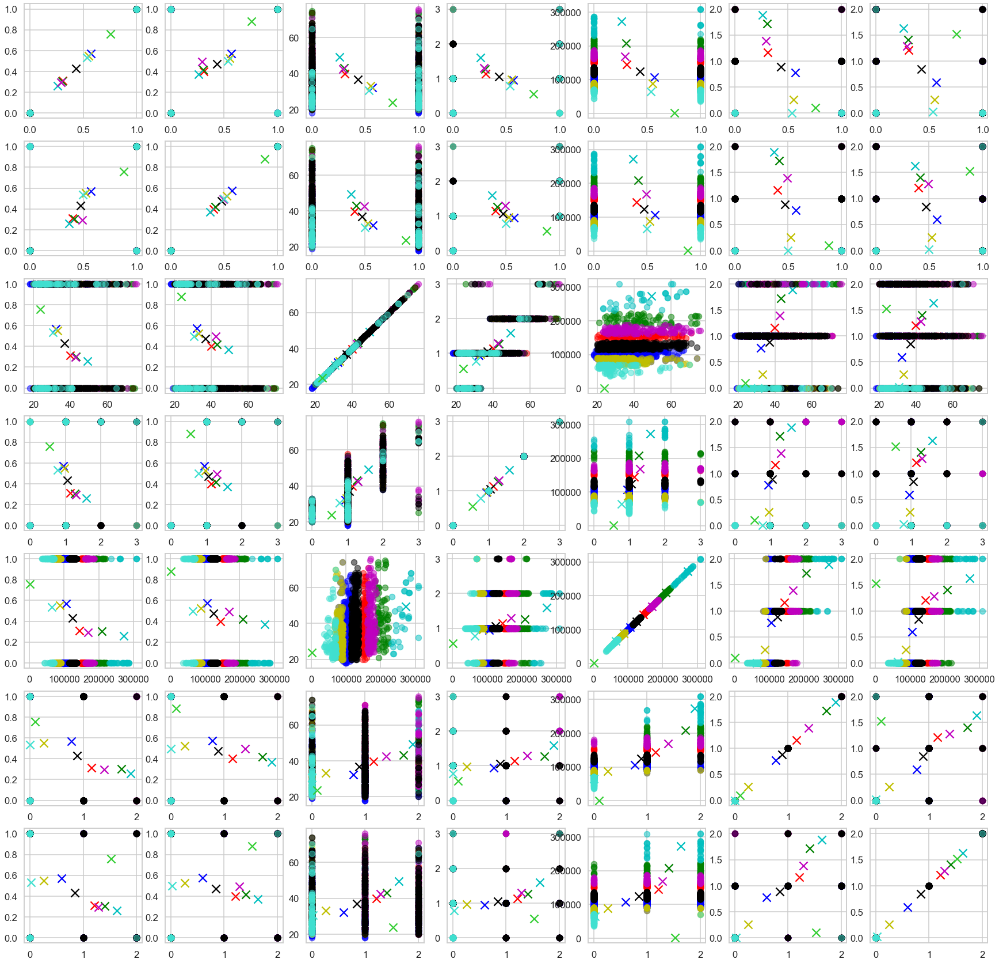

cluster_Performance [1214568333894.6052, 673037871941.4103, 377110110166.39795, 248986409889.95688, 187440491309.844, 146889862239.16605, 96374300727.16837, 96381217488.8797]
Graphs_For_Cluster= 10


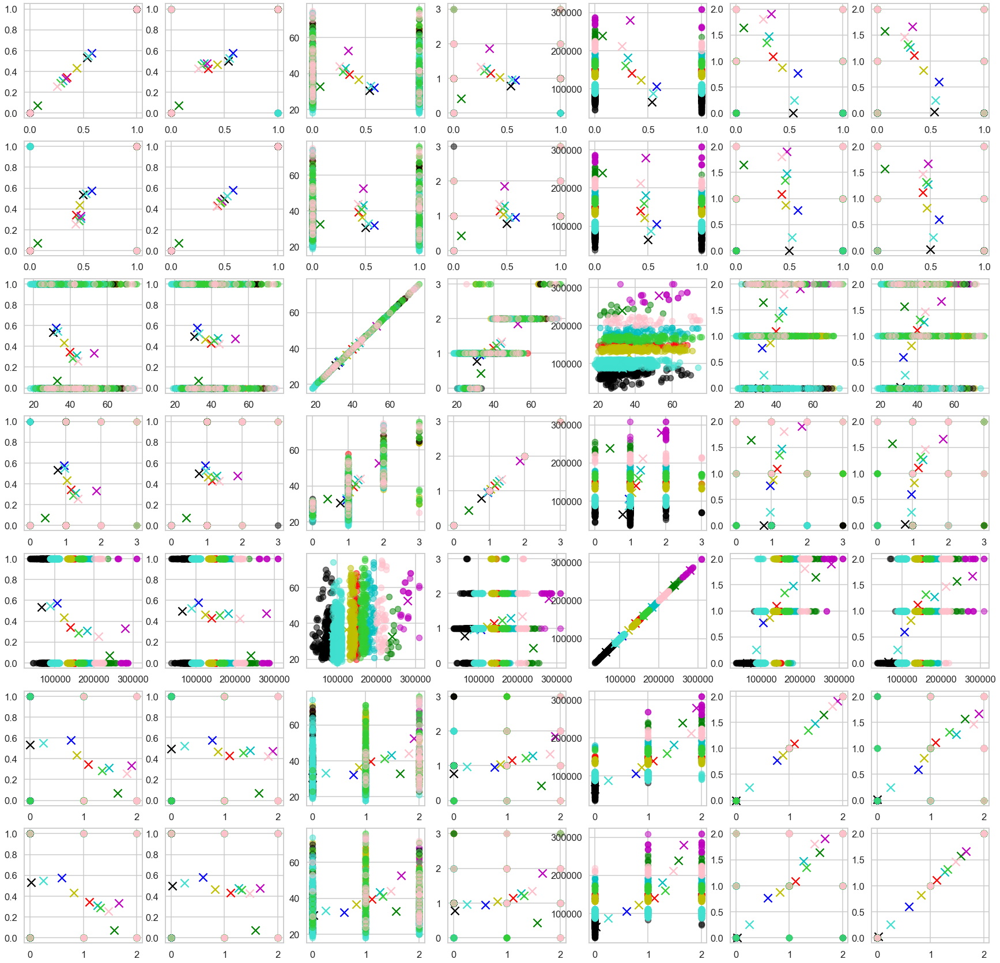

cluster_Performance [1214568333894.6052, 673037871941.4103, 377110110166.39795, 248986409889.95688, 187440491309.844, 146889862239.16605, 96374300727.16837, 96381217488.8797, 73314523881.69089]


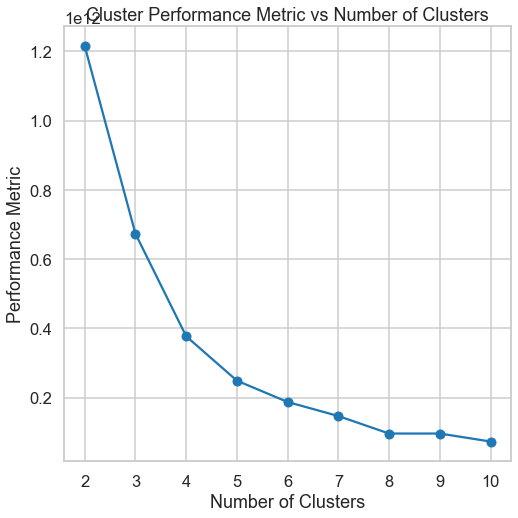

In [134]:
#Plotting_dataset_Euclidean
plotting_dataset(Customer_df,"euclidean")

Graphs_For_Cluster= 2


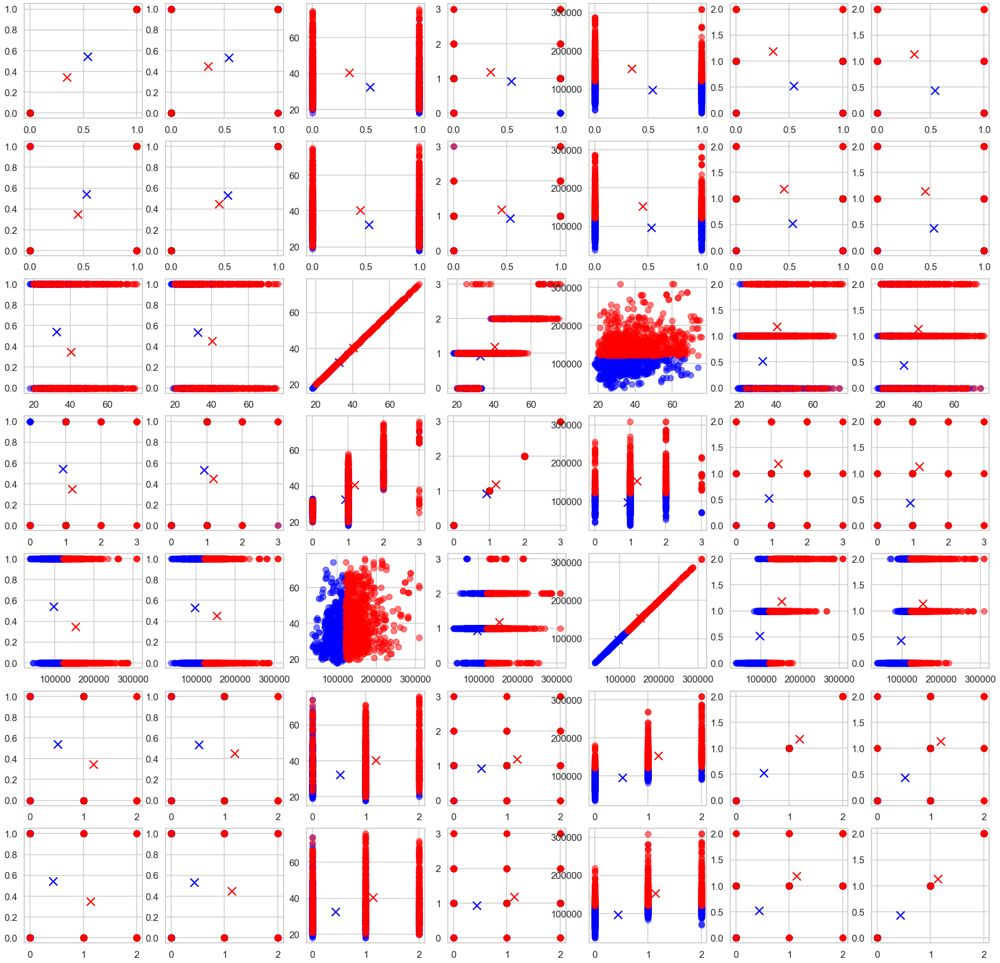

cluster_Performance [1313606871923.6296]
Graphs_For_Cluster= 3


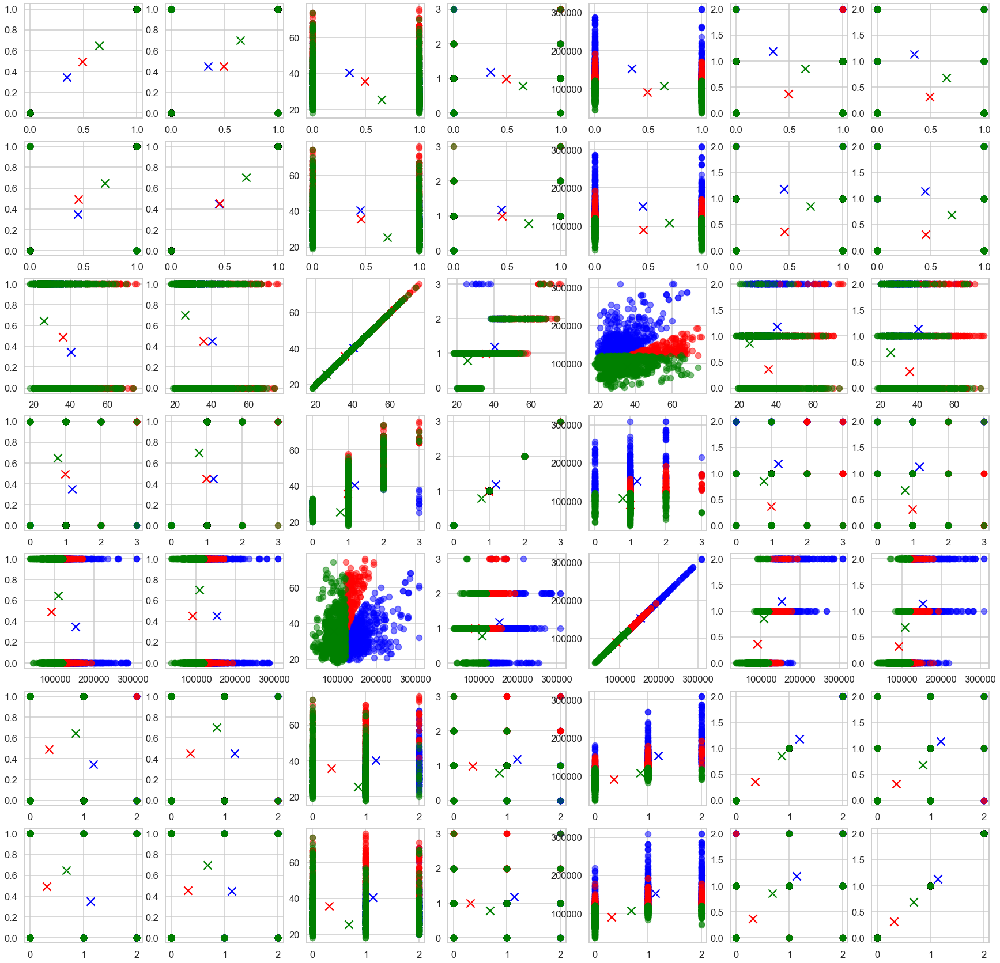

cluster_Performance [1313606871923.6296, 1240201851793.4158]
Graphs_For_Cluster= 4


C:\Users\Darin\AppData\Local\Temp/ipykernel_3684/1651446491.py:31: RuntimeWarning: Mean of empty slice
  mean_square_distances[i] = np.nanmean(squared_distances)  # Calculate mean while ignoring NaN values


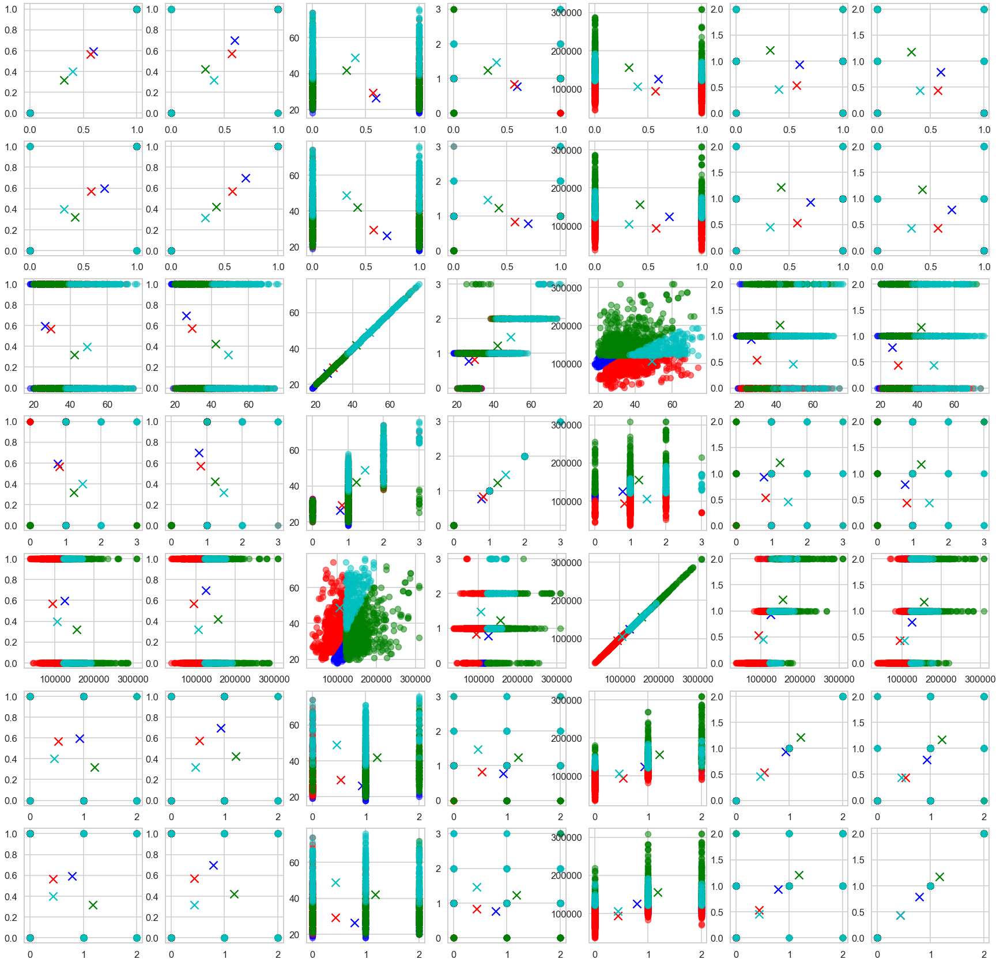

cluster_Performance [1313606871923.6296, 1240201851793.4158, 1216002096859.1194]
Graphs_For_Cluster= 5


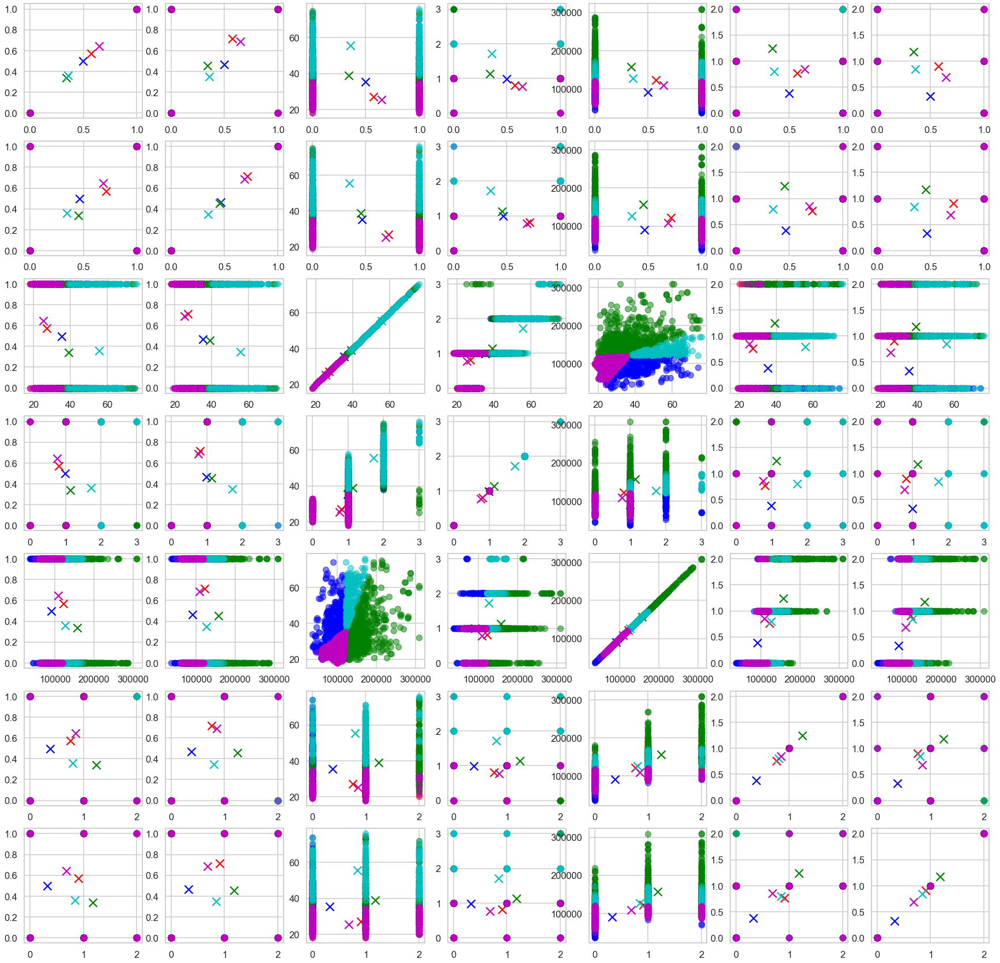

cluster_Performance [1313606871923.6296, 1240201851793.4158, 1216002096859.1194, 1145999674319.5322]
Graphs_For_Cluster= 6


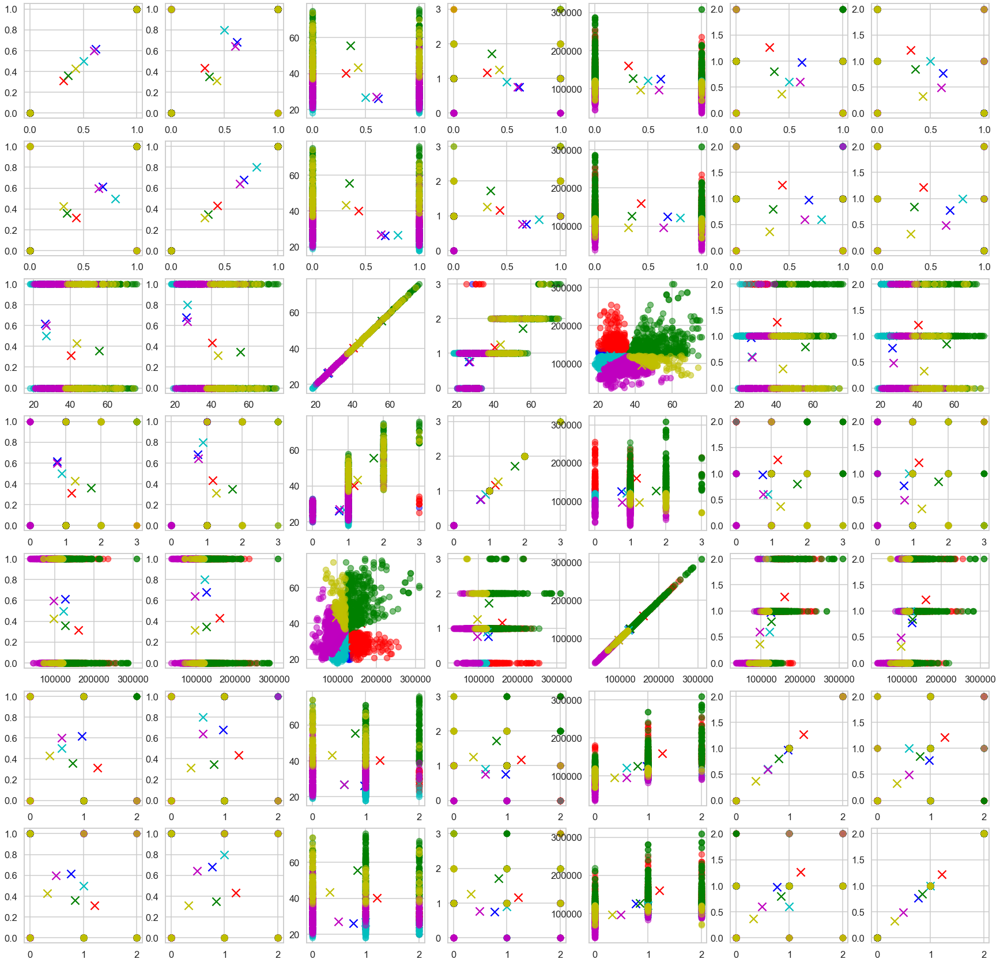

cluster_Performance [1313606871923.6296, 1240201851793.4158, 1216002096859.1194, 1145999674319.5322, 1148889644214.6895]
Graphs_For_Cluster= 7


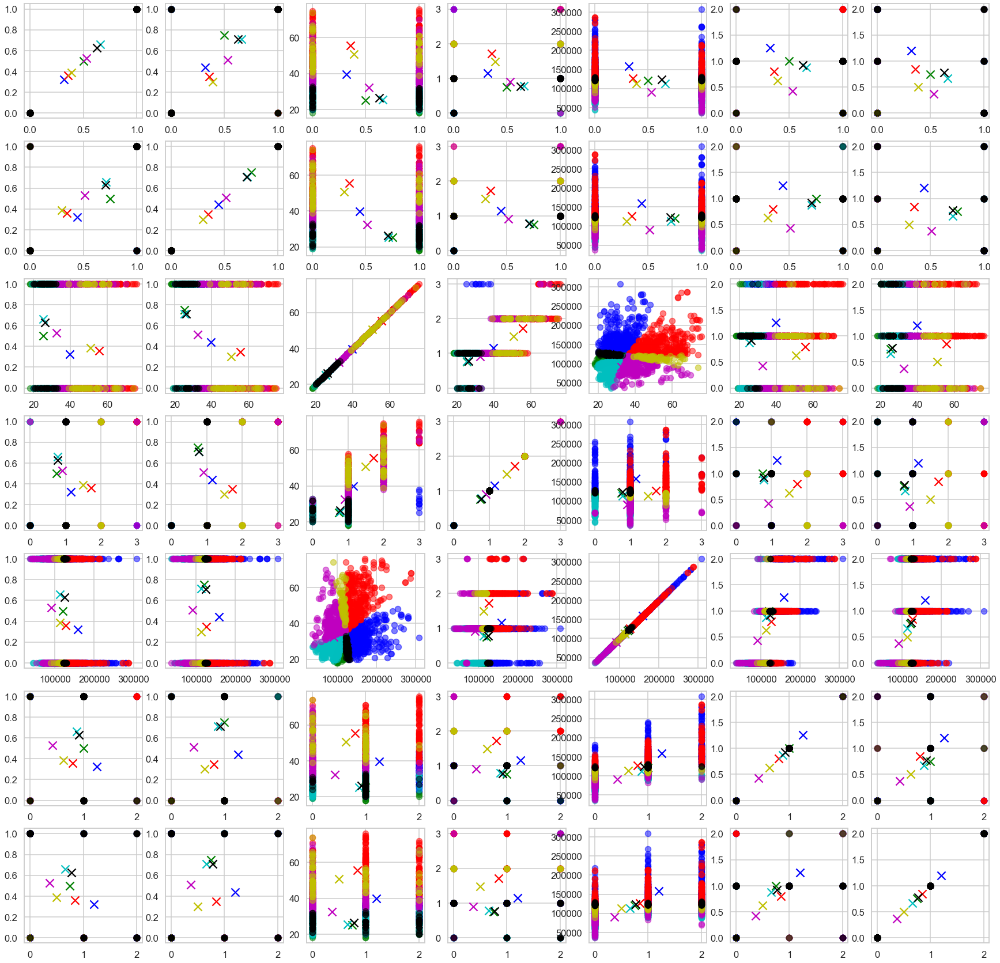

cluster_Performance [1313606871923.6296, 1240201851793.4158, 1216002096859.1194, 1145999674319.5322, 1148889644214.6895, 1070287795163.3668]
Graphs_For_Cluster= 8


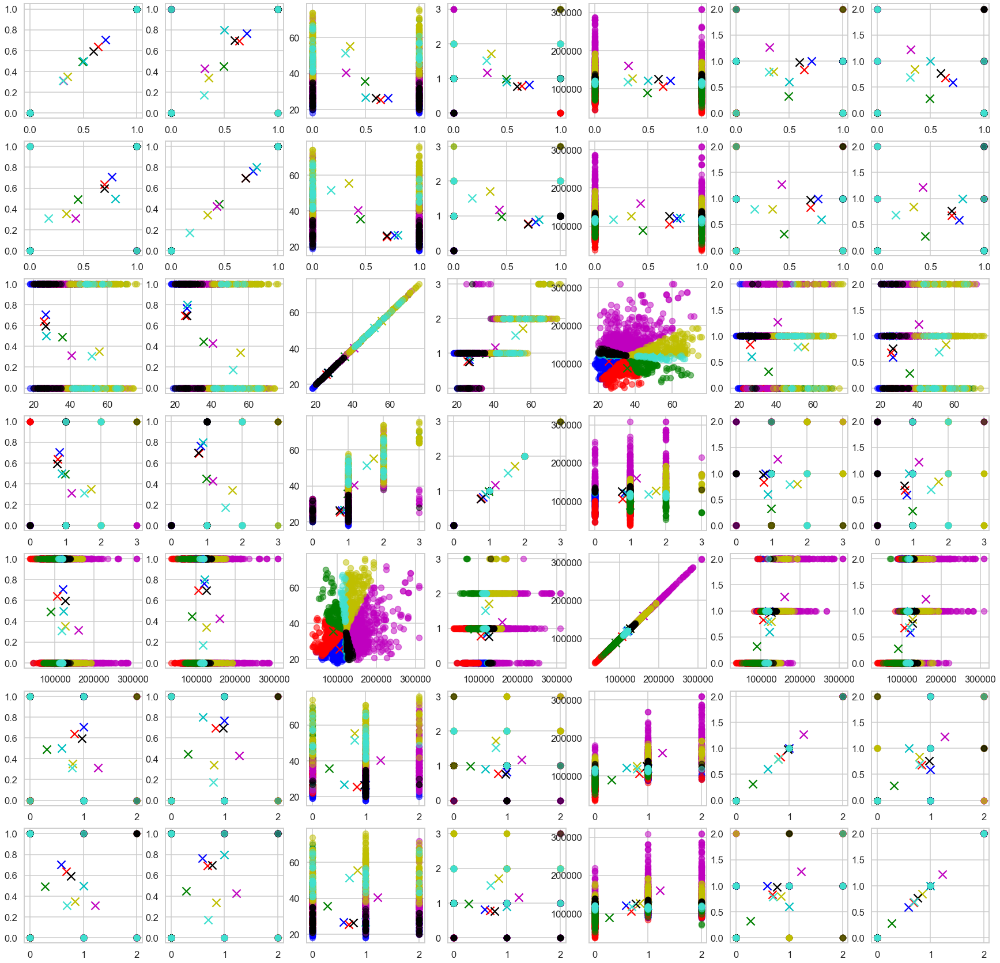

cluster_Performance [1313606871923.6296, 1240201851793.4158, 1216002096859.1194, 1145999674319.5322, 1148889644214.6895, 1070287795163.3668, 1041139912666.5156]
Graphs_For_Cluster= 9


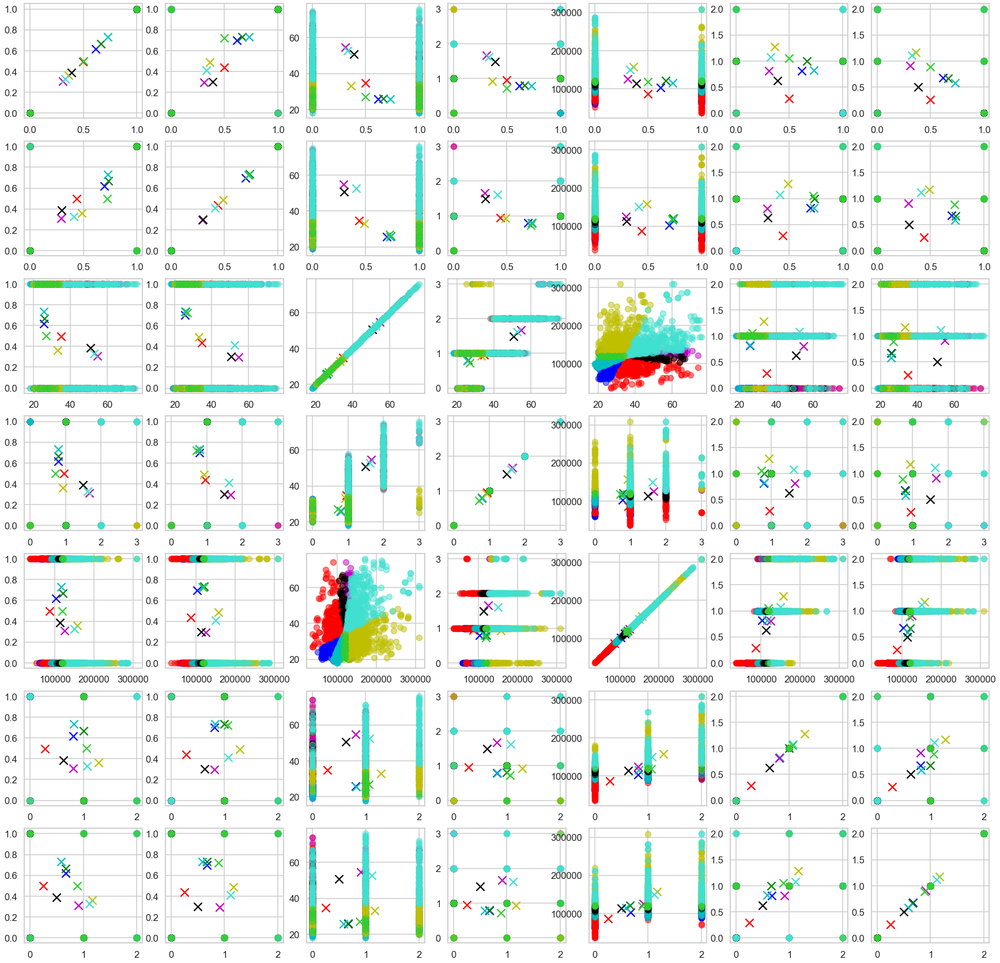

cluster_Performance [1313606871923.6296, 1240201851793.4158, 1216002096859.1194, 1145999674319.5322, 1148889644214.6895, 1070287795163.3668, 1041139912666.5156, 1110141323820.0933]
Graphs_For_Cluster= 10


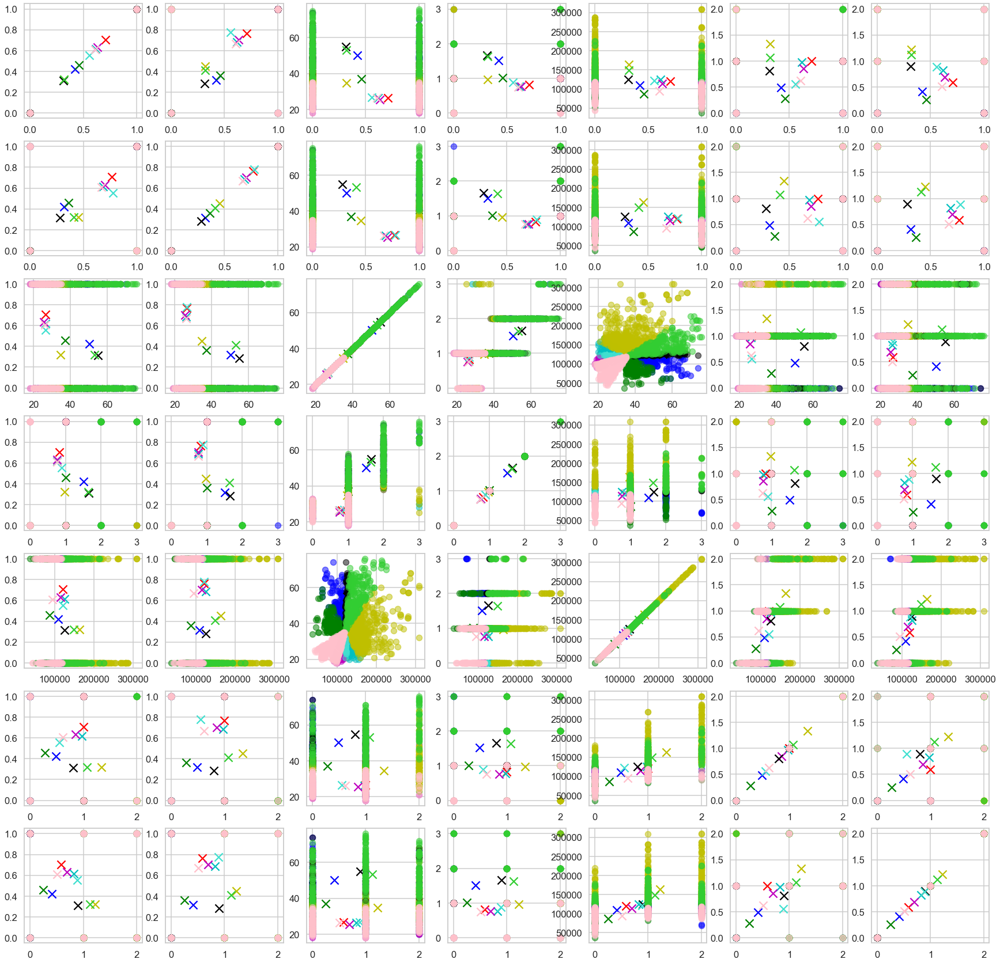

cluster_Performance [1313606871923.6296, 1240201851793.4158, 1216002096859.1194, 1145999674319.5322, 1148889644214.6895, 1070287795163.3668, 1041139912666.5156, 1110141323820.0933, 1034988278676.8567]


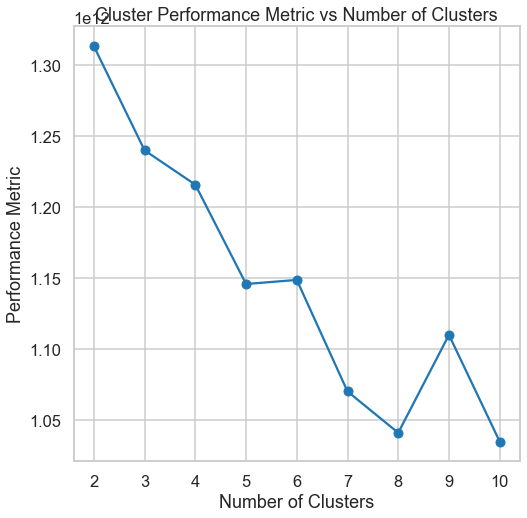

In [135]:
#Plotting_dataset_pearson
plotting_dataset(Customer_df,"pearson")